In [1]:
!nvidia-smi -L

GPU 0: Tesla P100-PCIE-16GB (UUID: GPU-799919be-3cc9-fdea-c9d1-ae39cc807411)


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [0]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [3]:
!git clone https://github.com/akshatjaipuria/Mask-and-Depth-Prediction.git

Cloning into 'Mask-and-Depth-Prediction'...
remote: Enumerating objects: 37, done.
remote: Counting objects: 100% (37/37), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 436 (delta 13), reused 20 (delta 5), pack-reused 399
Receiving objects: 100% (436/436), 5.79 MiB | 9.36 MiB/s, done.
Resolving deltas: 100% (210/210), done.


In [0]:
# !rm -r /content/Mask-and-Depth-Prediction/data

In [0]:
!unzip -q '/content/drive/My Drive/data.zip' -d '/content/Mask-and-Depth-Prediction'

In [0]:
!unzip -q '/content/drive/My Drive/dataset.zip' -d '/content/Mask-and-Depth-Prediction'
# after unzipping, move the bg folder to data folder

In [0]:
!unzip -q '/content/drive/My Drive/fg_bg_depth.zip' -d '/content/Mask-and-Depth-Prediction/data'

In [0]:
!pip install albumentations==0.4.5
!pip install -U segmentation-models-pytorch
# !pip install tensorboardcolab
!pip install kornia

In [10]:
%cd '/content/Mask-and-Depth-Prediction/'

/content/Mask-and-Depth-Prediction


In [0]:
from model.data_loader import getdata
from model.network_architecture import Net
from utils import show_image, model_summary
# from train_mask import train_model

In [0]:
import torch
import torch.nn as nn
import time
from kornia.losses import SSIM

## Initial Setup

In [26]:
train_loader, valid_loader = getdata(batch_size=64, num_workers=4)

CUDA Available? True


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


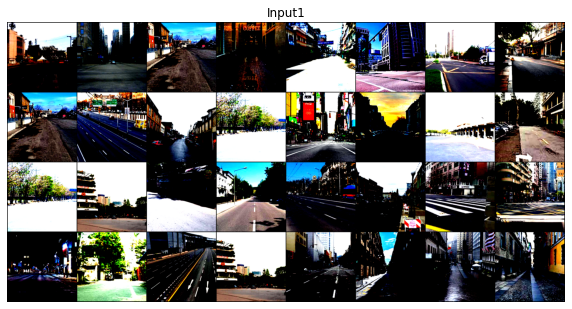

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


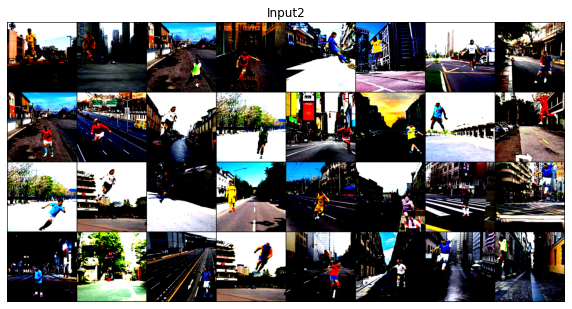

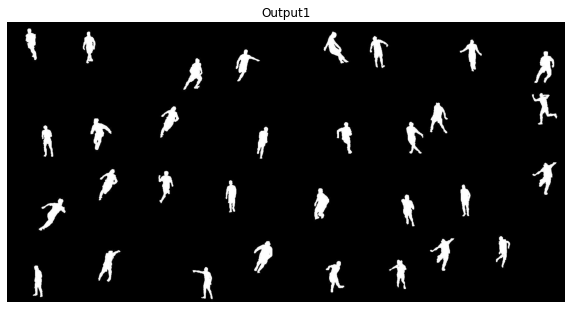

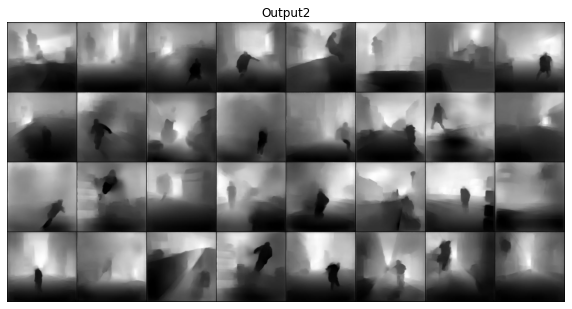

In [5]:
inputs = next(iter(train_loader))
show_image(inputs['i1'][::4], 8, 'Input1')
show_image(inputs['i2'][::4], 8, 'Input2')
show_image(inputs['o1'][::4], 8, 'Output1')
show_image(inputs['o2'][::4], 8, 'Output2')

In [14]:
model = Net(6, 1)
print(model)

Net(
  (inc): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(6, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (down1): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(128, eps=1e-05, momentu

In [0]:
ct = 0
for child in model.children():
  ct += 1
  if ct > 8 or ct < 5:
    for param in child.parameters():
        param.requires_grad = False

In [0]:
torch.cuda.empty_cache()

In [16]:
device = model_summary(model, [(3, 224, 224), (3, 224, 224)])

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           3,520
       BatchNorm2d-2         [-1, 64, 224, 224]             128
              ReLU-3         [-1, 64, 224, 224]               0
            Conv2d-4         [-1, 64, 224, 224]          36,928
       BatchNorm2d-5         [-1, 64, 224, 224]             128
              ReLU-6         [-1, 64, 224, 224]               0
        DoubleConv-7         [-1, 64, 224, 224]               0
         MaxPool2d-8         [-1, 64, 112, 112]               0
            Conv2d-9        [-1, 128, 112, 112]          73,856
      BatchNorm2d-10        [-1, 128, 112, 112]             256
             ReLU-11        [-1, 128, 112, 112]               0
           Conv2d-12        [-1, 128, 112, 112]         147,584
      BatchNorm2d-13        [-1, 128, 112, 112]             256
             ReLU-14        [-1, 128, 1

In [0]:
# from tensorboardcolab import TensorBoardColab
# tb = TensorBoardColab()
trainer = train_model(device)

##Segmentation

In [0]:
import segmentation_models_pytorch as smp
metric = smp.utils.metrics.IoU(threshold=0.5)

In [0]:
# criterion = SoftDiceLoss()
criterion = nn.BCEWithLogitsLoss()

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.609051	Metric: 0.201919
Batch ID:  0


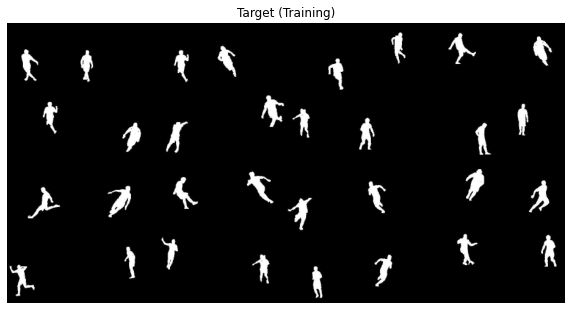

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


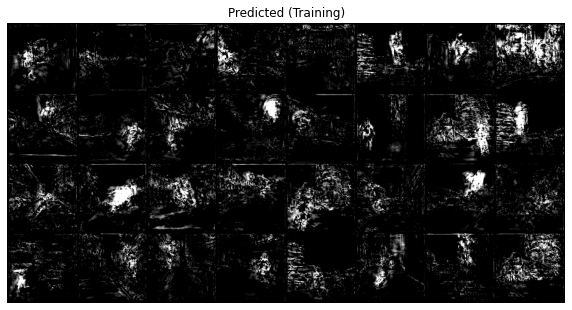

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.217702	Metric: 0.553569
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.133354	Metric: 0.600234
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.099147	Metric: 0.650577
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.081810	Metric: 0.677049
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.070072	Metric: 0.705139
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.063708	Metric: 0.703326
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.057532	Metric: 0.718249
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.052639	Metric: 0.741844
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.048728	Metric: 0.756439
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.045866	Metric: 0.760554
Batch ID:  500


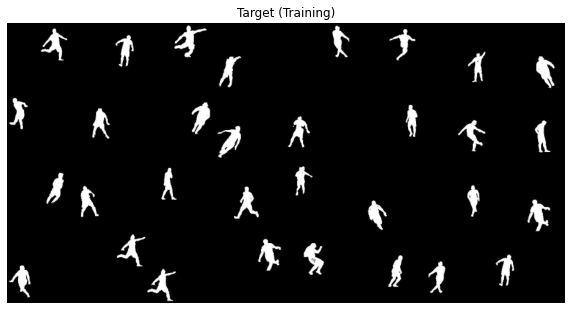

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


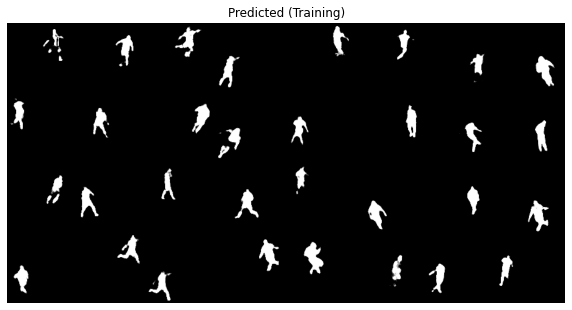

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.042741	Metric: 0.775212
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.041653	Metric: 0.776107
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.039332	Metric: 0.784355
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.037450	Metric: 0.789168
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.035805	Metric: 0.795635
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.034928	Metric: 0.805740
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.034006	Metric: 0.803332
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.033199	Metric: 0.801121
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.031470	Metric: 0.813808
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.031687	Metric: 0.815121
Batch ID:  1000


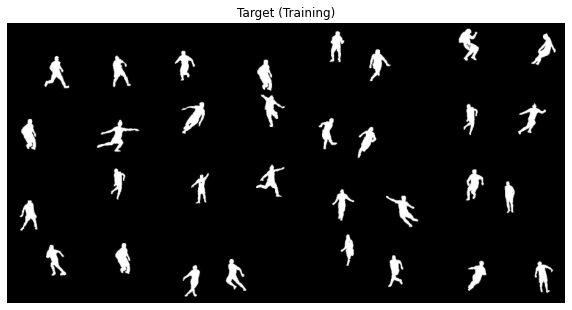

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


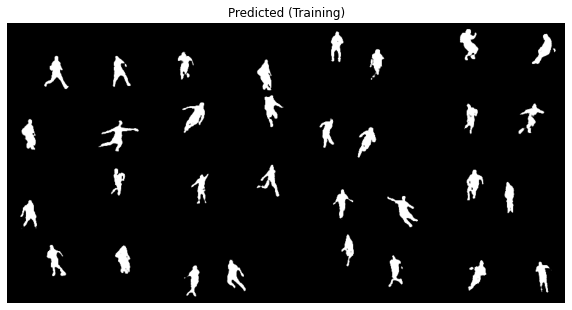

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.030809	Metric: 0.814478
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.030387	Metric: 0.814505
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.029724	Metric: 0.819851
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.029032	Metric: 0.818863
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.028531	Metric: 0.823465
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.028221	Metric: 0.822658
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.027455	Metric: 0.826175
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.027298	Metric: 0.826626
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.026545	Metric: 0.833830
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.026701	Metric: 0.832410
Batch ID:  1500


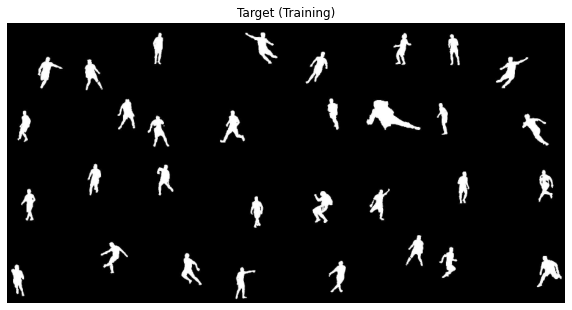

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


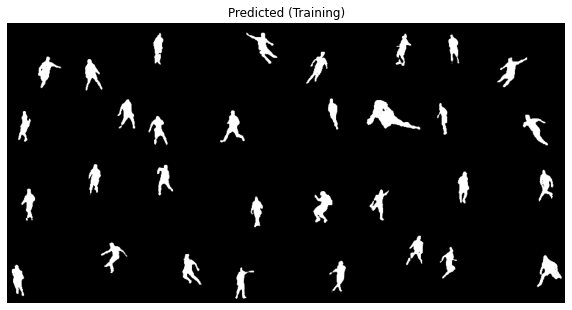

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.026306	Metric: 0.831859
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.025831	Metric: 0.833833
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.025457	Metric: 0.835438
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.025242	Metric: 0.840389
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.024736	Metric: 0.837327
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.024538	Metric: 0.837942
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.024330	Metric: 0.843658
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.025004	Metric: 0.835036
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.024872	Metric: 0.835957
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.023517	Metric: 0.845608
Batch ID:  2000


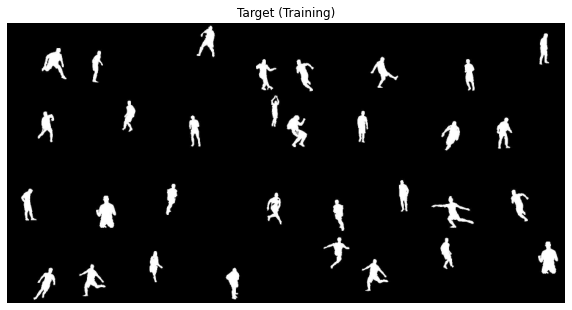

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


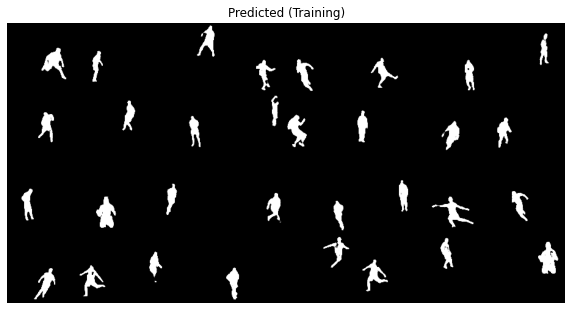

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.023925	Metric: 0.841741
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.023349	Metric: 0.844320
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.023408	Metric: 0.842022
Batch ID:  2150
Some target vs predicted samples:


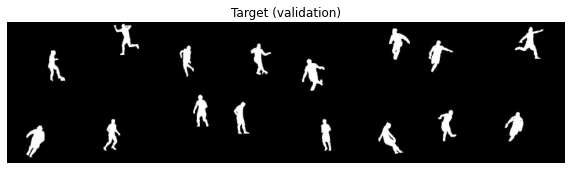

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


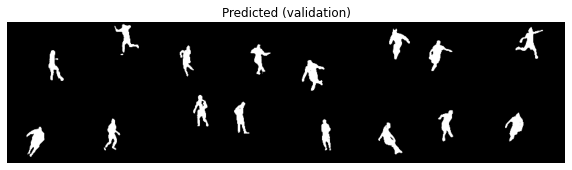

Average Validation loss: 0.02321792609973757	 Average IOU: 0.8450916324978444
--- 2021.580906867981 seconds ---


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds ---" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_001_1.pth")

In [0]:
model.load_state_dict(torch.load('/content/drive/My Drive/unet_001_1.pth'))

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.022455	Metric: 0.848162
Batch ID:  0


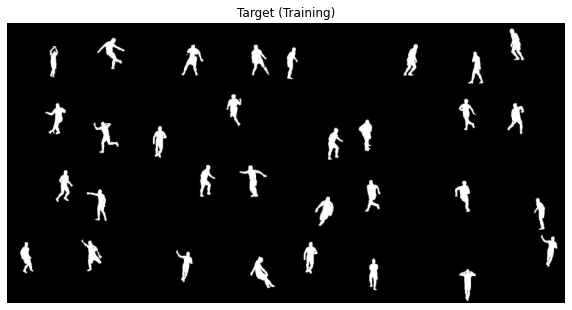

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


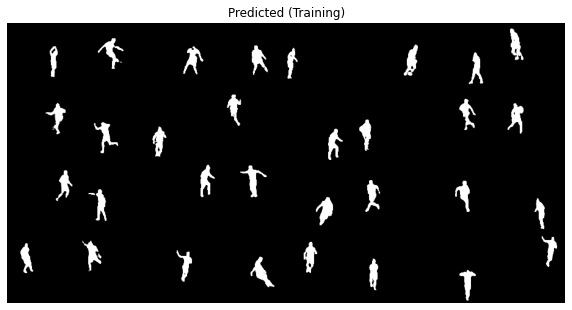

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.022738	Metric: 0.851010
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.023033	Metric: 0.846650
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.022551	Metric: 0.849120
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.022382	Metric: 0.848978
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.022182	Metric: 0.848715
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.021973	Metric: 0.852638
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.022143	Metric: 0.849690
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.022379	Metric: 0.849925
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.022096	Metric: 0.848058
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.021778	Metric: 0.854671
Batch ID:  500


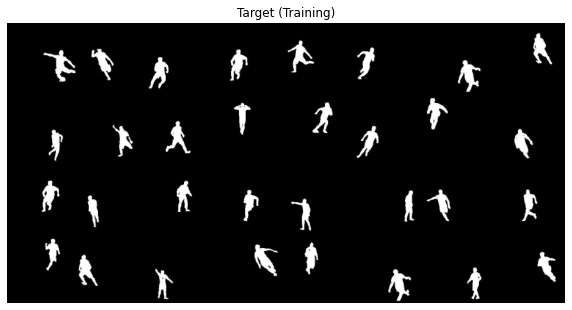

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


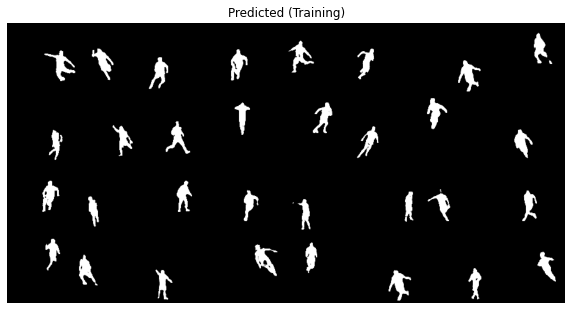

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.021473	Metric: 0.856661
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.021439	Metric: 0.856917
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.021048	Metric: 0.856895
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.021787	Metric: 0.852790
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.021341	Metric: 0.852140
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.021714	Metric: 0.849536
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.021385	Metric: 0.854493
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.021013	Metric: 0.855368
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.020916	Metric: 0.858194
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.021478	Metric: 0.855989
Batch ID:  1000


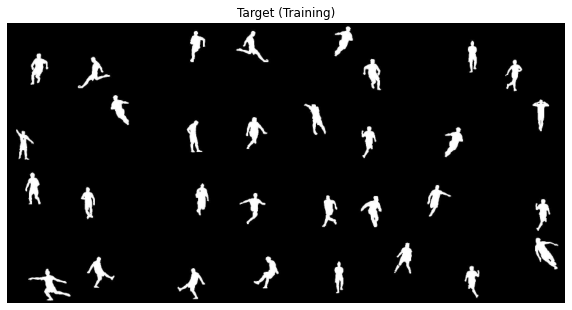

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


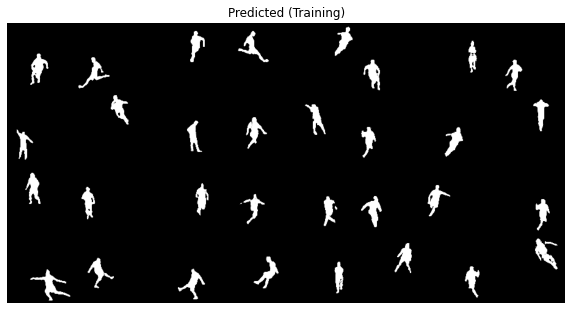

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.020527	Metric: 0.859821
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.021267	Metric: 0.854479
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.020826	Metric: 0.852745
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.021628	Metric: 0.853989
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.020114	Metric: 0.861323
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.020475	Metric: 0.859346
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.020659	Metric: 0.858633
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.020217	Metric: 0.860627
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.020249	Metric: 0.860451
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.020278	Metric: 0.859532
Batch ID:  1500


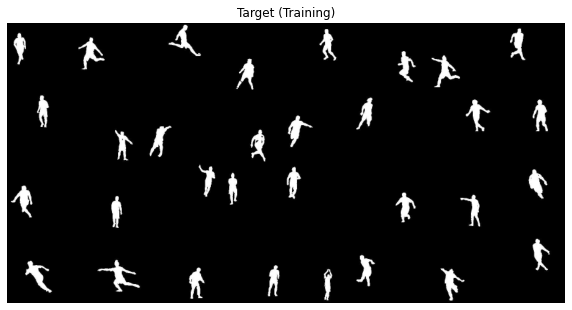

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


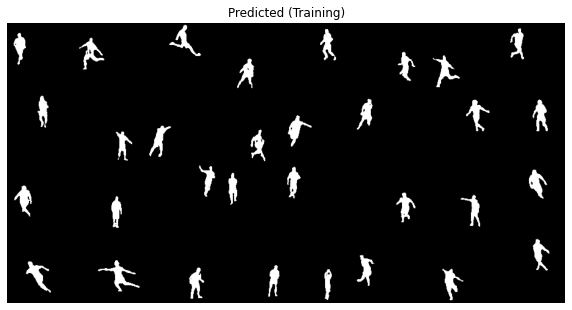

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.020330	Metric: 0.858461
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.020257	Metric: 0.862003
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.020880	Metric: 0.854678
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.020231	Metric: 0.858647
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.019343	Metric: 0.862925
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.019293	Metric: 0.864338
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.019730	Metric: 0.863257
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.019886	Metric: 0.864871
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.019795	Metric: 0.862611
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.020228	Metric: 0.859103
Batch ID:  2000


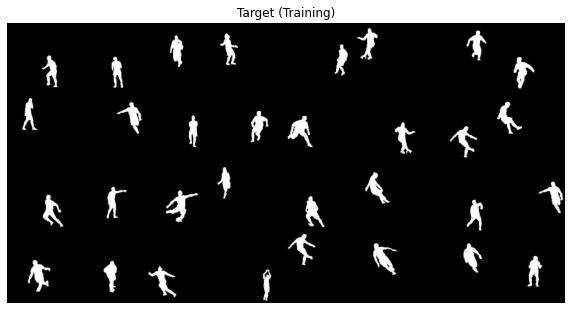

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


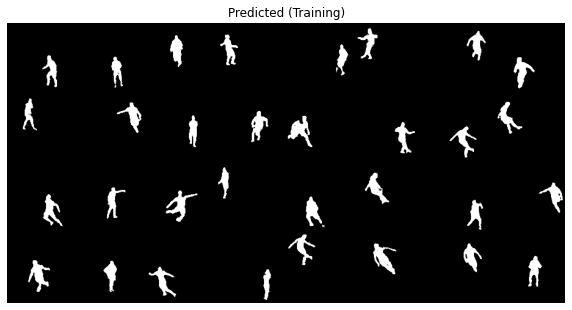

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.019599	Metric: 0.864072
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.019538	Metric: 0.861471
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.019822	Metric: 0.861238
Batch ID:  2150
Some target vs predicted samples:


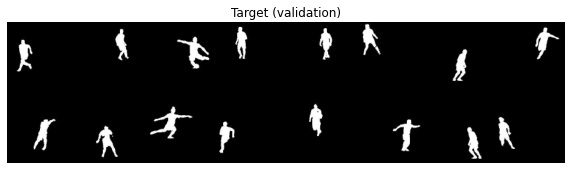

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


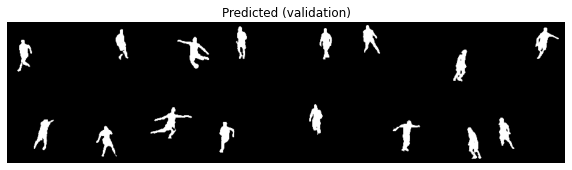

Average Validation loss: 0.019464726563789315	 Average IOU: 0.8633351784779318
--- 1954.4067735671997 seconds ---


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds ---" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_001_2.pth")

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.019469	Metric: 0.863746
Batch ID:  0


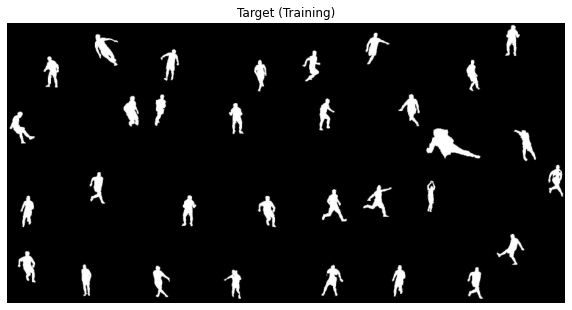

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


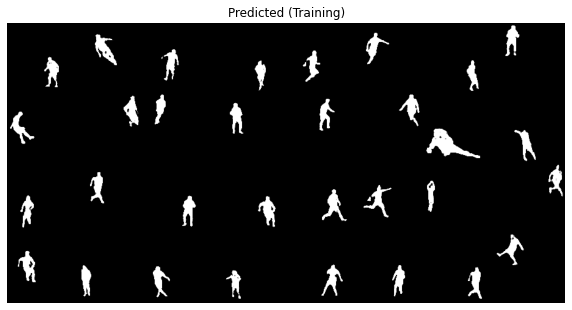

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.019277	Metric: 0.866048
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.020176	Metric: 0.858369
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.019502	Metric: 0.865916
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.019567	Metric: 0.861811
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.019997	Metric: 0.860076
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.019301	Metric: 0.867057
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.019050	Metric: 0.863701
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.018939	Metric: 0.868417
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.019377	Metric: 0.864545
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.019483	Metric: 0.862768
Batch ID:  500


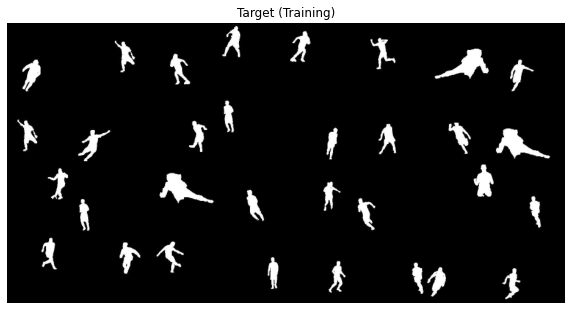

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


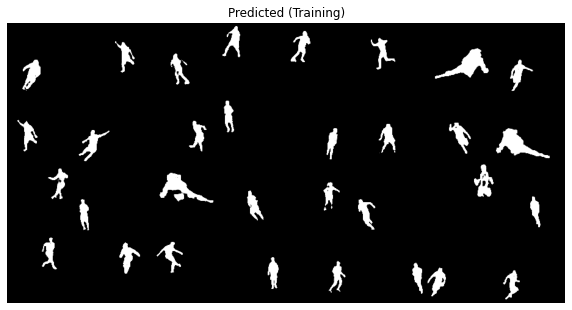

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.019409	Metric: 0.865459
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.019051	Metric: 0.866593
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.018582	Metric: 0.866933
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.018627	Metric: 0.869055
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.019054	Metric: 0.865723
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.018921	Metric: 0.866402
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.018695	Metric: 0.867429
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.018986	Metric: 0.867583
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.018860	Metric: 0.864620
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.018176	Metric: 0.868637
Batch ID:  1000


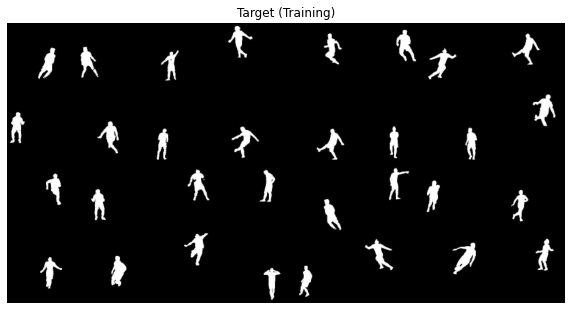

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


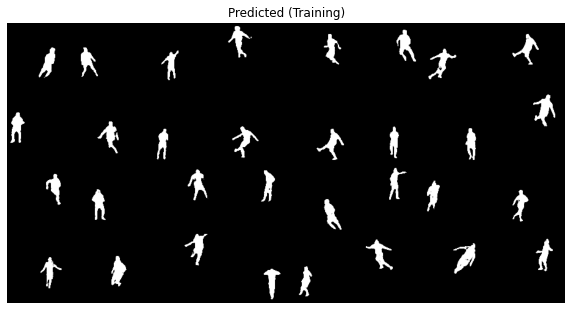

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.018682	Metric: 0.868969
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.019067	Metric: 0.865220
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.018538	Metric: 0.866578
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.018553	Metric: 0.870899
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.018475	Metric: 0.865876
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.018847	Metric: 0.869942
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.018180	Metric: 0.871667
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.018210	Metric: 0.870880
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.018432	Metric: 0.865346
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.017762	Metric: 0.870747
Batch ID:  1500


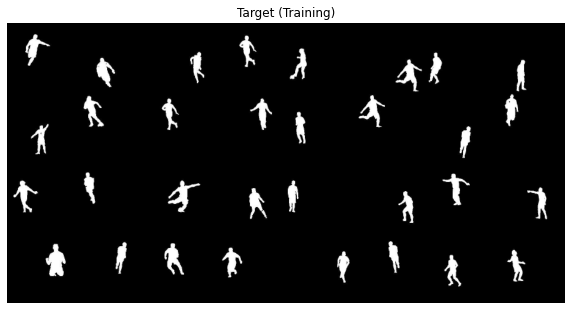

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


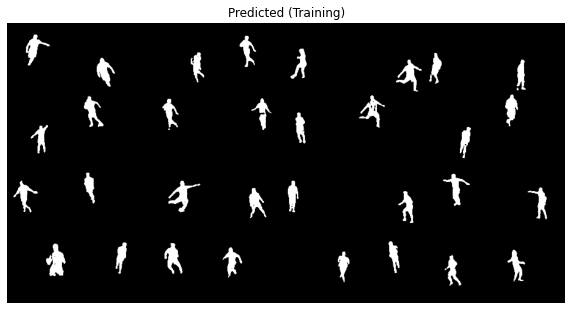

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.018295	Metric: 0.871025
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.018471	Metric: 0.867045
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.018436	Metric: 0.871049
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.018393	Metric: 0.870740
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.018102	Metric: 0.869246
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.018126	Metric: 0.866701
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.017747	Metric: 0.870671
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.018624	Metric: 0.869270
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.018343	Metric: 0.870482
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.018130	Metric: 0.869984
Batch ID:  2000


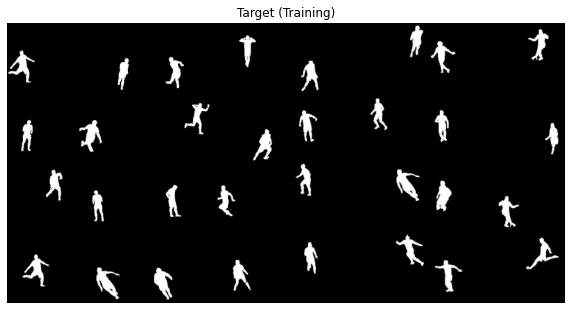

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


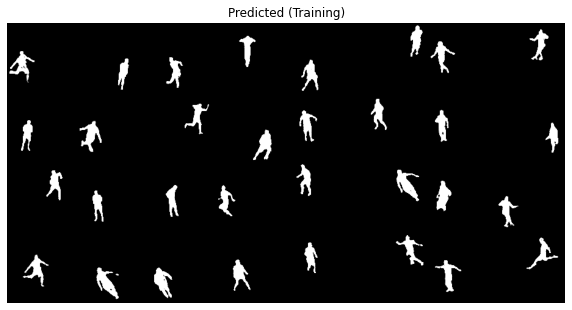

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.017793	Metric: 0.874164
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.017977	Metric: 0.872830
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.017838	Metric: 0.871984
Batch ID:  2150
Some target vs predicted samples:


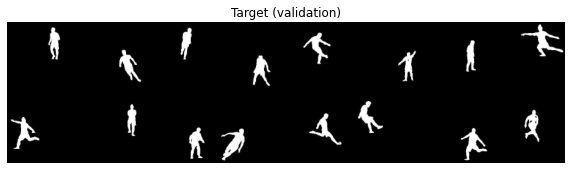

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


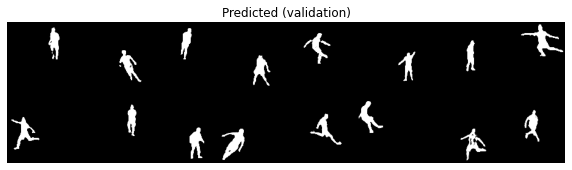

Average Validation loss: 0.018056593174094967	 Average IOU: 0.8710710987734642
--- 1943.728441953659 seconds ---


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds ---" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_001_3.pth")

In [0]:
model.load_state_dict(torch.load('/content/drive/My Drive/unet_001_3.pth'))

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.014105	Metric: 0.921891
Batch ID:  0


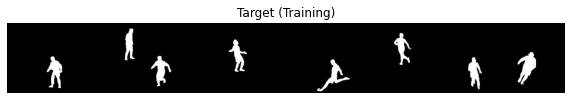

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


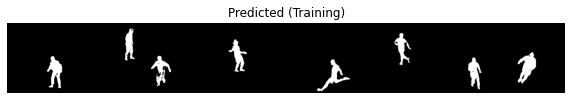

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.013399	Metric: 0.921943
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.012559	Metric: 0.932019
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.012547	Metric: 0.923393
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.012904	Metric: 0.921689
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.012199	Metric: 0.932529
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.012053	Metric: 0.924161
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.011416	Metric: 0.933903
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.011361	Metric: 0.931980
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.011969	Metric: 0.925745
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.011519	Metric: 0.934919
Batch ID:  500


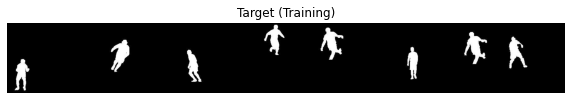

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


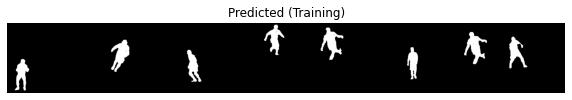

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.010668	Metric: 0.937833
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.011103	Metric: 0.939345
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.011592	Metric: 0.931556
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.010510	Metric: 0.937836
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.011232	Metric: 0.937926
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.010242	Metric: 0.940627
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.011070	Metric: 0.933911
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.010550	Metric: 0.940667
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.010934	Metric: 0.937051
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.010868	Metric: 0.934658
Batch ID:  1000


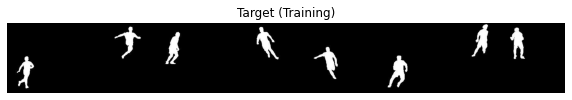

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


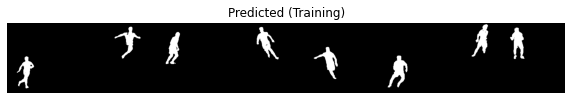

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.010058	Metric: 0.942529
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.010412	Metric: 0.941804
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.010867	Metric: 0.938965
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.010472	Metric: 0.941460
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.011042	Metric: 0.935583
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.010427	Metric: 0.940279
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.010997	Metric: 0.940096
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.010966	Metric: 0.941421
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.010738	Metric: 0.938366
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.009503	Metric: 0.946095
Batch ID:  1500


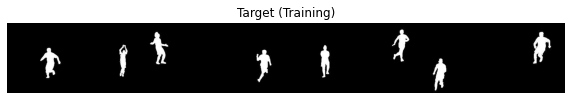

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


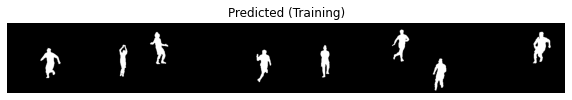

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.009991	Metric: 0.944792
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.010388	Metric: 0.938724
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.010002	Metric: 0.943735
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.009958	Metric: 0.943770
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.010083	Metric: 0.944240
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.010285	Metric: 0.945728
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.010685	Metric: 0.939107
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.010635	Metric: 0.941456
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.010287	Metric: 0.942068
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.010202	Metric: 0.941935
Batch ID:  2000


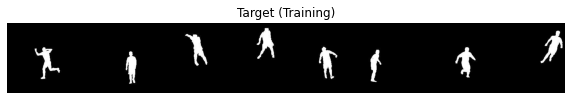

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


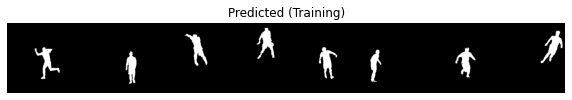

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.009616	Metric: 0.944407
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.009761	Metric: 0.947551
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.009941	Metric: 0.946043
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.010153	Metric: 0.945948
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.009696	Metric: 0.945508
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.010497	Metric: 0.940854
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.009301	Metric: 0.950908
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.009442	Metric: 0.947422
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.009788	Metric: 0.943720
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.009757	Metric: 0.944298
Batch ID:  2500


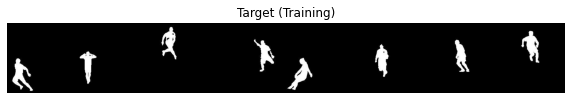

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


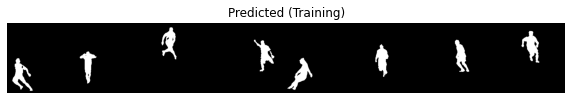

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.009880	Metric: 0.945772
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.009833	Metric: 0.946129
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.009938	Metric: 0.943263
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.009999	Metric: 0.947552
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.009587	Metric: 0.949250
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.010062	Metric: 0.943481
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.011404	Metric: 0.928592
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.009683	Metric: 0.946070
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.009666	Metric: 0.947687
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.009405	Metric: 0.948651
Batch ID:  3000


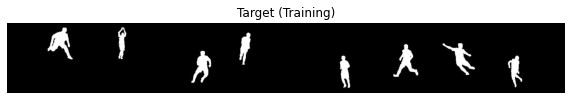

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


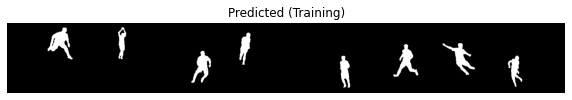

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.009907	Metric: 0.949085
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.010016	Metric: 0.946166
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.009149	Metric: 0.948835
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.009843	Metric: 0.945996
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.009059	Metric: 0.949914
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.009122	Metric: 0.948631
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.009305	Metric: 0.946085
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.009613	Metric: 0.948332
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.009836	Metric: 0.947825
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.010083	Metric: 0.949582
Batch ID:  3500


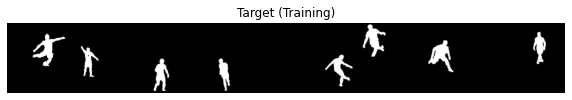

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


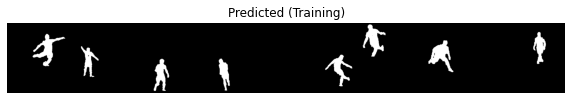

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.009671	Metric: 0.946267
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.009225	Metric: 0.947027
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.009719	Metric: 0.950960
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.009128	Metric: 0.949175
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.009326	Metric: 0.948637
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.009154	Metric: 0.951196
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.009604	Metric: 0.948299
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.009278	Metric: 0.949055
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.009312	Metric: 0.951752
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.008708	Metric: 0.952645
Batch ID:  4000


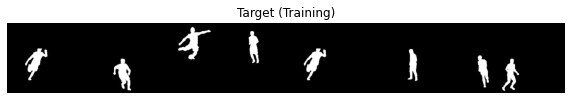

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


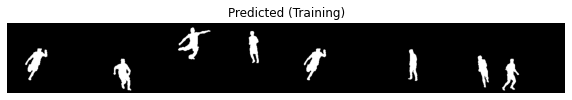

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.009407	Metric: 0.947461
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.009527	Metric: 0.943712
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.009222	Metric: 0.950249
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.009771	Metric: 0.949472
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.009765	Metric: 0.945205
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.009319	Metric: 0.949493
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.008969	Metric: 0.952166
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.009435	Metric: 0.947471
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.009443	Metric: 0.950195
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.009461	Metric: 0.948267
Batch ID:  4500


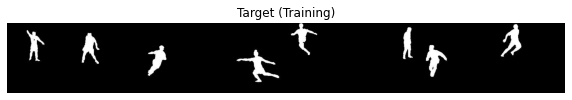

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


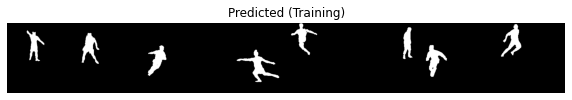

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.009163	Metric: 0.947732
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.009244	Metric: 0.947406
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.009101	Metric: 0.950295
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.009286	Metric: 0.950150
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.009619	Metric: 0.948830
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.009011	Metric: 0.953263
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.009221	Metric: 0.949391
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.009604	Metric: 0.949821
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.009223	Metric: 0.950130
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.009452	Metric: 0.948800
Batch ID:  5000


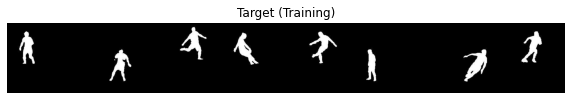

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


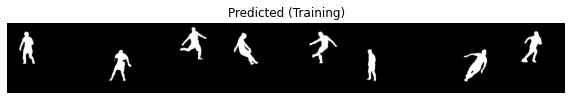

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.009519	Metric: 0.950317
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.009757	Metric: 0.945231
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.009389	Metric: 0.950133
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.009179	Metric: 0.949649
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.009371	Metric: 0.950993
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.009404	Metric: 0.949622
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.009363	Metric: 0.952347
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.009174	Metric: 0.952233
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.009159	Metric: 0.950912
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.009105	Metric: 0.951630
Batch ID:  5500


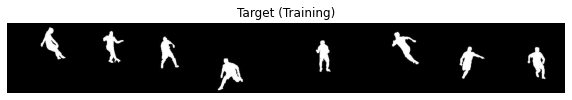

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


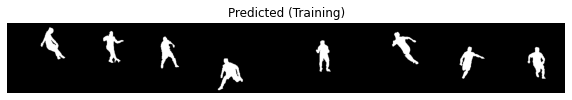

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.009320	Metric: 0.950796
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.009161	Metric: 0.947926
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.009196	Metric: 0.950803
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.009680	Metric: 0.948527
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.009131	Metric: 0.950048
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.009650	Metric: 0.950343
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.008832	Metric: 0.952080
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.009319	Metric: 0.951333
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.009063	Metric: 0.950242
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.008953	Metric: 0.951347
Batch ID:  6000


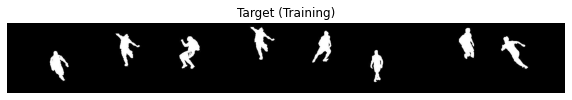

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


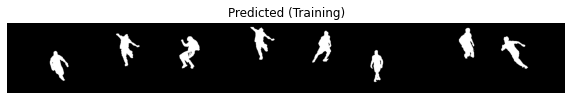

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.009302	Metric: 0.950869
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.008829	Metric: 0.951476
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.009267	Metric: 0.955060
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.009191	Metric: 0.952943
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.009084	Metric: 0.952447
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.008918	Metric: 0.949634
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.009111	Metric: 0.951360
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.009079	Metric: 0.956938
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.009306	Metric: 0.952342
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.009206	Metric: 0.952602
Batch ID:  6500


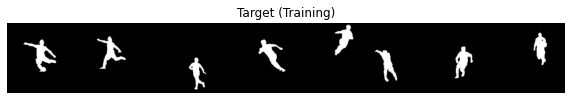

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


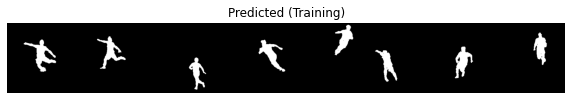

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.008723	Metric: 0.952307
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.008907	Metric: 0.952734
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.009255	Metric: 0.949558
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.008906	Metric: 0.954577
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.008956	Metric: 0.953545
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.008765	Metric: 0.951342
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.009129	Metric: 0.952081
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.008920	Metric: 0.952570
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.008607	Metric: 0.953640
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.009129	Metric: 0.951619
Batch ID:  7000


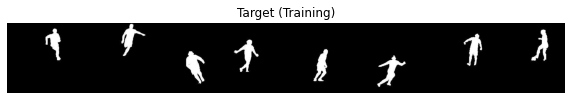

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


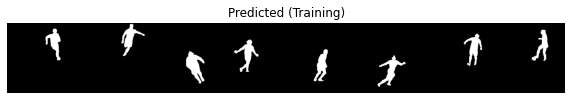

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.008744	Metric: 0.952271
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.008868	Metric: 0.953847
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.008728	Metric: 0.953491
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.008771	Metric: 0.956145
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.008939	Metric: 0.953891
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.009030	Metric: 0.949715
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.009032	Metric: 0.954156
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.009080	Metric: 0.956395
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.008706	Metric: 0.954201
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.008741	Metric: 0.952715
Batch ID:  7500


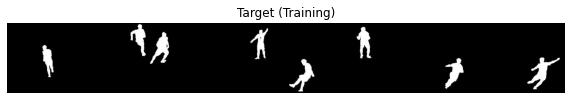

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


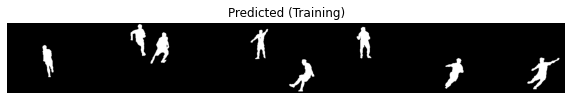

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.008807	Metric: 0.953284
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.009604	Metric: 0.953063
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.008997	Metric: 0.954950
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.009073	Metric: 0.952244
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.008760	Metric: 0.955633
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.009066	Metric: 0.953624
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.008914	Metric: 0.951510
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.009154	Metric: 0.948608
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.009068	Metric: 0.949254
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.008436	Metric: 0.954582
Batch ID:  8000


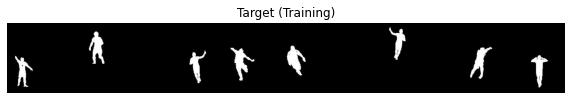

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


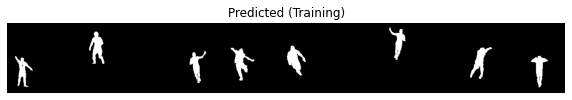

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.009488	Metric: 0.950372
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.008792	Metric: 0.954159
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.008540	Metric: 0.951064
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.008959	Metric: 0.950470
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.008921	Metric: 0.951982
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.008648	Metric: 0.954693
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.008587	Metric: 0.953630
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.008791	Metric: 0.952433
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.009268	Metric: 0.954372
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.008825	Metric: 0.954125
Batch ID:  8500


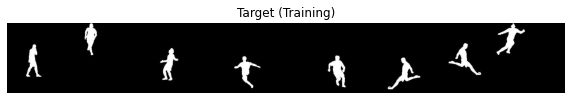

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


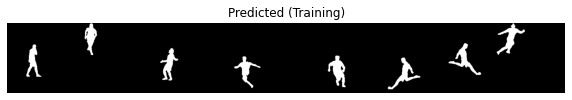

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.008835	Metric: 0.952767
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.008384	Metric: 0.954029
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.008976	Metric: 0.950594
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.009258	Metric: 0.950755
Batch ID:  8700
Some target vs predicted samples:


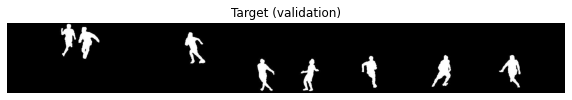

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


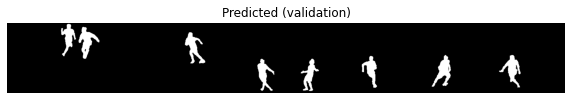

Average Validation loss: 0.008812482657035192	 Average IOU: 0.9528431822141011
--- 5840.577091217041 seconds ---


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.01, epochs=1)
print("--- %s seconds ---" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_001_4.pth")

##Depth Estimation

In [0]:
from losses import RMSE, custom_loss

In [0]:
model.load_state_dict(torch.load('/content/drive/My Drive/unet_001_4.pth'),  strict = False)

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_initial_depth.pth")

In [0]:
metric = RMSE()

In [0]:
criterion = nn.L1Loss()
# criterion = SSIM(11, 'mean')

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.565756	Metric: 6.786368
Batch ID:  0


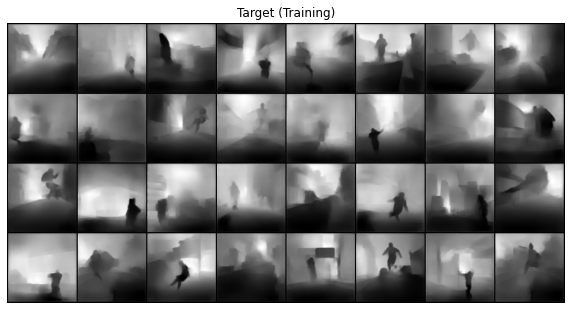

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


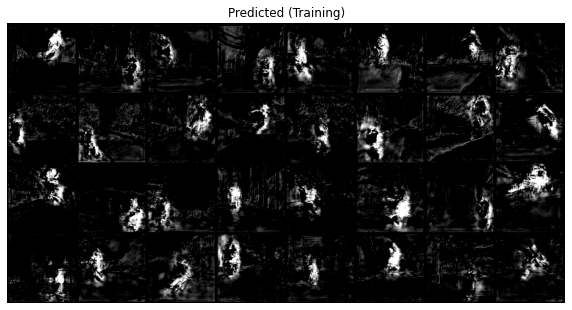

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.175570	Metric: 2.236414
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.155948	Metric: 1.987399
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.145482	Metric: 1.889067
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.144122	Metric: 1.852280
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.138295	Metric: 1.788274
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.136132	Metric: 1.749371
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.133220	Metric: 1.743944
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.130457	Metric: 1.688600
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.131301	Metric: 1.720918
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.125075	Metric: 1.633679
Batch ID:  500


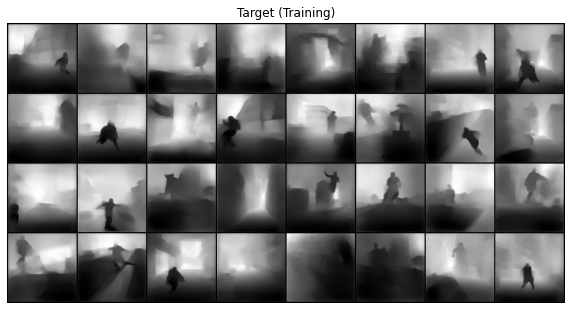

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


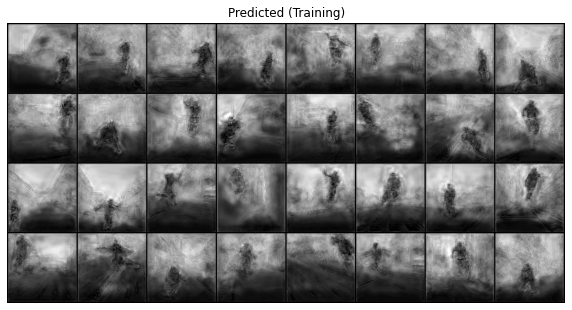

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.125904	Metric: 1.648407
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.124709	Metric: 1.642428
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.124116	Metric: 1.617378
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.120802	Metric: 1.581828
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.119518	Metric: 1.575430
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.115665	Metric: 1.524383
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.120711	Metric: 1.590369
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.116522	Metric: 1.531314
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.115300	Metric: 1.527936
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.113984	Metric: 1.501712
Batch ID:  1000


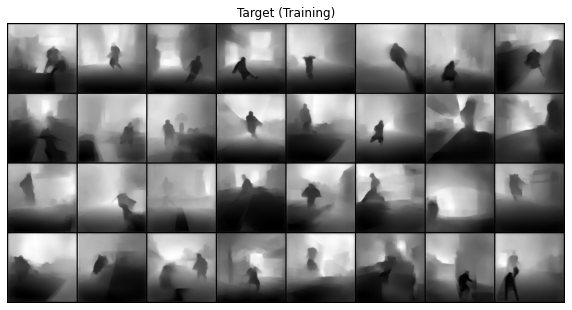

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


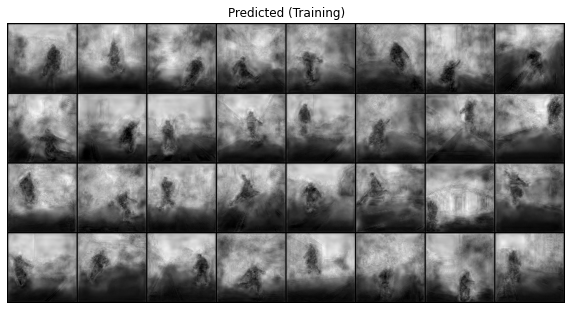

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.115811	Metric: 1.528296
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.111188	Metric: 1.476363
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.111896	Metric: 1.483452
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.116614	Metric: 1.529445
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.114940	Metric: 1.534393
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.109235	Metric: 1.437161
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.111070	Metric: 1.478991
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.106111	Metric: 1.416362
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.106650	Metric: 1.435957
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.108171	Metric: 1.439616
Batch ID:  1500


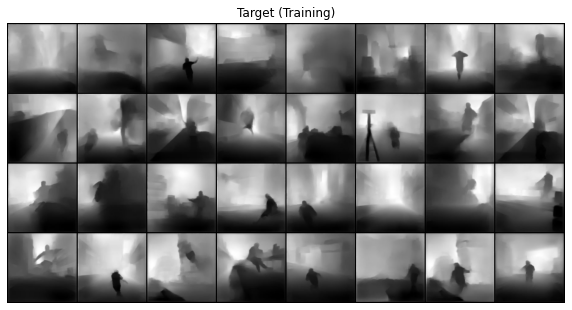

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


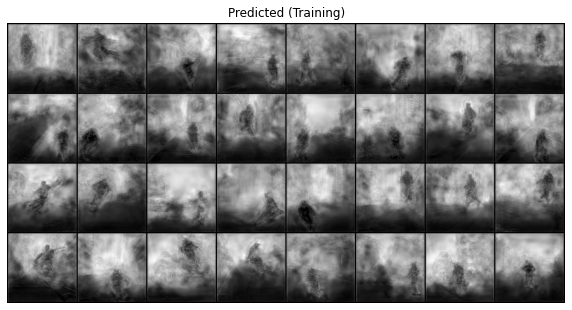

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.106271	Metric: 1.414191
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.104828	Metric: 1.402761
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.105752	Metric: 1.411152
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.102681	Metric: 1.370241
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.108637	Metric: 1.442686
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.104952	Metric: 1.403899
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.103896	Metric: 1.397386
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.097585	Metric: 1.327360
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.103695	Metric: 1.395896
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.098483	Metric: 1.345805
Batch ID:  2000


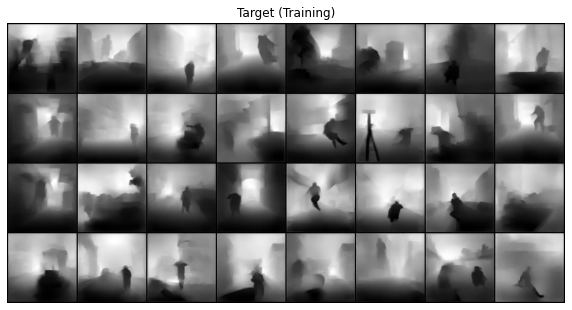

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


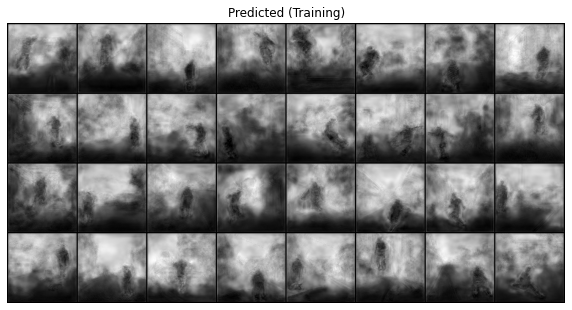

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.104976	Metric: 1.414610
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.098299	Metric: 1.335954
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.100397	Metric: 1.336484
Batch ID:  2150
Some target vs predicted samples:


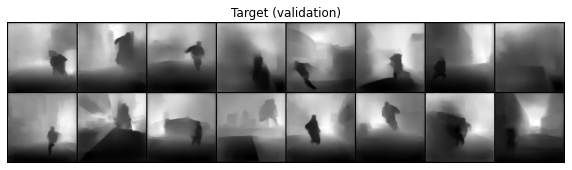

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


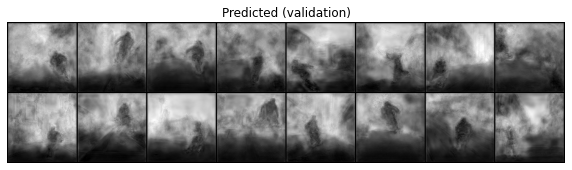

Average Validation loss: 0.09726710778786175	 Average Metric: 1.3166385989453493
--- 1446.6676831245422 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.099178	Metric: 1.344856
Batch ID:  0


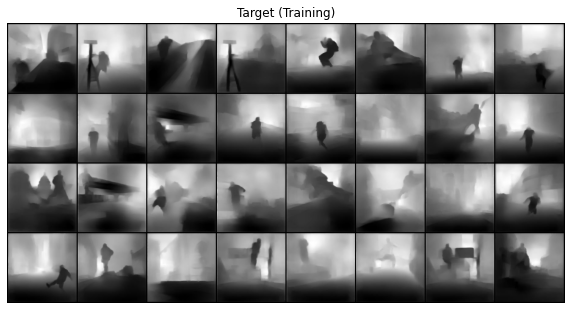

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


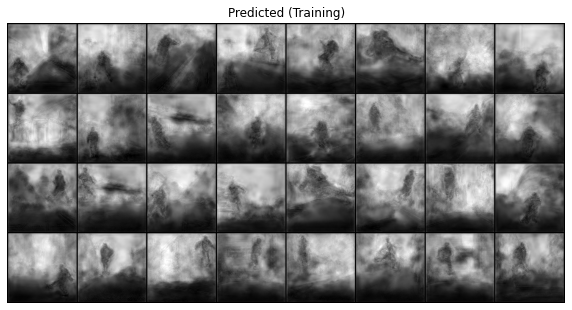

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.099844	Metric: 1.343182
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.097492	Metric: 1.321165
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.097040	Metric: 1.319644
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.095989	Metric: 1.295671
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.095431	Metric: 1.296419
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.096302	Metric: 1.299315
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.098552	Metric: 1.332433
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.092232	Metric: 1.247318
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.096808	Metric: 1.296196
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.093710	Metric: 1.270933
Batch ID:  500


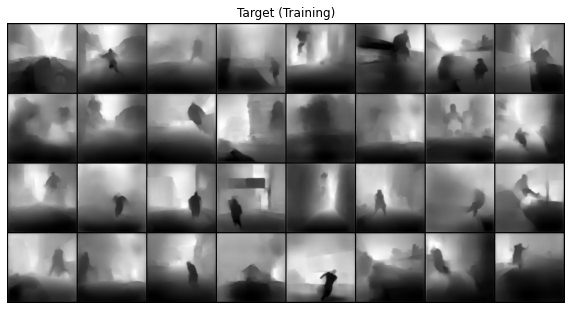

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


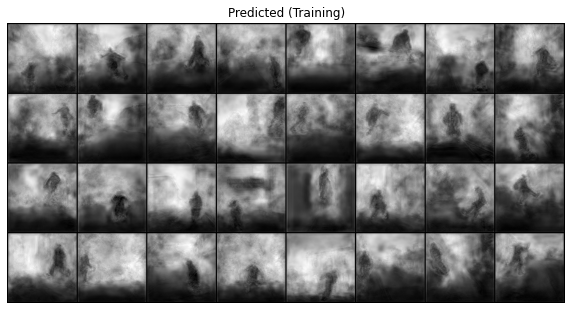

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.096324	Metric: 1.294705
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.092233	Metric: 1.267586
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.096251	Metric: 1.298102
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.091770	Metric: 1.244906
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.094057	Metric: 1.270990
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.088996	Metric: 1.208151
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.091271	Metric: 1.240343
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.087404	Metric: 1.201660
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.098642	Metric: 1.335596
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.089479	Metric: 1.234137
Batch ID:  1000


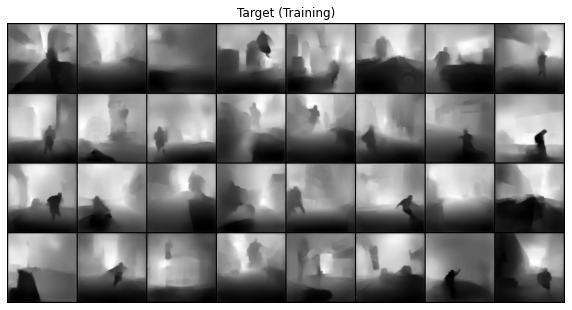

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


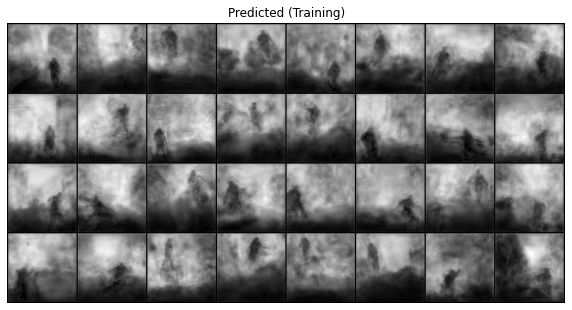

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.092778	Metric: 1.274034
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.088955	Metric: 1.234031
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.089779	Metric: 1.242274
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.090191	Metric: 1.230768
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.090867	Metric: 1.248456
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.087445	Metric: 1.209789
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.092280	Metric: 1.271245
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.090553	Metric: 1.243514
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.087983	Metric: 1.207865
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.088124	Metric: 1.191471
Batch ID:  1500


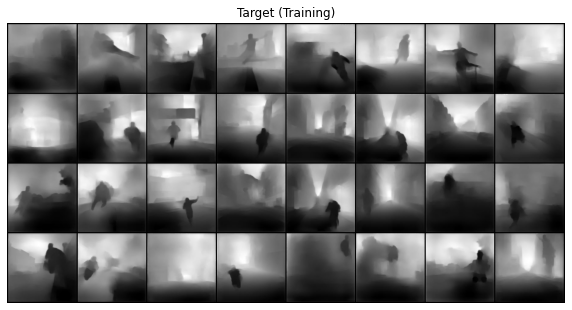

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


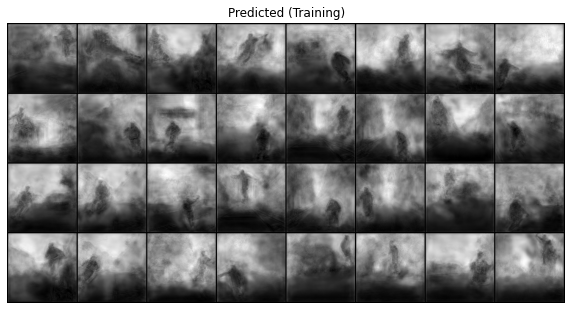

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.085457	Metric: 1.168592
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.091451	Metric: 1.246788
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.086543	Metric: 1.197019
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.092314	Metric: 1.257518
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.086572	Metric: 1.208890
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.084762	Metric: 1.175336
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.086926	Metric: 1.201607
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.084420	Metric: 1.184418
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.087790	Metric: 1.190801
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.086667	Metric: 1.208516
Batch ID:  2000


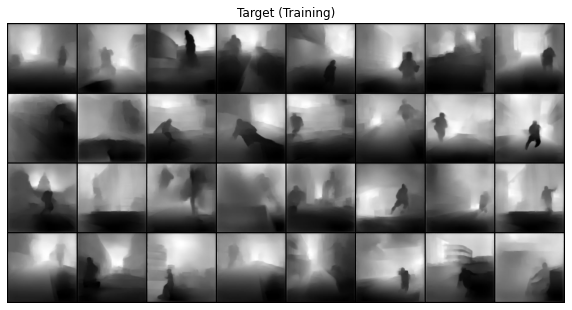

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


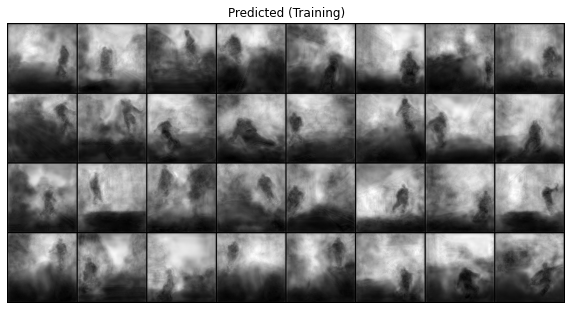

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.087927	Metric: 1.211908
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.088328	Metric: 1.228163
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.088603	Metric: 1.215719
Batch ID:  2150
Some target vs predicted samples:


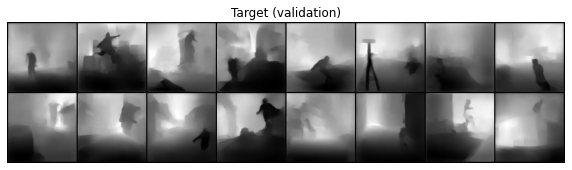

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


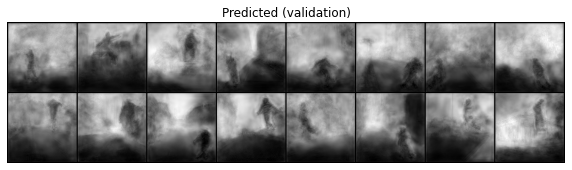

Average Validation loss: 0.08532652805354804	 Average Metric: 1.1885282459543711
--- 1477.285965204239 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_depth_l1_e2.pth")

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.087007	Metric: 1.204219
Batch ID:  0


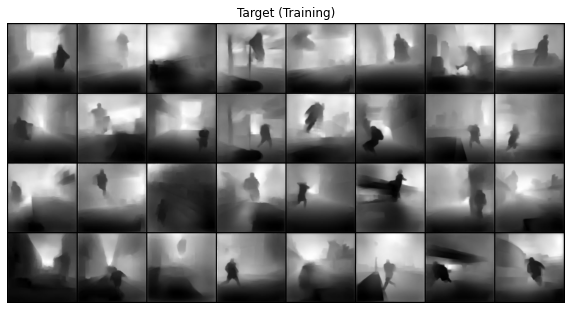

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


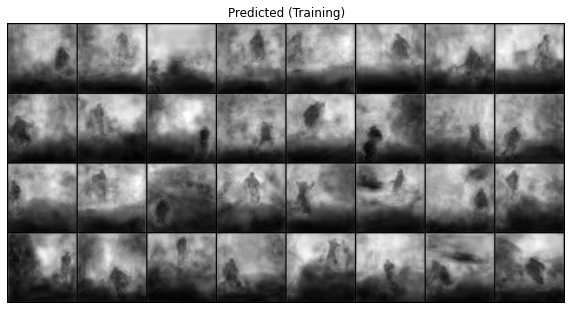

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.088980	Metric: 1.233064
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.087803	Metric: 1.215283
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.091756	Metric: 1.272007
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.084697	Metric: 1.174567
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.085479	Metric: 1.186317
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.087169	Metric: 1.203861
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.085794	Metric: 1.189390
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.084215	Metric: 1.175876
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.084805	Metric: 1.191946
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.090397	Metric: 1.242214
Batch ID:  500


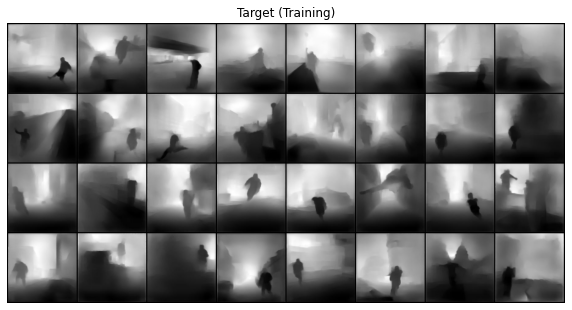

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


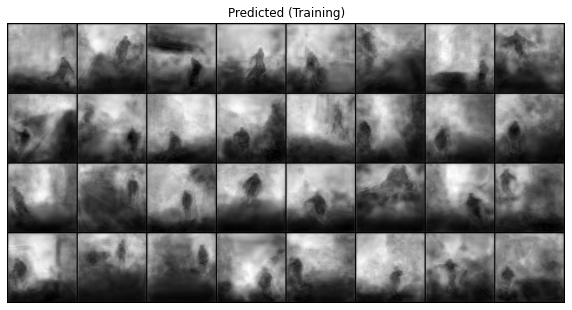

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.086731	Metric: 1.213480
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.090379	Metric: 1.252571
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.085978	Metric: 1.186743
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.085050	Metric: 1.201704
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.080385	Metric: 1.137057
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.087829	Metric: 1.214444
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.081925	Metric: 1.161039
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.083217	Metric: 1.158174
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.079768	Metric: 1.102999
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.083246	Metric: 1.172236
Batch ID:  1000


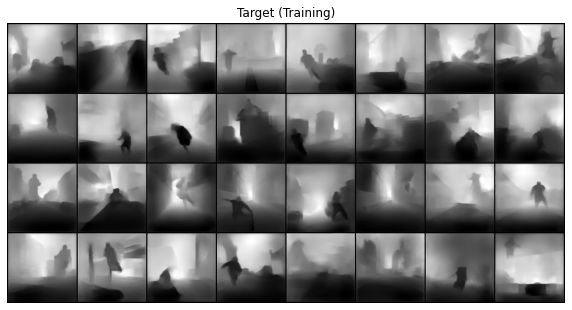

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


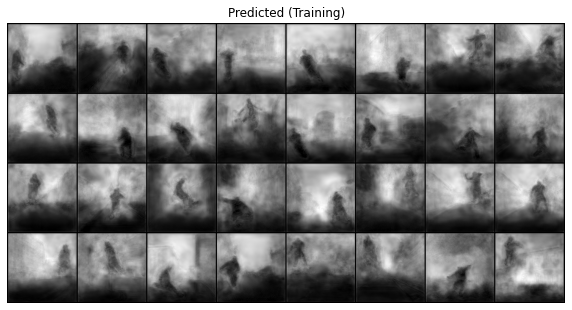

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.082903	Metric: 1.160867
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.084459	Metric: 1.166638
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.081479	Metric: 1.128827
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.085322	Metric: 1.184741
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.083183	Metric: 1.160170
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.081398	Metric: 1.130567
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.088440	Metric: 1.221642
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.085116	Metric: 1.177981
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.083527	Metric: 1.158028
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.086283	Metric: 1.199185
Batch ID:  1500


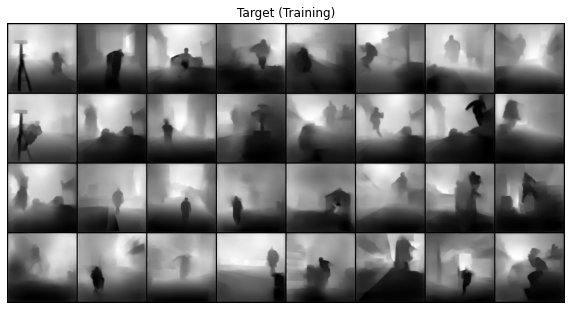

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


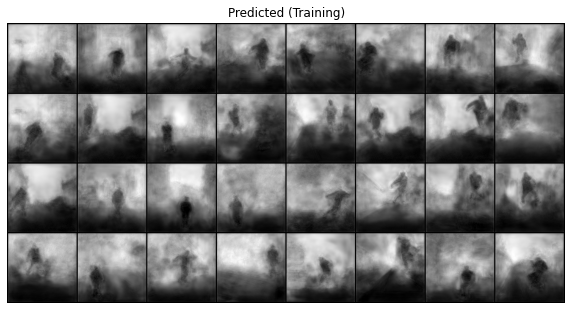

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.086635	Metric: 1.213141
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.082227	Metric: 1.144958
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.081284	Metric: 1.140975
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.085802	Metric: 1.179431
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.083486	Metric: 1.168847
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.083927	Metric: 1.163719
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.081963	Metric: 1.116816
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.080716	Metric: 1.124373
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.079074	Metric: 1.100821
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.083803	Metric: 1.193807
Batch ID:  2000


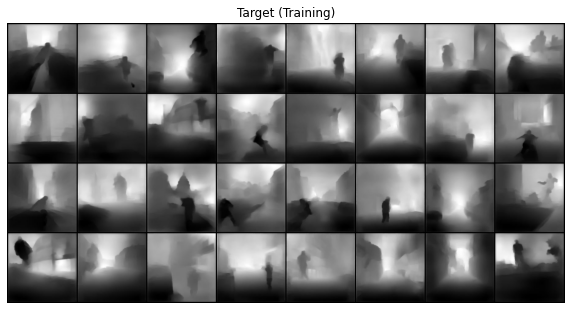

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


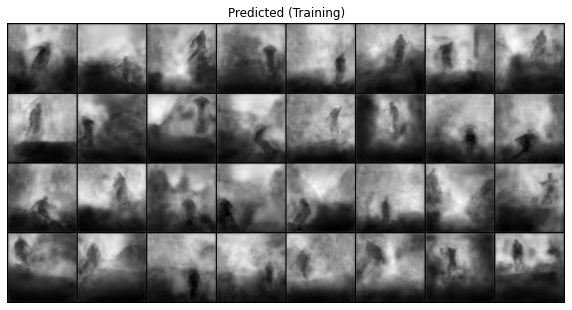

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.079351	Metric: 1.120316
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.080021	Metric: 1.103562
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.079617	Metric: 1.124875
Batch ID:  2150
Some target vs predicted samples:


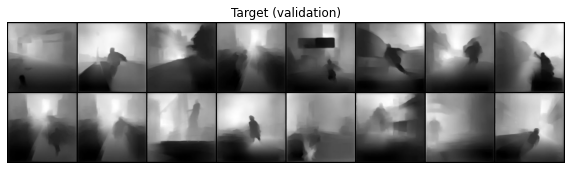

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


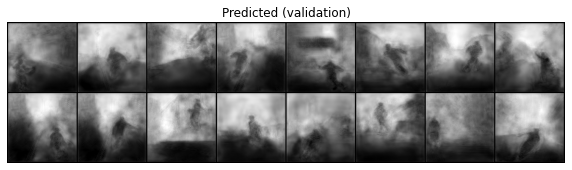

Average Validation loss: 0.08140056369019978	 Average Metric: 1.1419524662276066
--- 1467.7452206611633 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
model.load_state_dict(torch.load("/content/drive/My Drive/unet_depth_l1_e5.pth"),  strict = False)

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.083819	Metric: 1.176248
Batch ID:  0


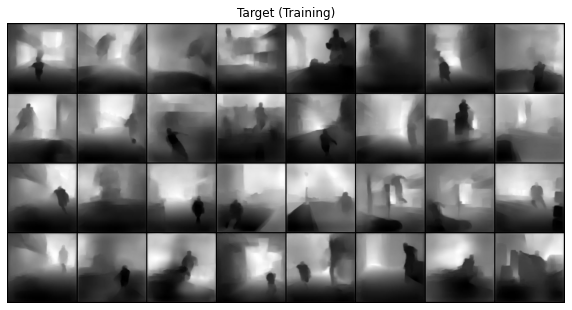

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


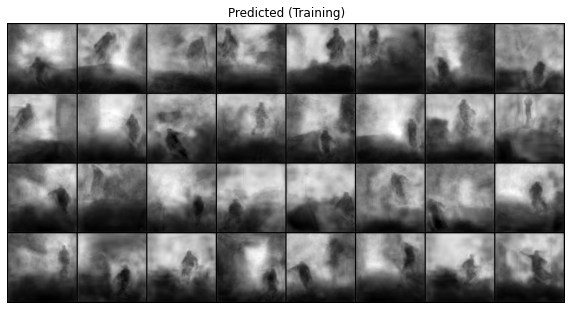

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.083247	Metric: 1.163655
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.081230	Metric: 1.134329
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.075091	Metric: 1.079195
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.073808	Metric: 1.063757
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.073476	Metric: 1.045722
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.077333	Metric: 1.088274
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.080998	Metric: 1.123770
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.076141	Metric: 1.065173
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.077468	Metric: 1.088422
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.081191	Metric: 1.127328
Batch ID:  500


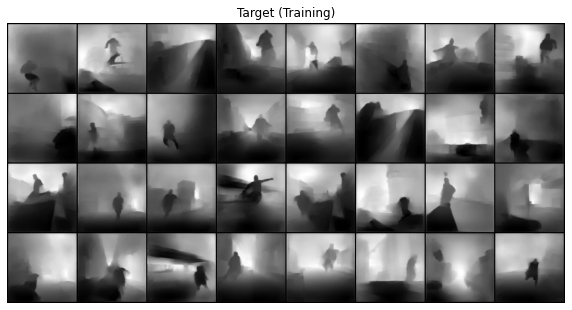

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


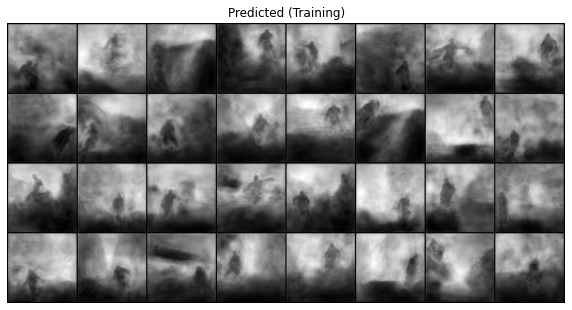

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.078931	Metric: 1.115747
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.075222	Metric: 1.059610
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.078591	Metric: 1.098500
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.078970	Metric: 1.089190
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.072819	Metric: 1.031073
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.075243	Metric: 1.074832
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.075833	Metric: 1.068102
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.072667	Metric: 1.031217
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.075638	Metric: 1.072582
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.075698	Metric: 1.073292
Batch ID:  1000


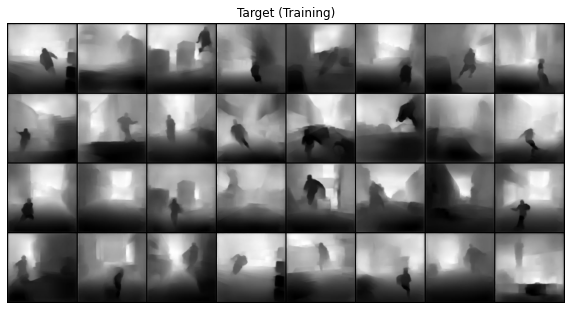

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


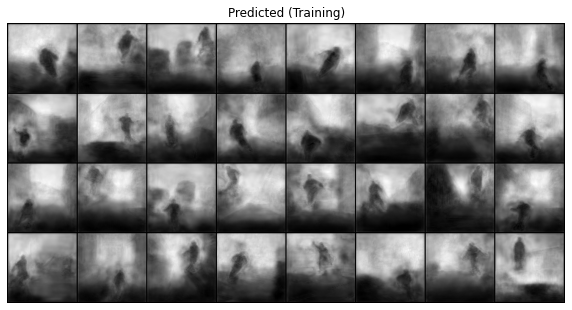

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.076167	Metric: 1.068826
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.071711	Metric: 1.036340
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.075771	Metric: 1.080111
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.077694	Metric: 1.093501
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.073812	Metric: 1.042605
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.078805	Metric: 1.092613
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.073153	Metric: 1.037832
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.076376	Metric: 1.067667
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.073107	Metric: 1.030183
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.078297	Metric: 1.101128
Batch ID:  1500


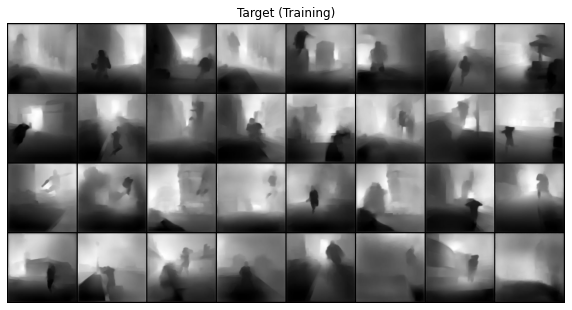

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


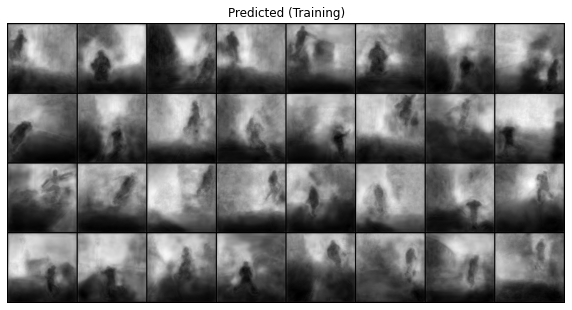

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.078969	Metric: 1.099629
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.077401	Metric: 1.086358
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.077904	Metric: 1.104384
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.072318	Metric: 1.045859
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.078892	Metric: 1.109420
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.077567	Metric: 1.106908
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.079227	Metric: 1.122578
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.075814	Metric: 1.084938
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.077940	Metric: 1.117120
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.078527	Metric: 1.109383
Batch ID:  2000


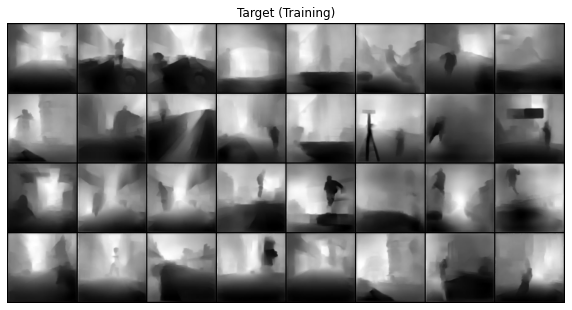

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


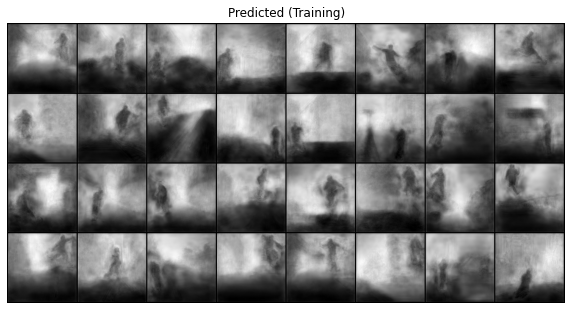

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.077085	Metric: 1.079190
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.075481	Metric: 1.084682
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.078669	Metric: 1.091897
Batch ID:  2150
Some target vs predicted samples:


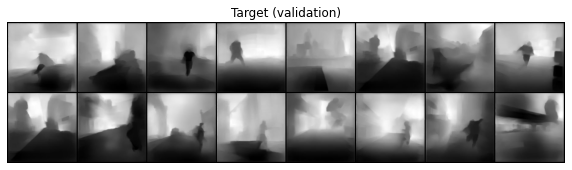

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


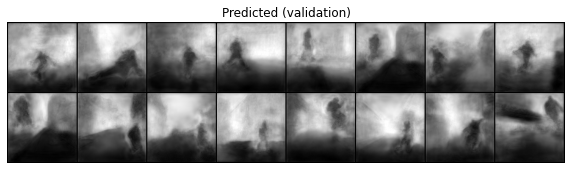

Average Validation loss: 0.07606597454436044	 Average Metric: 1.0823826343774288
--- 1786.55473446846 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.079745	Metric: 1.140565
Batch ID:  0


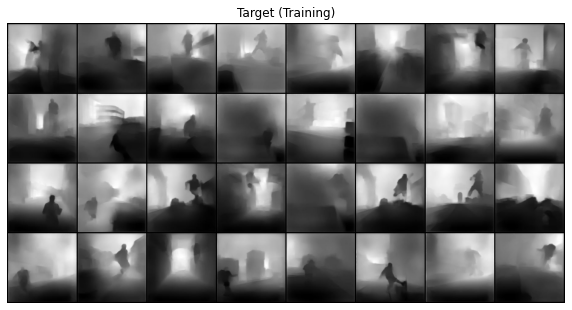

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


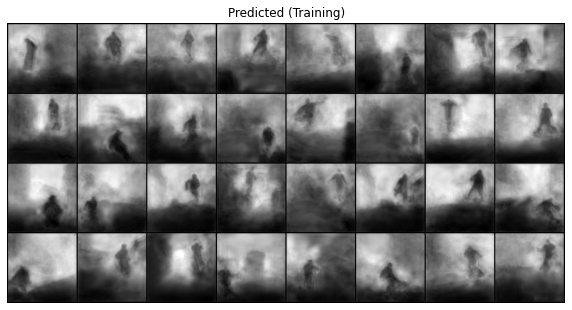

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.076265	Metric: 1.078232
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.077348	Metric: 1.081666
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.077661	Metric: 1.093315
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.075966	Metric: 1.063997
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.078393	Metric: 1.108552
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.075738	Metric: 1.062346
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.074331	Metric: 1.048203
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.078211	Metric: 1.093003
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.076825	Metric: 1.090212
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.076375	Metric: 1.078916
Batch ID:  500


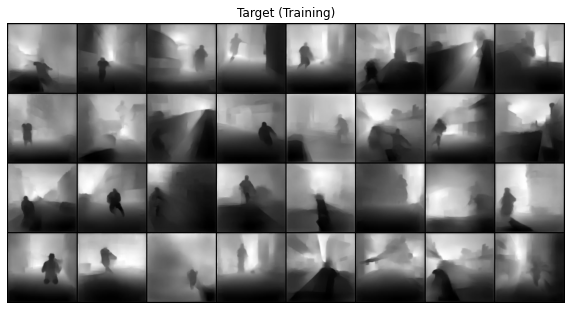

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


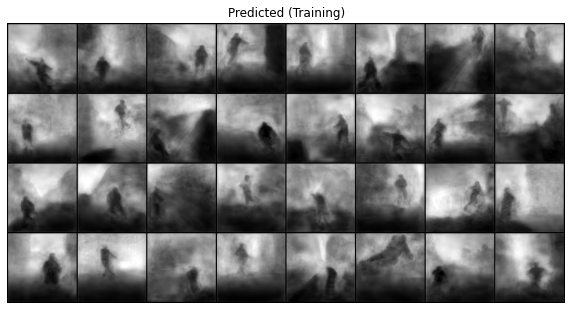

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.075196	Metric: 1.065941
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.076084	Metric: 1.082178
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.074025	Metric: 1.041703
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.076766	Metric: 1.071016
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.076975	Metric: 1.084369
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.075310	Metric: 1.071367
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.073436	Metric: 1.034023
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.077934	Metric: 1.098164
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.075373	Metric: 1.055167
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.078344	Metric: 1.093915
Batch ID:  1000


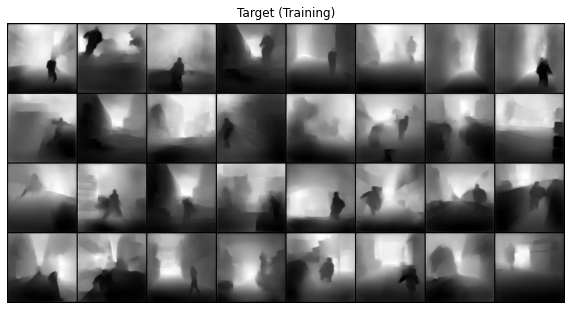

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


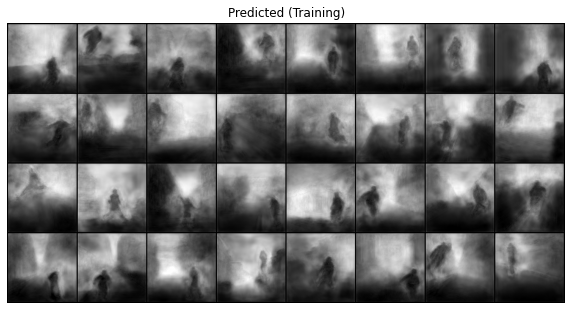

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.072723	Metric: 1.041566
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.076970	Metric: 1.091854
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.072141	Metric: 1.039138
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.073691	Metric: 1.057805
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.074869	Metric: 1.065831
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.076605	Metric: 1.061117
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.082000	Metric: 1.153979
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.074405	Metric: 1.051874
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.075233	Metric: 1.068437
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.076070	Metric: 1.070056
Batch ID:  1500


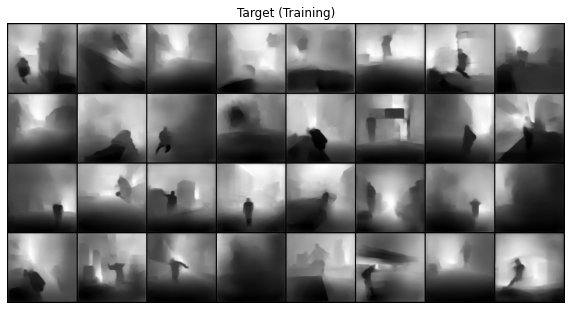

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


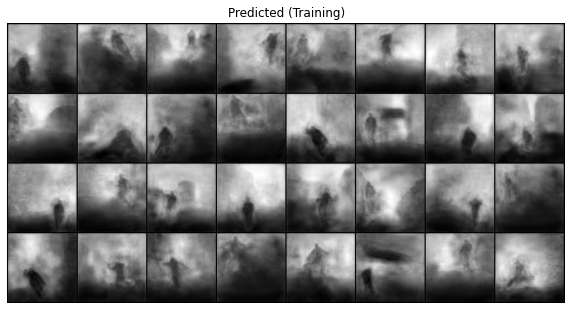

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.074063	Metric: 1.069691
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.074229	Metric: 1.046478
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.073198	Metric: 1.031873
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.070581	Metric: 1.008241
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.074946	Metric: 1.061900
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.073411	Metric: 1.067192
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.080239	Metric: 1.115111
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.078625	Metric: 1.110586
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.074761	Metric: 1.043573
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.073309	Metric: 1.040654
Batch ID:  2000


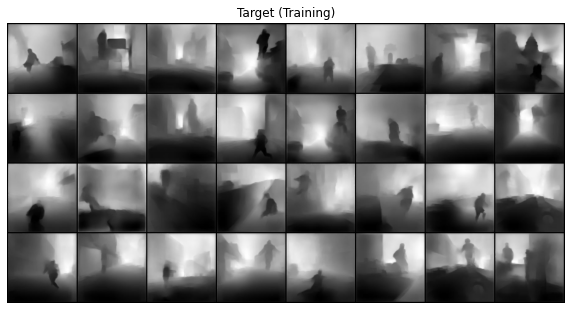

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


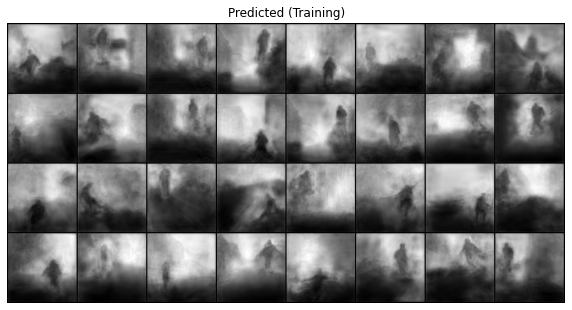

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.076208	Metric: 1.069967
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.075156	Metric: 1.051083
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.075312	Metric: 1.064030
Batch ID:  2150
Some target vs predicted samples:


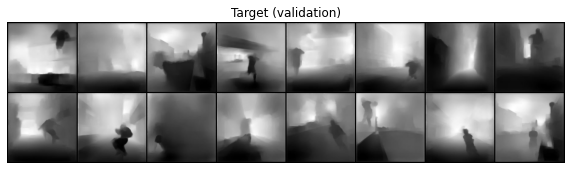

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


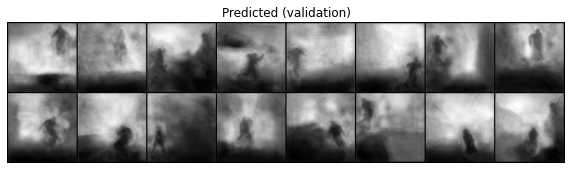

Average Validation loss: 0.07567121520606694	 Average Metric: 1.0734325947283683
Train Epoch: 2 [0/280000 (0%)]	Loss: 0.077914	Metric: 1.083346
Batch ID:  0


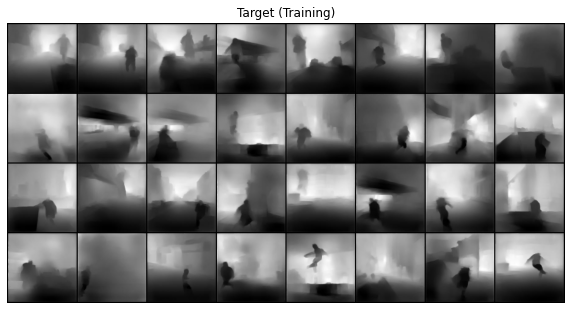

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


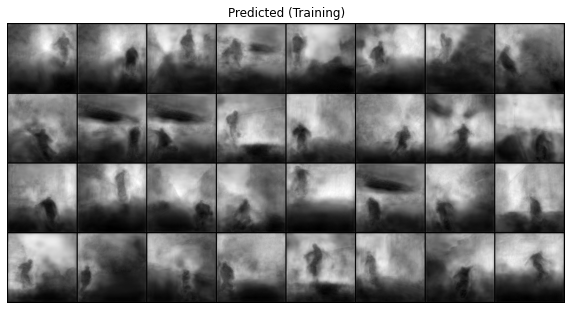

Train Epoch: 2 [6400/280000 (2%)]	Loss: 0.073740	Metric: 1.058361
Batch ID:  50
Train Epoch: 2 [12800/280000 (5%)]	Loss: 0.074092	Metric: 1.047306
Batch ID:  100
Train Epoch: 2 [19200/280000 (7%)]	Loss: 0.072493	Metric: 1.032590
Batch ID:  150
Train Epoch: 2 [25600/280000 (9%)]	Loss: 0.074457	Metric: 1.056381
Batch ID:  200
Train Epoch: 2 [32000/280000 (11%)]	Loss: 0.070721	Metric: 1.004162
Batch ID:  250
Train Epoch: 2 [38400/280000 (14%)]	Loss: 0.074023	Metric: 1.052302
Batch ID:  300
Train Epoch: 2 [44800/280000 (16%)]	Loss: 0.074544	Metric: 1.076207
Batch ID:  350
Train Epoch: 2 [51200/280000 (18%)]	Loss: 0.074069	Metric: 1.049275
Batch ID:  400
Train Epoch: 2 [57600/280000 (21%)]	Loss: 0.077030	Metric: 1.092584
Batch ID:  450
Train Epoch: 2 [64000/280000 (23%)]	Loss: 0.073979	Metric: 1.044429
Batch ID:  500


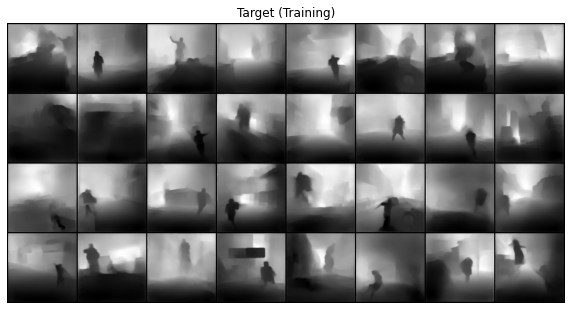

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


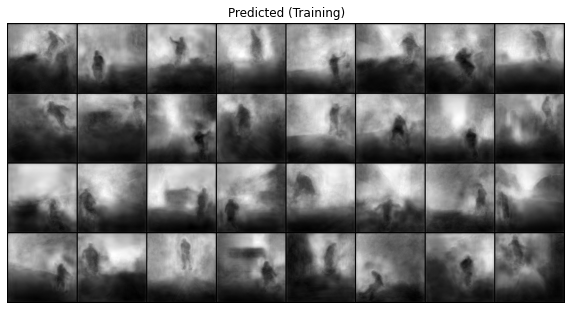

Train Epoch: 2 [70400/280000 (25%)]	Loss: 0.072987	Metric: 1.047339
Batch ID:  550
Train Epoch: 2 [76800/280000 (27%)]	Loss: 0.076199	Metric: 1.071494
Batch ID:  600
Train Epoch: 2 [83200/280000 (30%)]	Loss: 0.076995	Metric: 1.066935
Batch ID:  650
Train Epoch: 2 [89600/280000 (32%)]	Loss: 0.076650	Metric: 1.090650
Batch ID:  700
Train Epoch: 2 [96000/280000 (34%)]	Loss: 0.076465	Metric: 1.071345
Batch ID:  750
Train Epoch: 2 [102400/280000 (37%)]	Loss: 0.076851	Metric: 1.090201
Batch ID:  800
Train Epoch: 2 [108800/280000 (39%)]	Loss: 0.078574	Metric: 1.114675
Batch ID:  850
Train Epoch: 2 [115200/280000 (41%)]	Loss: 0.078520	Metric: 1.126590
Batch ID:  900
Train Epoch: 2 [121600/280000 (43%)]	Loss: 0.074602	Metric: 1.061632
Batch ID:  950
Train Epoch: 2 [128000/280000 (46%)]	Loss: 0.072988	Metric: 1.036834
Batch ID:  1000


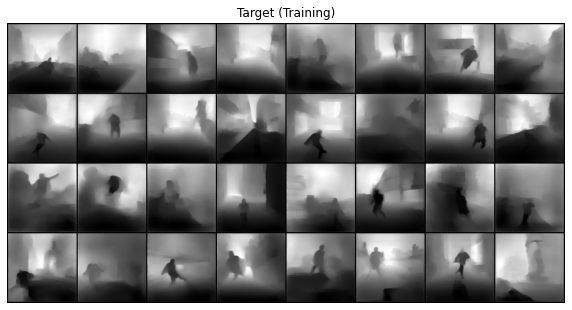

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


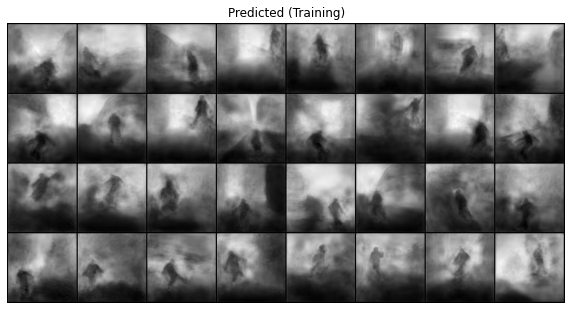

Train Epoch: 2 [134400/280000 (48%)]	Loss: 0.075328	Metric: 1.064263
Batch ID:  1050
Train Epoch: 2 [140800/280000 (50%)]	Loss: 0.075623	Metric: 1.061406
Batch ID:  1100
Train Epoch: 2 [147200/280000 (53%)]	Loss: 0.078025	Metric: 1.098345
Batch ID:  1150
Train Epoch: 2 [153600/280000 (55%)]	Loss: 0.077434	Metric: 1.097036
Batch ID:  1200
Train Epoch: 2 [160000/280000 (57%)]	Loss: 0.072366	Metric: 1.014249
Batch ID:  1250
Train Epoch: 2 [166400/280000 (59%)]	Loss: 0.070592	Metric: 1.010424
Batch ID:  1300
Train Epoch: 2 [172800/280000 (62%)]	Loss: 0.070462	Metric: 1.007928
Batch ID:  1350
Train Epoch: 2 [179200/280000 (64%)]	Loss: 0.074369	Metric: 1.060952
Batch ID:  1400
Train Epoch: 2 [185600/280000 (66%)]	Loss: 0.075451	Metric: 1.076015
Batch ID:  1450
Train Epoch: 2 [192000/280000 (69%)]	Loss: 0.072846	Metric: 1.026006
Batch ID:  1500


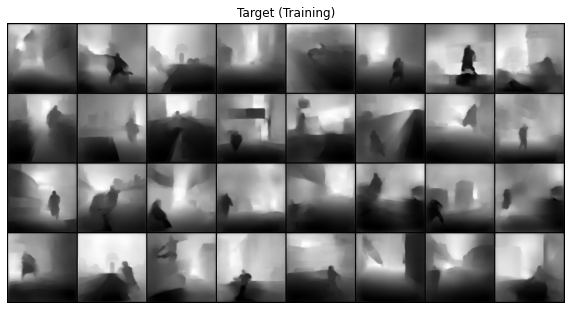

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


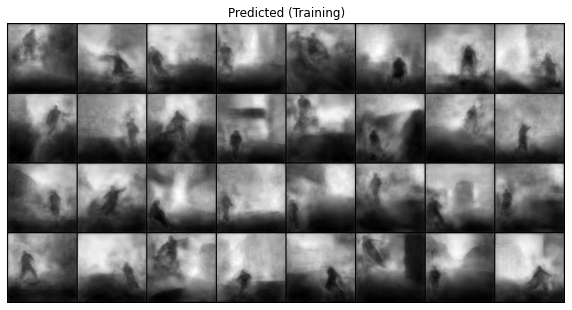

Train Epoch: 2 [198400/280000 (71%)]	Loss: 0.071475	Metric: 1.024928
Batch ID:  1550
Train Epoch: 2 [204800/280000 (73%)]	Loss: 0.075073	Metric: 1.055838
Batch ID:  1600
Train Epoch: 2 [211200/280000 (75%)]	Loss: 0.076140	Metric: 1.080896
Batch ID:  1650
Train Epoch: 2 [217600/280000 (78%)]	Loss: 0.074194	Metric: 1.050356
Batch ID:  1700
Train Epoch: 2 [224000/280000 (80%)]	Loss: 0.074579	Metric: 1.064382
Batch ID:  1750
Train Epoch: 2 [230400/280000 (82%)]	Loss: 0.070100	Metric: 1.020502
Batch ID:  1800
Train Epoch: 2 [236800/280000 (85%)]	Loss: 0.077198	Metric: 1.078510
Batch ID:  1850
Train Epoch: 2 [243200/280000 (87%)]	Loss: 0.071693	Metric: 1.020931
Batch ID:  1900
Train Epoch: 2 [249600/280000 (89%)]	Loss: 0.074267	Metric: 1.071938
Batch ID:  1950
Train Epoch: 2 [256000/280000 (91%)]	Loss: 0.073315	Metric: 1.041029
Batch ID:  2000


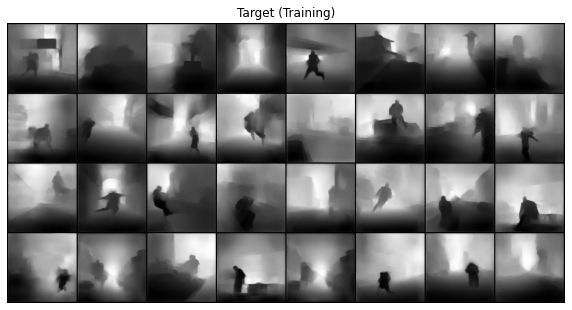

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


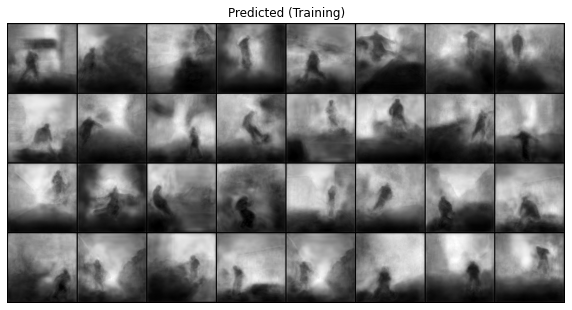

Train Epoch: 2 [262400/280000 (94%)]	Loss: 0.071817	Metric: 1.027136
Batch ID:  2050
Train Epoch: 2 [268800/280000 (96%)]	Loss: 0.075108	Metric: 1.069520
Batch ID:  2100
Train Epoch: 2 [275200/280000 (98%)]	Loss: 0.071860	Metric: 1.018639
Batch ID:  2150
Some target vs predicted samples:


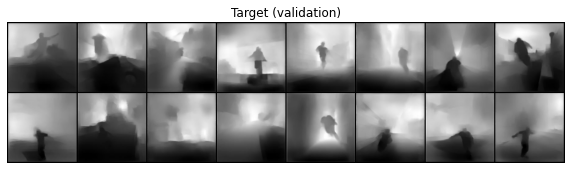

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


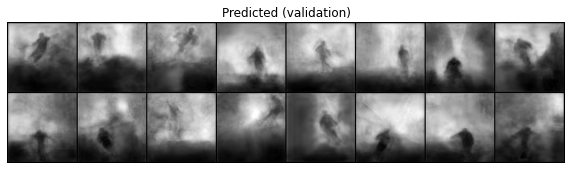

Average Validation loss: 0.07240573281863097	 Average Metric: 1.033842931805389
--- 3479.12100315094 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=2)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_depth_l1_e8.pth")

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_depth_l1_e10.pth")

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.070464	Metric: 1.009690
Batch ID:  0


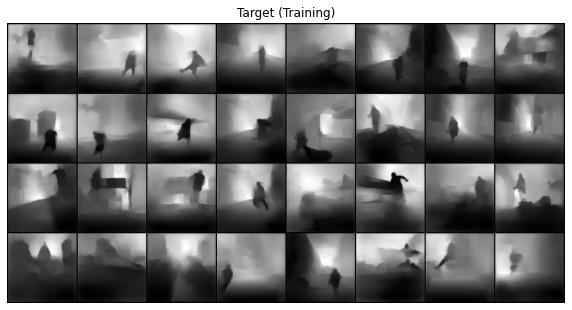

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


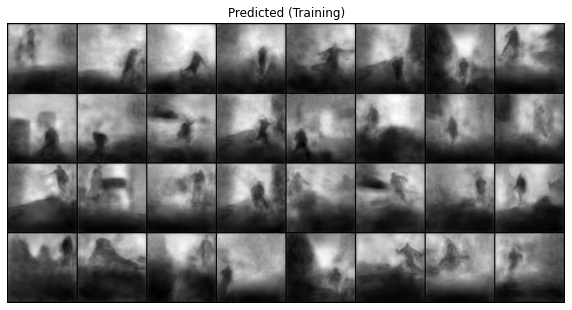

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.074113	Metric: 1.043643
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.074444	Metric: 1.080309
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.070909	Metric: 1.025970
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.069239	Metric: 0.980363
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.072942	Metric: 1.039540
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.068983	Metric: 0.993300
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.069163	Metric: 0.976762
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.070791	Metric: 1.009909
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.074014	Metric: 1.046455
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.076124	Metric: 1.083898
Batch ID:  500


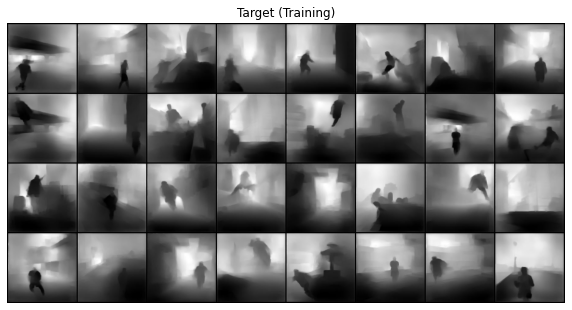

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


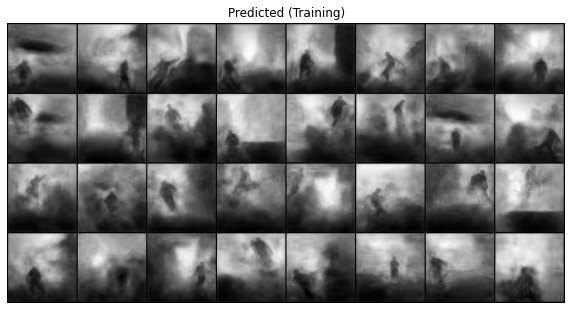

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.076321	Metric: 1.072392
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.068623	Metric: 0.972089
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.069034	Metric: 0.979459
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.066229	Metric: 0.943769
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.071165	Metric: 1.026028
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.077711	Metric: 1.078476
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.072679	Metric: 1.043688
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.070850	Metric: 1.008329
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.077333	Metric: 1.102504
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.070845	Metric: 1.026431
Batch ID:  1000


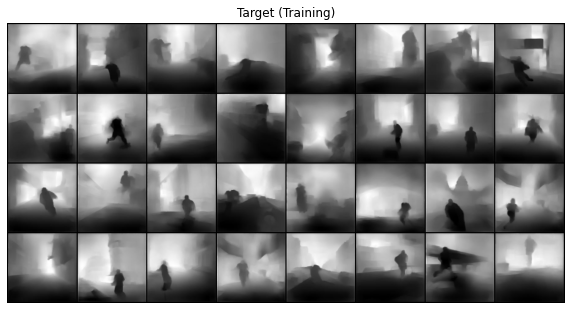

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


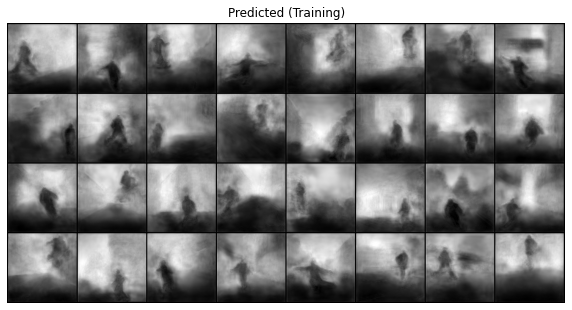

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.069627	Metric: 0.995723
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.070439	Metric: 1.012681
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.075748	Metric: 1.068903
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.069061	Metric: 0.987171
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.070550	Metric: 1.013913
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.069515	Metric: 1.016049
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.071804	Metric: 1.029901
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.070450	Metric: 1.005143
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.071008	Metric: 1.015193
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.071623	Metric: 1.008778
Batch ID:  1500


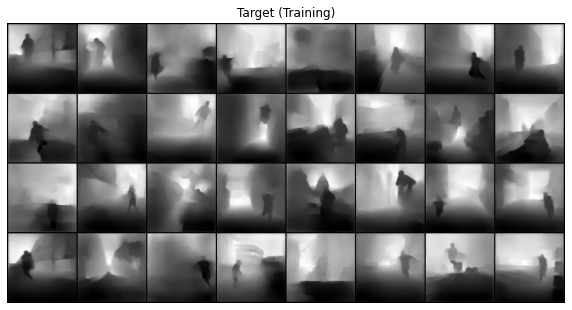

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


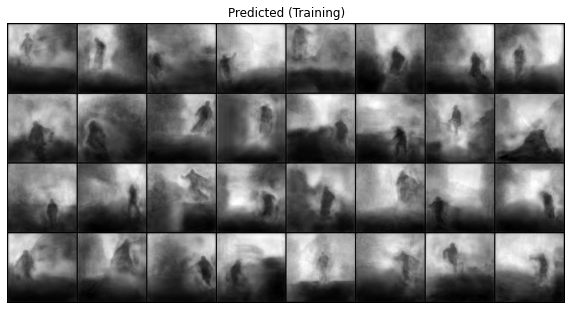

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.072957	Metric: 1.036060
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.073016	Metric: 1.049103
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.075655	Metric: 1.055736
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.068513	Metric: 0.973689
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.070877	Metric: 1.005096
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.071077	Metric: 1.027301
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.070779	Metric: 1.012855
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.070399	Metric: 1.020182
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.075099	Metric: 1.069487
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.071679	Metric: 1.038217
Batch ID:  2000


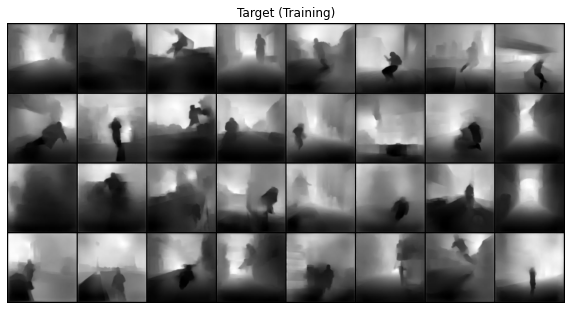

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


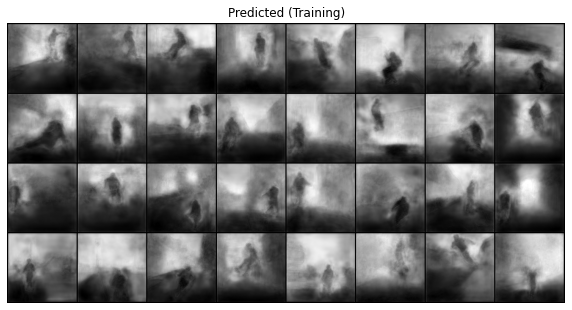

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.073672	Metric: 1.043267
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.066403	Metric: 0.960259
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.075363	Metric: 1.056856
Batch ID:  2150
Some target vs predicted samples:


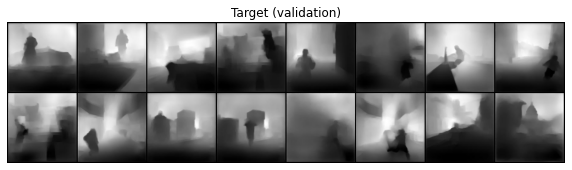

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


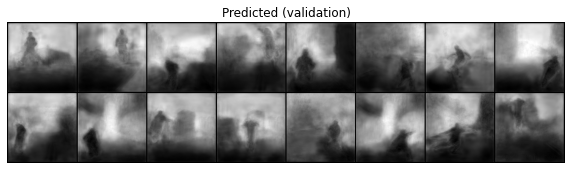

Average Validation loss: 0.07115134581732852	 Average Metric: 1.021756027997938
Train Epoch: 2 [0/280000 (0%)]	Loss: 0.071467	Metric: 1.029844
Batch ID:  0


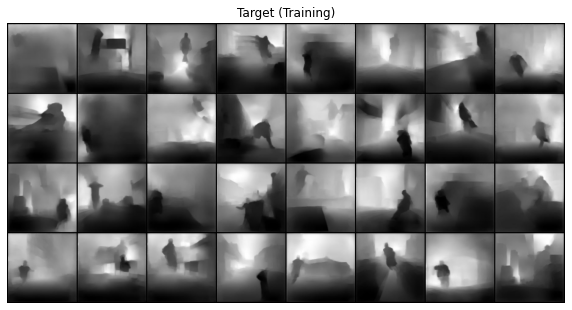

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


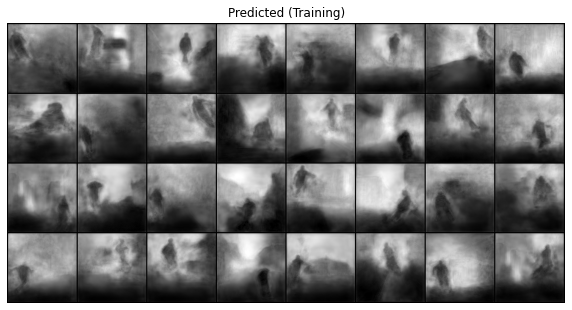

Train Epoch: 2 [6400/280000 (2%)]	Loss: 0.071335	Metric: 1.016456
Batch ID:  50
Train Epoch: 2 [12800/280000 (5%)]	Loss: 0.069894	Metric: 0.998135
Batch ID:  100
Train Epoch: 2 [19200/280000 (7%)]	Loss: 0.074147	Metric: 1.053026
Batch ID:  150
Train Epoch: 2 [25600/280000 (9%)]	Loss: 0.073344	Metric: 1.035147
Batch ID:  200
Train Epoch: 2 [32000/280000 (11%)]	Loss: 0.073882	Metric: 1.067752
Batch ID:  250
Train Epoch: 2 [38400/280000 (14%)]	Loss: 0.075299	Metric: 1.081992
Batch ID:  300
Train Epoch: 2 [44800/280000 (16%)]	Loss: 0.073252	Metric: 1.033231
Batch ID:  350
Train Epoch: 2 [51200/280000 (18%)]	Loss: 0.070688	Metric: 1.012195
Batch ID:  400
Train Epoch: 2 [57600/280000 (21%)]	Loss: 0.073021	Metric: 1.035523
Batch ID:  450
Train Epoch: 2 [64000/280000 (23%)]	Loss: 0.072218	Metric: 1.027539
Batch ID:  500


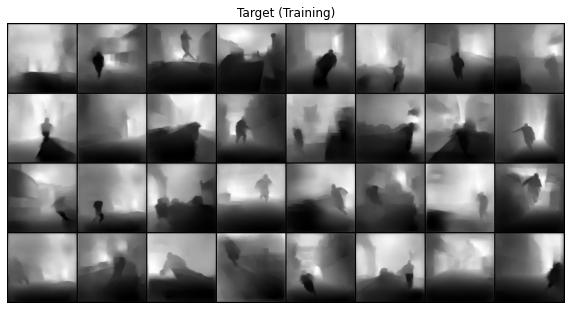

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


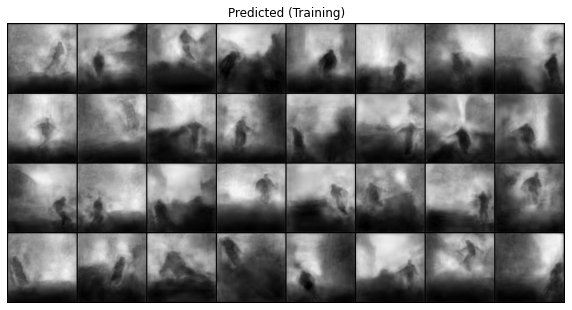

Train Epoch: 2 [70400/280000 (25%)]	Loss: 0.072134	Metric: 1.022890
Batch ID:  550
Train Epoch: 2 [76800/280000 (27%)]	Loss: 0.070618	Metric: 1.001528
Batch ID:  600
Train Epoch: 2 [83200/280000 (30%)]	Loss: 0.075394	Metric: 1.079217
Batch ID:  650
Train Epoch: 2 [89600/280000 (32%)]	Loss: 0.069939	Metric: 0.984008
Batch ID:  700
Train Epoch: 2 [96000/280000 (34%)]	Loss: 0.073176	Metric: 1.048036
Batch ID:  750
Train Epoch: 2 [102400/280000 (37%)]	Loss: 0.070470	Metric: 1.004913
Batch ID:  800
Train Epoch: 2 [108800/280000 (39%)]	Loss: 0.074130	Metric: 1.052214
Batch ID:  850
Train Epoch: 2 [115200/280000 (41%)]	Loss: 0.068787	Metric: 0.980636
Batch ID:  900
Train Epoch: 2 [121600/280000 (43%)]	Loss: 0.067865	Metric: 0.975516
Batch ID:  950
Train Epoch: 2 [128000/280000 (46%)]	Loss: 0.069262	Metric: 1.003907
Batch ID:  1000


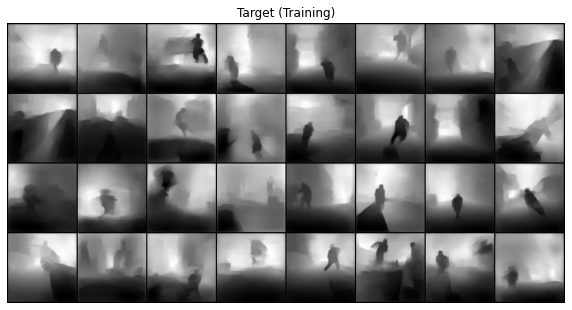

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


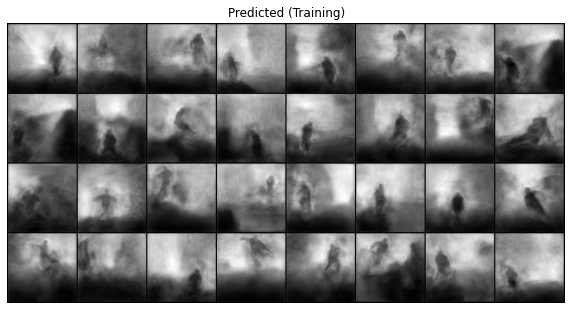

Train Epoch: 2 [134400/280000 (48%)]	Loss: 0.077363	Metric: 1.110977
Batch ID:  1050
Train Epoch: 2 [140800/280000 (50%)]	Loss: 0.073189	Metric: 1.045818
Batch ID:  1100
Train Epoch: 2 [147200/280000 (53%)]	Loss: 0.073807	Metric: 1.051362
Batch ID:  1150
Train Epoch: 2 [153600/280000 (55%)]	Loss: 0.073034	Metric: 1.050576
Batch ID:  1200
Train Epoch: 2 [160000/280000 (57%)]	Loss: 0.070397	Metric: 1.003632
Batch ID:  1250
Train Epoch: 2 [166400/280000 (59%)]	Loss: 0.075713	Metric: 1.065261
Batch ID:  1300
Train Epoch: 2 [172800/280000 (62%)]	Loss: 0.069530	Metric: 1.003542
Batch ID:  1350
Train Epoch: 2 [179200/280000 (64%)]	Loss: 0.070189	Metric: 1.007151
Batch ID:  1400
Train Epoch: 2 [185600/280000 (66%)]	Loss: 0.072443	Metric: 1.046627
Batch ID:  1450
Train Epoch: 2 [192000/280000 (69%)]	Loss: 0.071986	Metric: 1.024475
Batch ID:  1500


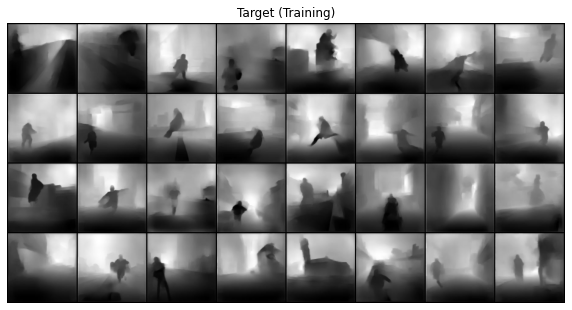

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


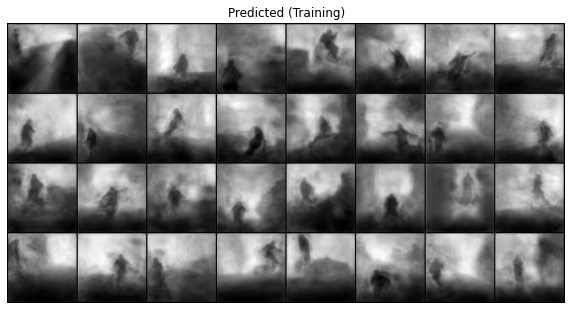

Train Epoch: 2 [198400/280000 (71%)]	Loss: 0.068741	Metric: 0.989122
Batch ID:  1550
Train Epoch: 2 [204800/280000 (73%)]	Loss: 0.072781	Metric: 1.057630
Batch ID:  1600
Train Epoch: 2 [211200/280000 (75%)]	Loss: 0.072630	Metric: 1.041830
Batch ID:  1650
Train Epoch: 2 [217600/280000 (78%)]	Loss: 0.069818	Metric: 0.995073
Batch ID:  1700
Train Epoch: 2 [224000/280000 (80%)]	Loss: 0.069616	Metric: 1.000831
Batch ID:  1750
Train Epoch: 2 [230400/280000 (82%)]	Loss: 0.067335	Metric: 0.970245
Batch ID:  1800
Train Epoch: 2 [236800/280000 (85%)]	Loss: 0.071227	Metric: 1.022147
Batch ID:  1850
Train Epoch: 2 [243200/280000 (87%)]	Loss: 0.074524	Metric: 1.055532
Batch ID:  1900
Train Epoch: 2 [249600/280000 (89%)]	Loss: 0.070314	Metric: 1.004822
Batch ID:  1950
Train Epoch: 2 [256000/280000 (91%)]	Loss: 0.072739	Metric: 1.043113
Batch ID:  2000


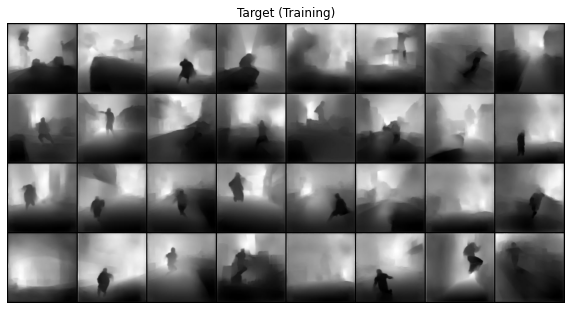

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


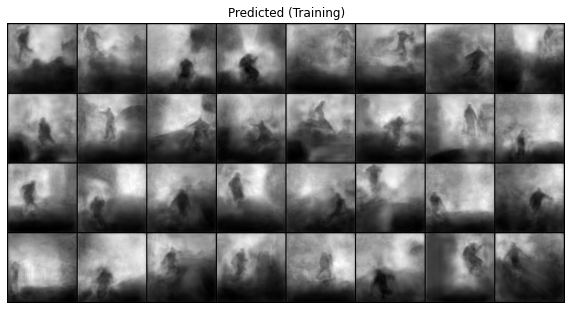

Train Epoch: 2 [262400/280000 (94%)]	Loss: 0.070116	Metric: 1.017346
Batch ID:  2050
Train Epoch: 2 [268800/280000 (96%)]	Loss: 0.071123	Metric: 1.029258
Batch ID:  2100
Train Epoch: 2 [275200/280000 (98%)]	Loss: 0.070380	Metric: 1.014470
Batch ID:  2150
Some target vs predicted samples:


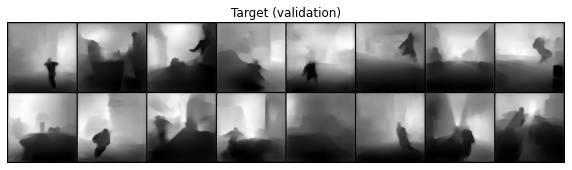

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


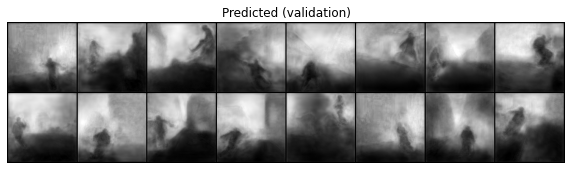

Average Validation loss: 0.07115576719678542	 Average Metric: 1.0222488292244707
--- 3466.5199496746063 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.00001, epochs=2)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_depth_l1_e12.pth")

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.107200	Metric: 1.506022
Batch ID:  0


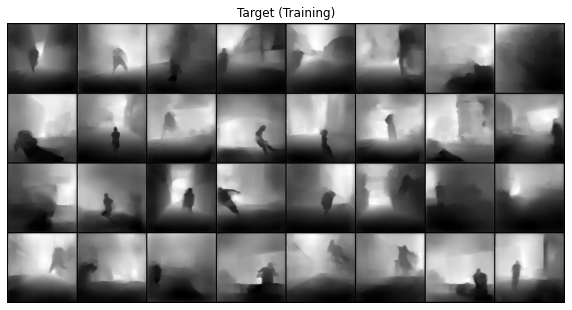

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


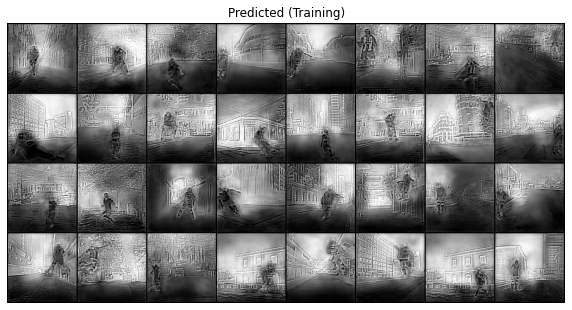

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.074846	Metric: 1.052611
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.075849	Metric: 1.071868
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.074947	Metric: 1.055841
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.070239	Metric: 0.987268
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.077536	Metric: 1.072377
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.074558	Metric: 1.051510
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.068270	Metric: 0.978126
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.078058	Metric: 1.095002
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.071544	Metric: 1.007640
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.074298	Metric: 1.060830
Batch ID:  500


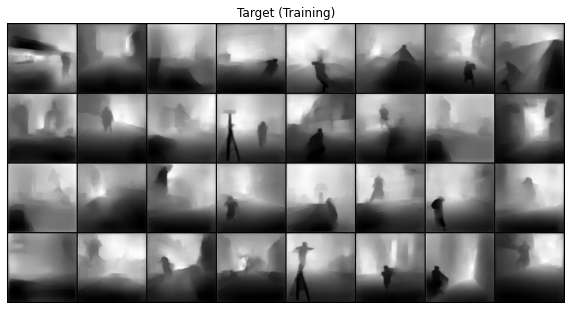

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


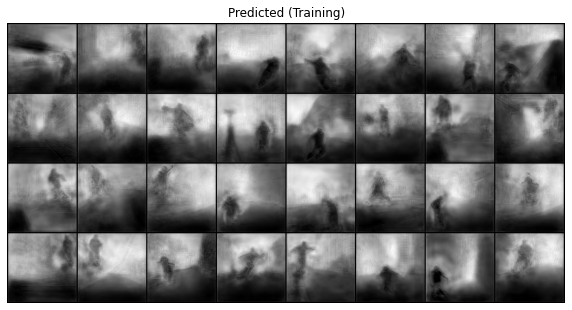

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.072404	Metric: 1.021143
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.068903	Metric: 0.987261
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.074825	Metric: 1.034039
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.068814	Metric: 0.990469
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.070304	Metric: 1.000240
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.073054	Metric: 1.029278
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.073957	Metric: 1.032800
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.073601	Metric: 1.055335
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.069656	Metric: 0.994691
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.074184	Metric: 1.054710
Batch ID:  1000


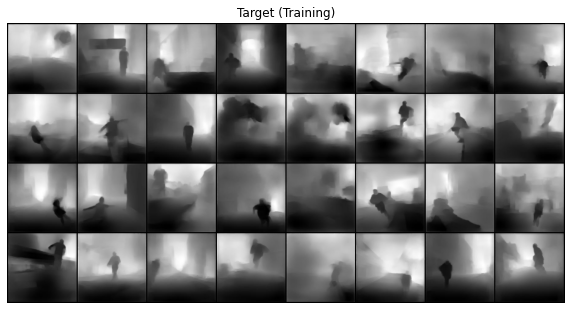

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


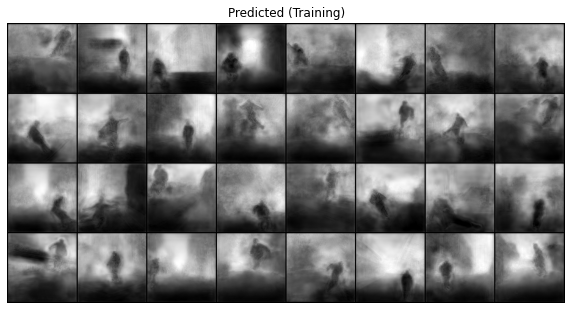

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.070564	Metric: 1.001947
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.073962	Metric: 1.053941
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.069085	Metric: 0.976594
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.073641	Metric: 1.053273
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.072310	Metric: 1.046036
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.074294	Metric: 1.072339
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.068813	Metric: 0.978636
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.072631	Metric: 1.029433
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.074677	Metric: 1.078629
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.073943	Metric: 1.045072
Batch ID:  1500


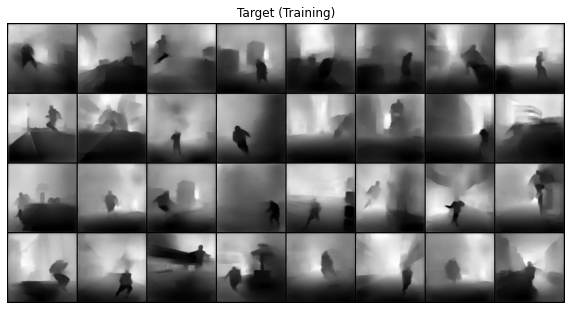

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


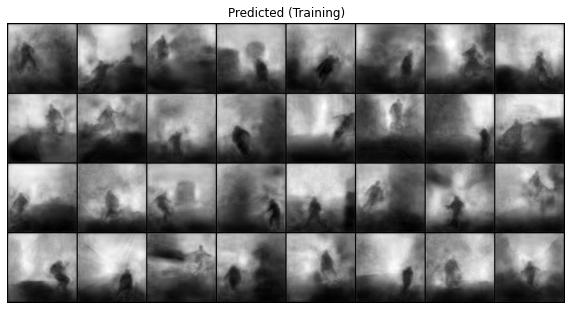

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.073490	Metric: 1.040901
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.076033	Metric: 1.048591
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.072942	Metric: 1.043035
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.072034	Metric: 1.013310
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.074298	Metric: 1.060047
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.070848	Metric: 1.008271
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.074343	Metric: 1.041167
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.073751	Metric: 1.046774
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.070903	Metric: 1.012107
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.073722	Metric: 1.050085
Batch ID:  2000


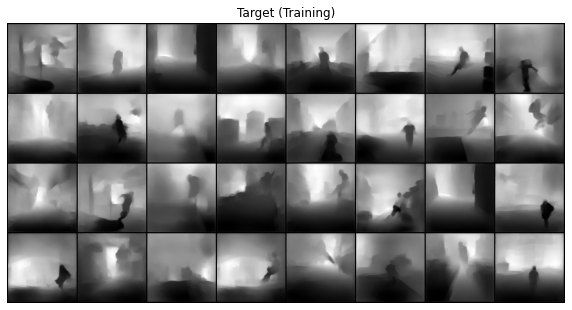

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


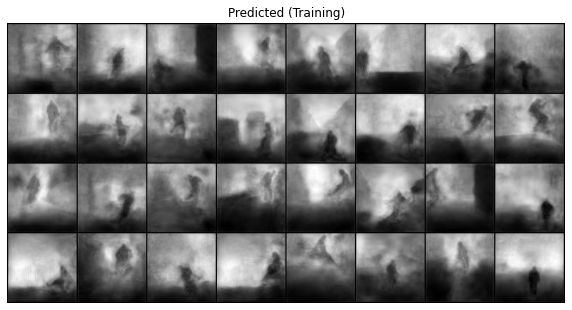

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.066295	Metric: 0.955693
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.071330	Metric: 1.010413
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.071958	Metric: 1.030261
Batch ID:  2150
Some target vs predicted samples:


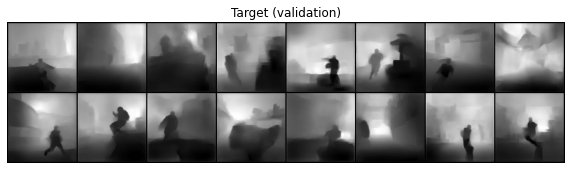

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


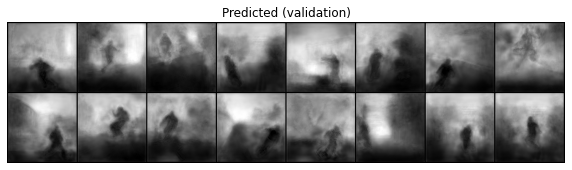

Average Validation loss: 0.07119278731281316	 Average Metric: 1.0212025403468086
--- 2499.494285106659 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.073206	Metric: 1.027596
Batch ID:  0


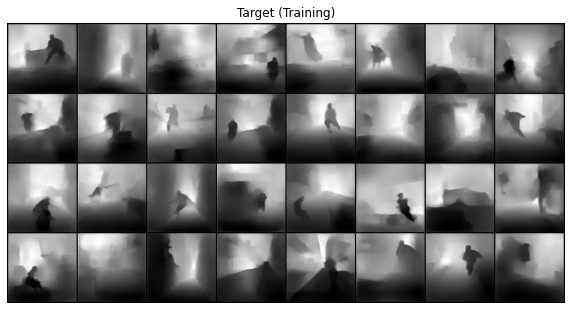

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


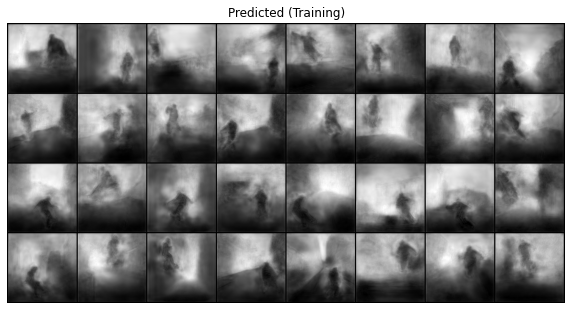

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.069753	Metric: 0.993255
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.068059	Metric: 0.974695
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.072863	Metric: 1.054903
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.072663	Metric: 1.040503
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.070652	Metric: 1.011355
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.068527	Metric: 0.998201
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.076265	Metric: 1.039020
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.068257	Metric: 0.971339
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.072483	Metric: 1.036563
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.069367	Metric: 0.998178
Batch ID:  500


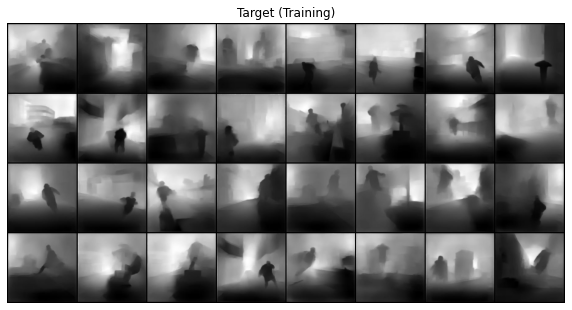

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


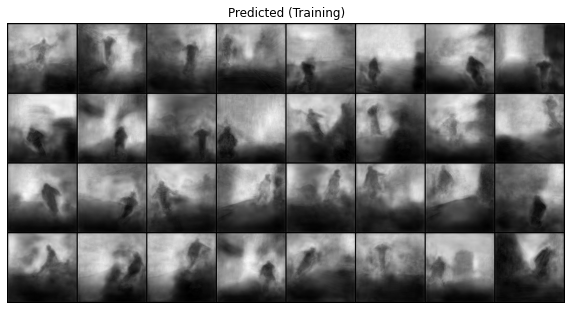

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.073904	Metric: 1.053207
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.072674	Metric: 1.025592
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.071322	Metric: 1.014564
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.069121	Metric: 0.994860
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.077497	Metric: 1.080347
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.071586	Metric: 1.009586
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.066385	Metric: 0.943576
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.074334	Metric: 1.063506
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.071553	Metric: 1.006210
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.069441	Metric: 0.985996
Batch ID:  1000


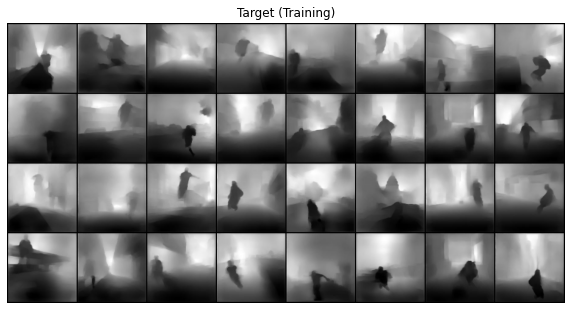

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


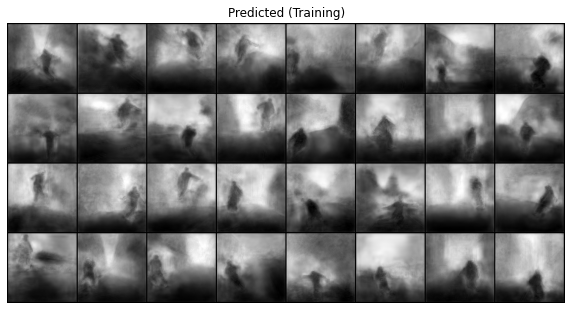

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.067430	Metric: 0.972344
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.071778	Metric: 1.036498
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.069602	Metric: 1.002962
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.067725	Metric: 0.984393
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.072304	Metric: 1.023750
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.068687	Metric: 0.985871
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.067592	Metric: 0.963067
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.071855	Metric: 1.020646
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.070975	Metric: 0.989712
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.069650	Metric: 1.002460
Batch ID:  1500


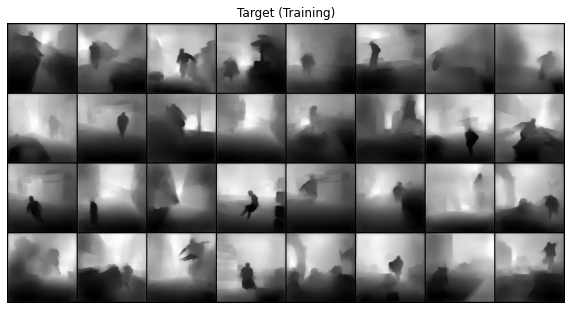

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


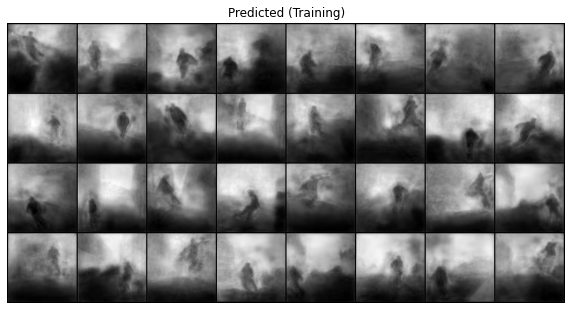

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.070292	Metric: 0.994681
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.071472	Metric: 1.015825
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.074774	Metric: 1.064282
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.071506	Metric: 0.994974
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.073555	Metric: 1.072276
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.072093	Metric: 1.024640
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.071012	Metric: 1.012274
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.068960	Metric: 0.987253
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.072591	Metric: 1.053194
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.069464	Metric: 0.998010
Batch ID:  2000


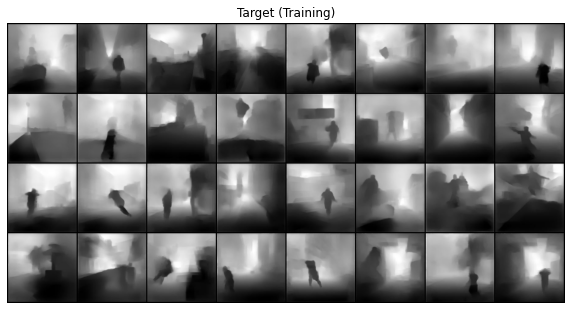

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


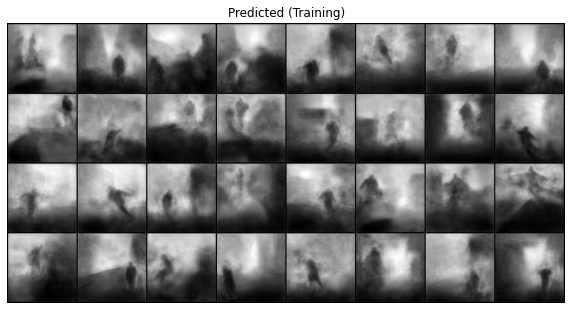

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.069901	Metric: 0.987136
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.072153	Metric: 1.021822
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.070271	Metric: 1.005126
Batch ID:  2150
Some target vs predicted samples:


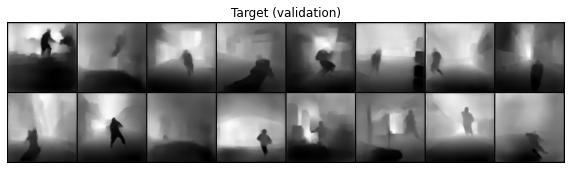

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


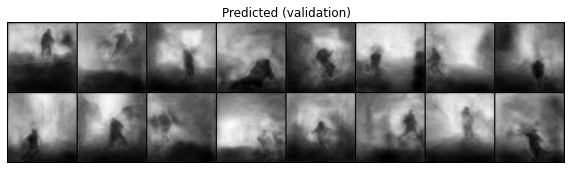

Average Validation loss: 0.0700269685402862	 Average Metric: 1.0073008542376032
Train Epoch: 2 [0/280000 (0%)]	Loss: 0.067236	Metric: 0.963069
Batch ID:  0


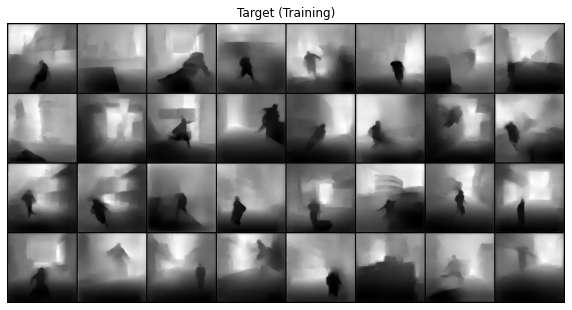

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


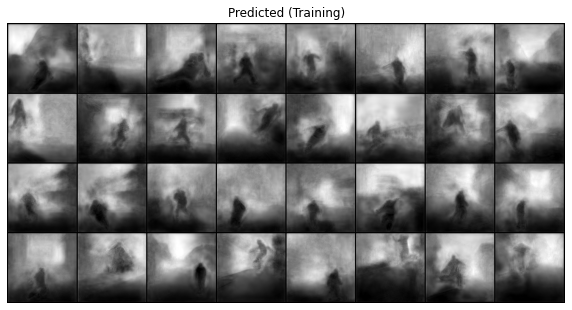

Train Epoch: 2 [6400/280000 (2%)]	Loss: 0.071440	Metric: 1.014443
Batch ID:  50
Train Epoch: 2 [12800/280000 (5%)]	Loss: 0.075196	Metric: 1.066905
Batch ID:  100
Train Epoch: 2 [19200/280000 (7%)]	Loss: 0.069309	Metric: 0.997970
Batch ID:  150
Train Epoch: 2 [25600/280000 (9%)]	Loss: 0.066971	Metric: 0.973607
Batch ID:  200
Train Epoch: 2 [32000/280000 (11%)]	Loss: 0.072072	Metric: 1.028733
Batch ID:  250
Train Epoch: 2 [38400/280000 (14%)]	Loss: 0.069331	Metric: 0.984409
Batch ID:  300
Train Epoch: 2 [44800/280000 (16%)]	Loss: 0.067280	Metric: 0.963344
Batch ID:  350
Train Epoch: 2 [51200/280000 (18%)]	Loss: 0.068307	Metric: 0.982480
Batch ID:  400
Train Epoch: 2 [57600/280000 (21%)]	Loss: 0.073363	Metric: 1.037943
Batch ID:  450
Train Epoch: 2 [64000/280000 (23%)]	Loss: 0.069915	Metric: 0.978520
Batch ID:  500


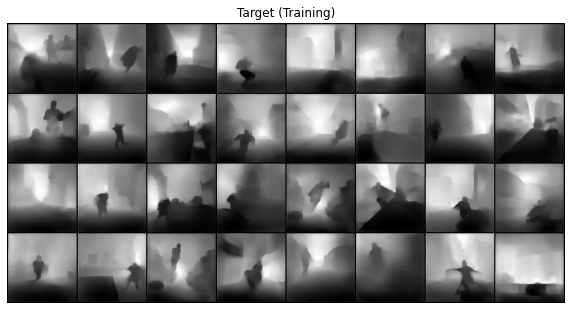

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


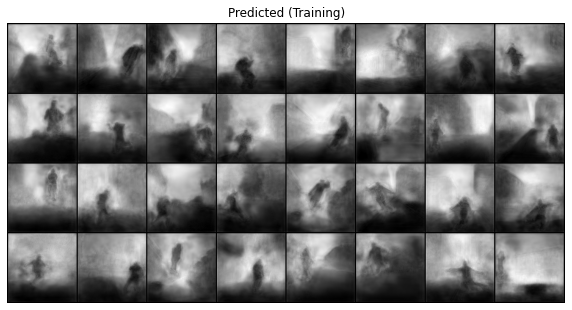

Train Epoch: 2 [70400/280000 (25%)]	Loss: 0.072112	Metric: 1.007296
Batch ID:  550
Train Epoch: 2 [76800/280000 (27%)]	Loss: 0.070661	Metric: 1.016130
Batch ID:  600
Train Epoch: 2 [83200/280000 (30%)]	Loss: 0.067714	Metric: 0.968162
Batch ID:  650
Train Epoch: 2 [89600/280000 (32%)]	Loss: 0.072381	Metric: 1.033941
Batch ID:  700
Train Epoch: 2 [96000/280000 (34%)]	Loss: 0.071801	Metric: 1.042002
Batch ID:  750
Train Epoch: 2 [102400/280000 (37%)]	Loss: 0.071563	Metric: 1.005689
Batch ID:  800
Train Epoch: 2 [108800/280000 (39%)]	Loss: 0.068933	Metric: 0.992798
Batch ID:  850
Train Epoch: 2 [115200/280000 (41%)]	Loss: 0.073237	Metric: 1.048808
Batch ID:  900
Train Epoch: 2 [121600/280000 (43%)]	Loss: 0.072811	Metric: 1.018988
Batch ID:  950
Train Epoch: 2 [128000/280000 (46%)]	Loss: 0.073965	Metric: 1.061661
Batch ID:  1000


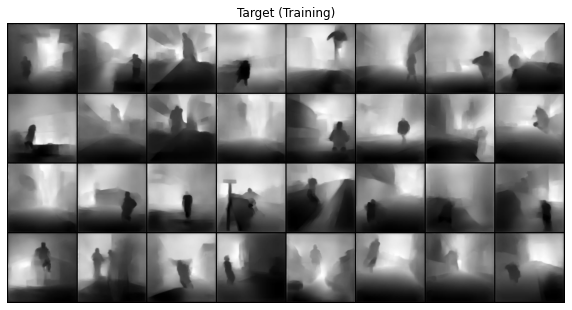

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


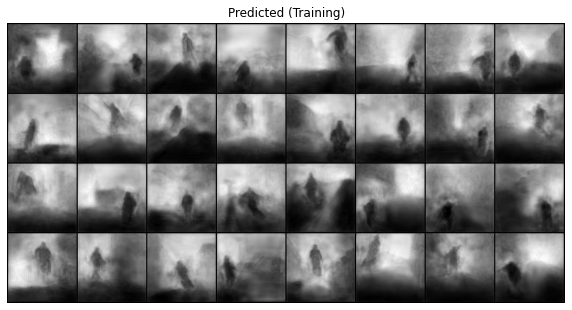

Train Epoch: 2 [134400/280000 (48%)]	Loss: 0.071161	Metric: 1.019377
Batch ID:  1050
Train Epoch: 2 [140800/280000 (50%)]	Loss: 0.072760	Metric: 1.043673
Batch ID:  1100
Train Epoch: 2 [147200/280000 (53%)]	Loss: 0.068870	Metric: 0.977118
Batch ID:  1150
Train Epoch: 2 [153600/280000 (55%)]	Loss: 0.068237	Metric: 0.961454
Batch ID:  1200
Train Epoch: 2 [160000/280000 (57%)]	Loss: 0.074516	Metric: 1.045913
Batch ID:  1250
Train Epoch: 2 [166400/280000 (59%)]	Loss: 0.073011	Metric: 1.058057
Batch ID:  1300
Train Epoch: 2 [172800/280000 (62%)]	Loss: 0.069338	Metric: 1.000932
Batch ID:  1350
Train Epoch: 2 [179200/280000 (64%)]	Loss: 0.067442	Metric: 0.971803
Batch ID:  1400
Train Epoch: 2 [185600/280000 (66%)]	Loss: 0.069259	Metric: 0.990497
Batch ID:  1450
Train Epoch: 2 [192000/280000 (69%)]	Loss: 0.072266	Metric: 1.038467
Batch ID:  1500


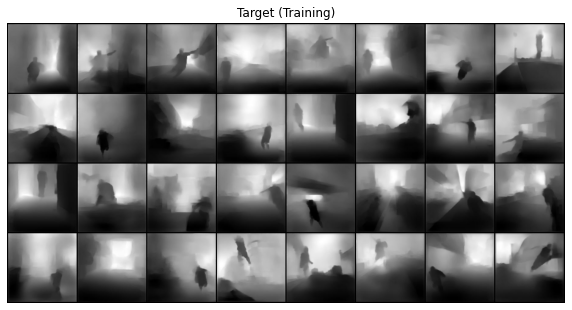

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


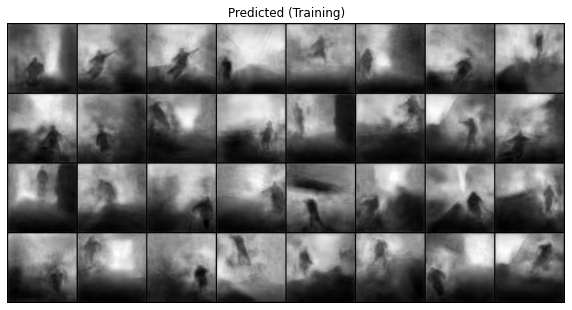

Train Epoch: 2 [198400/280000 (71%)]	Loss: 0.072685	Metric: 1.033134
Batch ID:  1550
Train Epoch: 2 [204800/280000 (73%)]	Loss: 0.070207	Metric: 1.005376
Batch ID:  1600
Train Epoch: 2 [211200/280000 (75%)]	Loss: 0.069551	Metric: 0.994114
Batch ID:  1650
Train Epoch: 2 [217600/280000 (78%)]	Loss: 0.069109	Metric: 0.982145
Batch ID:  1700
Train Epoch: 2 [224000/280000 (80%)]	Loss: 0.070825	Metric: 1.002611
Batch ID:  1750
Train Epoch: 2 [230400/280000 (82%)]	Loss: 0.067907	Metric: 0.972488
Batch ID:  1800
Train Epoch: 2 [236800/280000 (85%)]	Loss: 0.068488	Metric: 0.973262
Batch ID:  1850
Train Epoch: 2 [243200/280000 (87%)]	Loss: 0.071655	Metric: 1.024114
Batch ID:  1900
Train Epoch: 2 [249600/280000 (89%)]	Loss: 0.073155	Metric: 1.050782
Batch ID:  1950
Train Epoch: 2 [256000/280000 (91%)]	Loss: 0.071599	Metric: 1.006935
Batch ID:  2000


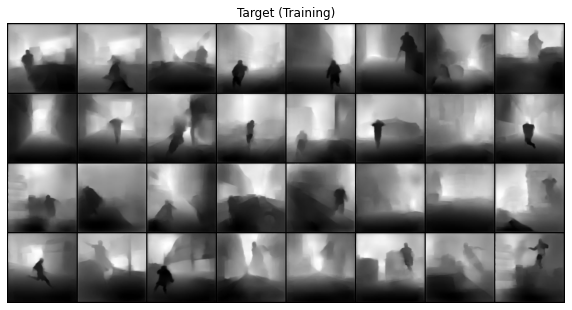

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


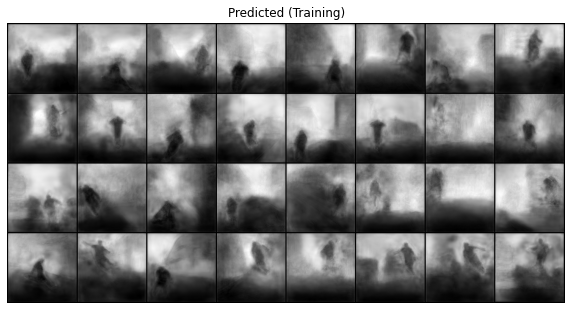

Train Epoch: 2 [262400/280000 (94%)]	Loss: 0.072086	Metric: 1.045793
Batch ID:  2050
Train Epoch: 2 [268800/280000 (96%)]	Loss: 0.072560	Metric: 1.044684
Batch ID:  2100
Train Epoch: 2 [275200/280000 (98%)]	Loss: 0.070528	Metric: 1.011194
Batch ID:  2150
Some target vs predicted samples:


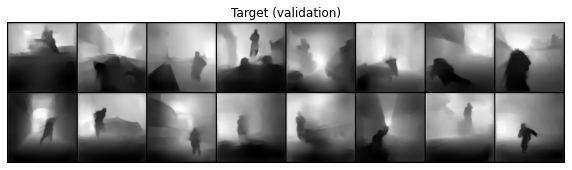

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


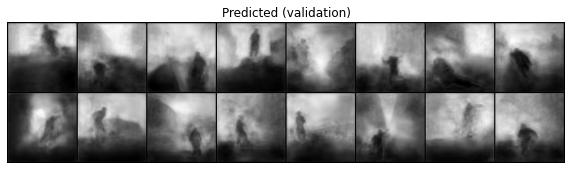

Average Validation loss: 0.07004614129884919	 Average Metric: 1.0069800113945373
--- 4970.921300649643 seconds -- -


In [0]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.0001, epochs=2)
print("--- %s seconds -- -" % (time.time() - start_time))

In [13]:
model.load_state_dict(torch.load("/content/drive/My Drive/unet_depth_l1_e15.pth"),  strict = False)

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.156893	Metric: 2.037259
Batch ID:  0


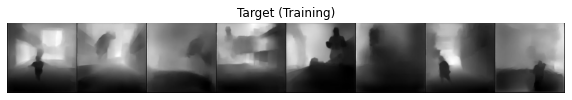

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


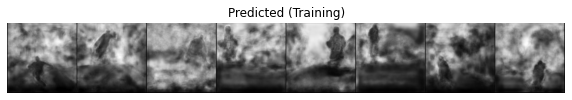

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.136646	Metric: 1.791979
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.135279	Metric: 1.792573
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.129208	Metric: 1.676945
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.137282	Metric: 1.806067
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.126166	Metric: 1.639002
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.117572	Metric: 1.543580
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.130460	Metric: 1.697532
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.124635	Metric: 1.634753
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.125650	Metric: 1.669205
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.110824	Metric: 1.462331
Batch ID:  500


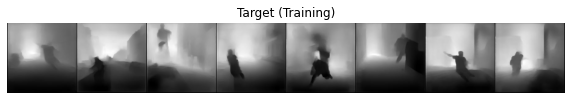

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


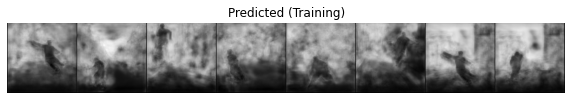

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.111409	Metric: 1.484143
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.116656	Metric: 1.557899
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.114031	Metric: 1.492516
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.120003	Metric: 1.568189
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.113368	Metric: 1.511190
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.109335	Metric: 1.450145
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.120265	Metric: 1.596628
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.126999	Metric: 1.638976
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.115365	Metric: 1.537860
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.110648	Metric: 1.457234
Batch ID:  1000


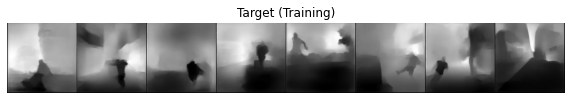

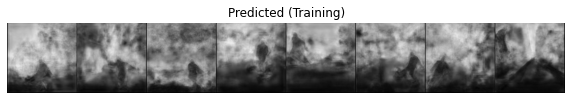

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.116761	Metric: 1.515693
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.110727	Metric: 1.476802
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.116973	Metric: 1.535899
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.106296	Metric: 1.414082
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.108419	Metric: 1.436259
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.107074	Metric: 1.418609
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.115656	Metric: 1.543281
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.107095	Metric: 1.417198
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.113082	Metric: 1.489678
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.106908	Metric: 1.414829
Batch ID:  1500


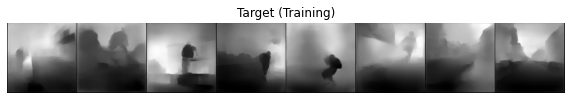

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


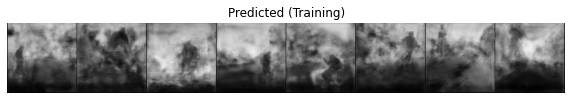

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.114164	Metric: 1.506008
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.111030	Metric: 1.465737
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.113944	Metric: 1.497643
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.106313	Metric: 1.432212
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.110950	Metric: 1.478894
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.100924	Metric: 1.349034
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.114427	Metric: 1.511467
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.103203	Metric: 1.363112
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.109113	Metric: 1.464801
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.106018	Metric: 1.408128
Batch ID:  2000


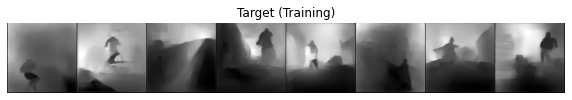

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


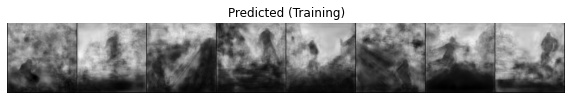

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.116046	Metric: 1.565751
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.108035	Metric: 1.430975
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.104141	Metric: 1.401178
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.103436	Metric: 1.379024
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.097301	Metric: 1.286824
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.103596	Metric: 1.380180
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.110242	Metric: 1.467647
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.105392	Metric: 1.407862
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.092021	Metric: 1.238181
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.102122	Metric: 1.376647
Batch ID:  2500


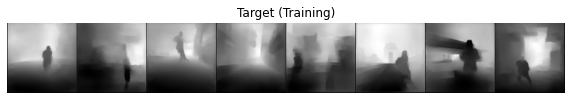

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


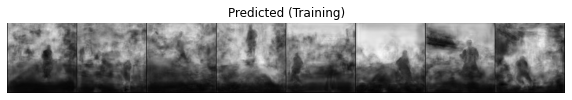

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.110121	Metric: 1.478170
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.101941	Metric: 1.348372
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.101314	Metric: 1.336314
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.105134	Metric: 1.405512
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.098472	Metric: 1.331474
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.090078	Metric: 1.199663
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.098628	Metric: 1.331450
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.102506	Metric: 1.367892
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.103840	Metric: 1.404893
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.100440	Metric: 1.353633
Batch ID:  3000


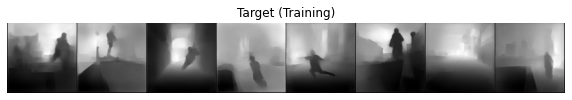

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


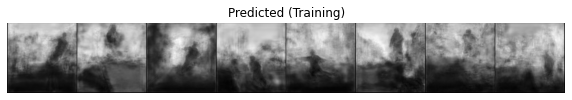

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.105335	Metric: 1.383417
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.101740	Metric: 1.364451
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.102740	Metric: 1.382056
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.096042	Metric: 1.285026
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.095229	Metric: 1.271729
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.094772	Metric: 1.288542
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.103423	Metric: 1.386506
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.097777	Metric: 1.296153
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.096399	Metric: 1.313995
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.101038	Metric: 1.324288
Batch ID:  3500


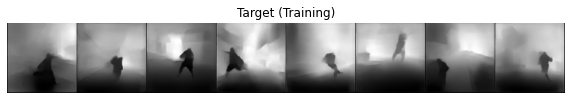

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


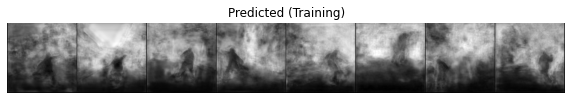

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.100003	Metric: 1.336446
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.099834	Metric: 1.335893
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.097554	Metric: 1.334392
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.095492	Metric: 1.279846
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.097175	Metric: 1.308269
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.094942	Metric: 1.274256
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.089996	Metric: 1.216289
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.096263	Metric: 1.311066
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.096757	Metric: 1.295352
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.102893	Metric: 1.401540
Batch ID:  4000


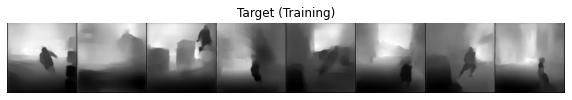

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


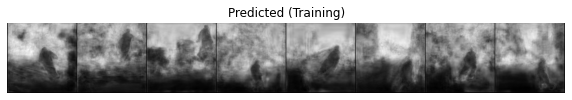

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.098063	Metric: 1.294399
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.099197	Metric: 1.352432
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.091176	Metric: 1.221943
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.090093	Metric: 1.199148
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.097391	Metric: 1.308022
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.091262	Metric: 1.237735
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.096134	Metric: 1.292161
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.092607	Metric: 1.268346
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.099595	Metric: 1.305762
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.090377	Metric: 1.210315
Batch ID:  4500


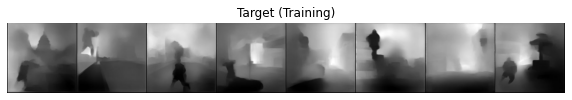

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


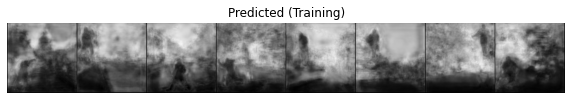

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.093391	Metric: 1.264366
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.089427	Metric: 1.228663
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.096574	Metric: 1.283561
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.098618	Metric: 1.323215
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.084876	Metric: 1.137891
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.103639	Metric: 1.403939
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.101978	Metric: 1.388337
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.105360	Metric: 1.420081
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.094548	Metric: 1.279895
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.093206	Metric: 1.241026
Batch ID:  5000


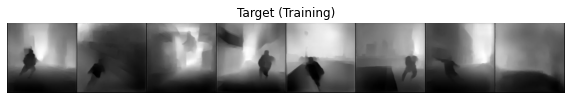

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


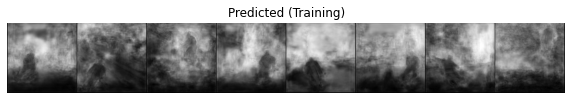

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.092952	Metric: 1.261734
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.090661	Metric: 1.225435
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.093135	Metric: 1.282453
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.093400	Metric: 1.253869
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.102317	Metric: 1.373687
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.107279	Metric: 1.430960
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.098221	Metric: 1.318136
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.091321	Metric: 1.257880
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.094798	Metric: 1.283285
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.098494	Metric: 1.332183
Batch ID:  5500


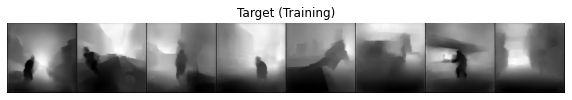

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


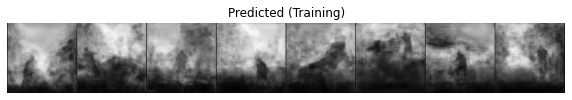

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.093121	Metric: 1.252494
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.091860	Metric: 1.239153
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.090752	Metric: 1.212716
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.089548	Metric: 1.201965
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.092430	Metric: 1.229717
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.092235	Metric: 1.248325
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.090284	Metric: 1.260285
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.087751	Metric: 1.186414
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.086227	Metric: 1.167218
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.094547	Metric: 1.263691
Batch ID:  6000


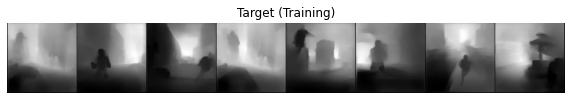

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


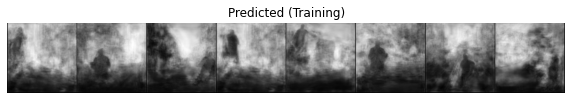

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.093391	Metric: 1.241011
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.088527	Metric: 1.185129
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.089182	Metric: 1.196272
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.094979	Metric: 1.297191
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.092595	Metric: 1.264248
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.085121	Metric: 1.155938
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.092656	Metric: 1.269802
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.096088	Metric: 1.295021
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.084411	Metric: 1.126948
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.093306	Metric: 1.259425
Batch ID:  6500


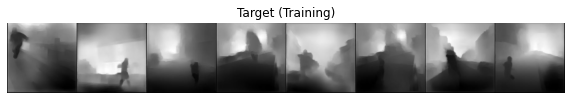

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


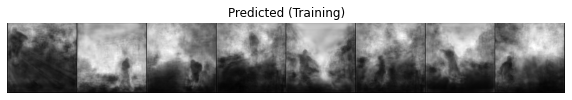

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.092403	Metric: 1.244330
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.089110	Metric: 1.224389
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.098368	Metric: 1.340519
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.090870	Metric: 1.229390
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.085751	Metric: 1.150259
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.082183	Metric: 1.122843
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.089020	Metric: 1.200879
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.097105	Metric: 1.300272
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.086225	Metric: 1.195052
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.091580	Metric: 1.249798
Batch ID:  7000


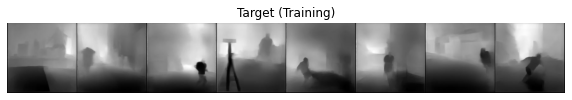

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


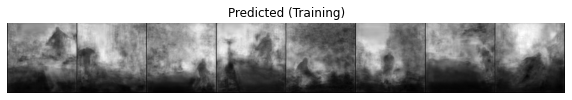

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.088432	Metric: 1.200674
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.089441	Metric: 1.225915
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.091659	Metric: 1.259834
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.097389	Metric: 1.354145
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.089892	Metric: 1.194055
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.091376	Metric: 1.222153
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.086428	Metric: 1.173477
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.091167	Metric: 1.226667
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.094059	Metric: 1.236295
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.083011	Metric: 1.121210
Batch ID:  7500


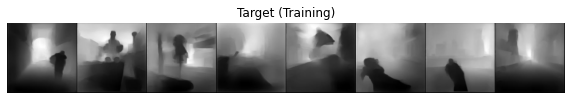

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


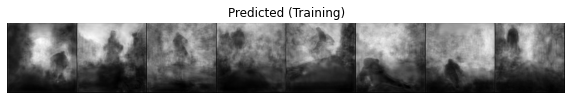

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.095079	Metric: 1.256891
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.095505	Metric: 1.284546
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.087110	Metric: 1.190128
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.085290	Metric: 1.164645
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.091065	Metric: 1.241736
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.091532	Metric: 1.240584
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.087381	Metric: 1.181668
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.091718	Metric: 1.237362
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.083960	Metric: 1.128985
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.090217	Metric: 1.214616
Batch ID:  8000


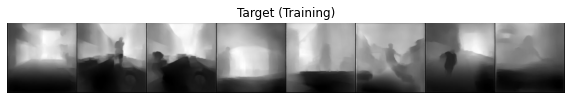

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


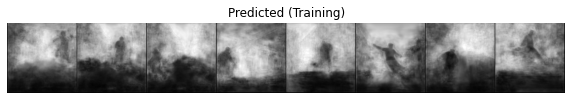

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.094793	Metric: 1.277477
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.105412	Metric: 1.408942
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.090473	Metric: 1.191840
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.088784	Metric: 1.220547
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.088778	Metric: 1.222436
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.100310	Metric: 1.370211
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.096211	Metric: 1.291164
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.088548	Metric: 1.234247
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.086828	Metric: 1.180442
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.083752	Metric: 1.159893
Batch ID:  8500


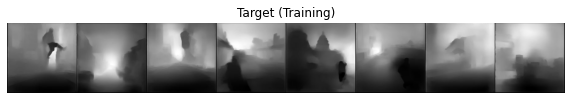

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


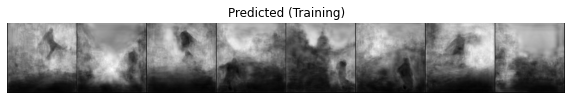

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.088459	Metric: 1.198547
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.083838	Metric: 1.136308
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.090460	Metric: 1.220707
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.084820	Metric: 1.143852
Batch ID:  8700
Some target vs predicted samples:


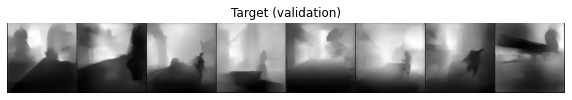

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


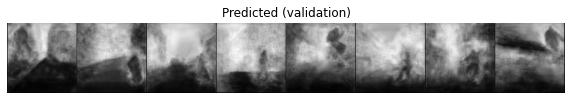

Average Validation loss: 0.08399288561344147	 Average Metric: 1.1591686438560487
--- 9482.8877825737 seconds -- -


In [14]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/unet_depth_l1_e1_224.pth")

In [17]:
model.load_state_dict(torch.load('/content/drive/My Drive/unet_depth_l1_e1_224.pth'),  strict = False)

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.097085	Metric: 1.343713
Batch ID:  0


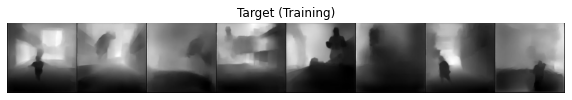

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


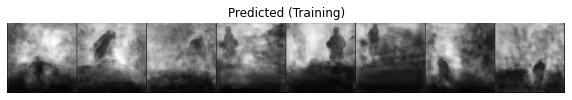

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.089466	Metric: 1.218754
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.088323	Metric: 1.197742
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.094915	Metric: 1.280410
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.094122	Metric: 1.310506
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.094883	Metric: 1.274544
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.081616	Metric: 1.114752
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.093682	Metric: 1.284123
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.086129	Metric: 1.186429
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.082412	Metric: 1.130567
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.081826	Metric: 1.124710
Batch ID:  500


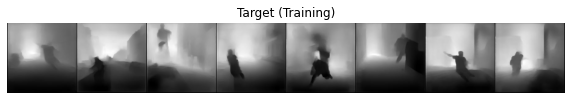

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


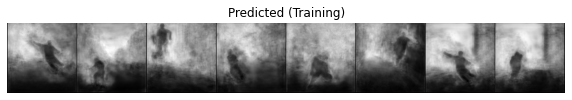

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.083227	Metric: 1.127850
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.084652	Metric: 1.224209
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.082521	Metric: 1.133685
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.087792	Metric: 1.163583
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.081897	Metric: 1.118947
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.077352	Metric: 1.084206
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.087171	Metric: 1.192475
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.103367	Metric: 1.372606
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.082248	Metric: 1.133086
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.083071	Metric: 1.121290
Batch ID:  1000


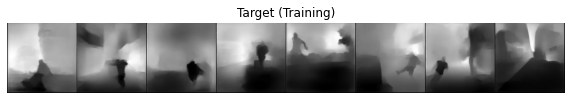

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


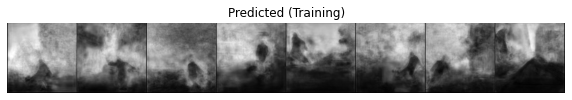

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.089406	Metric: 1.190655
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.082680	Metric: 1.166585
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.092077	Metric: 1.259232
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.079776	Metric: 1.108916
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.091080	Metric: 1.254083
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.081702	Metric: 1.125895
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.087808	Metric: 1.215136
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.085273	Metric: 1.162451
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.088431	Metric: 1.179777
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.089283	Metric: 1.231699
Batch ID:  1500


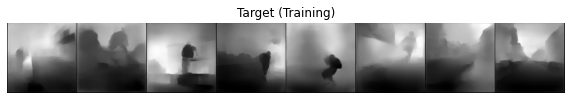

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


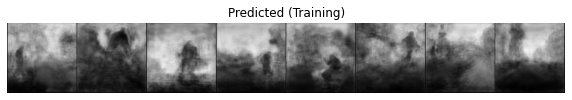

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.093299	Metric: 1.282261
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.090619	Metric: 1.214679
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.093001	Metric: 1.245860
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.084558	Metric: 1.179922
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.084568	Metric: 1.153577
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.080017	Metric: 1.120248
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.090524	Metric: 1.226378
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.086635	Metric: 1.172225
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.087271	Metric: 1.211486
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.084338	Metric: 1.141711
Batch ID:  2000


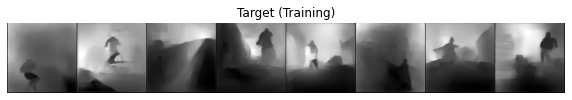

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


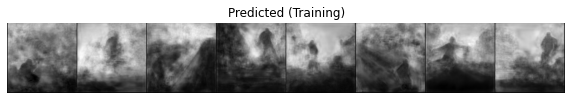

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.094042	Metric: 1.325692
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.090884	Metric: 1.241922
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.085184	Metric: 1.193864
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.085160	Metric: 1.159213
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.081160	Metric: 1.093898
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.087336	Metric: 1.184639
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.093773	Metric: 1.257135
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.090028	Metric: 1.226358
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.073563	Metric: 1.029970
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.086064	Metric: 1.198965
Batch ID:  2500


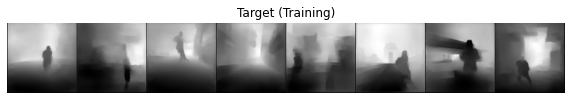

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


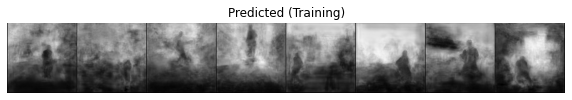

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.092985	Metric: 1.277427
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.083402	Metric: 1.147576
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.083244	Metric: 1.126539
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.086568	Metric: 1.176168
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.083948	Metric: 1.164323
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.074577	Metric: 1.034548
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.083558	Metric: 1.135025
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.088236	Metric: 1.201643
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.091023	Metric: 1.241834
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.085006	Metric: 1.174588
Batch ID:  3000


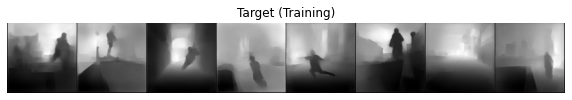

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


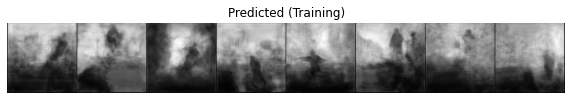

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.089284	Metric: 1.200016
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.086925	Metric: 1.203451
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.082931	Metric: 1.143959
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.080561	Metric: 1.108119
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.082026	Metric: 1.124589
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.081728	Metric: 1.141872
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.091348	Metric: 1.256152
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.086158	Metric: 1.175125
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.087585	Metric: 1.217727
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.089641	Metric: 1.199587
Batch ID:  3500


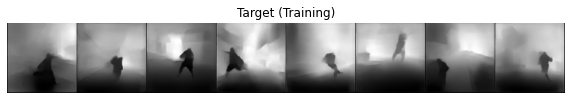

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


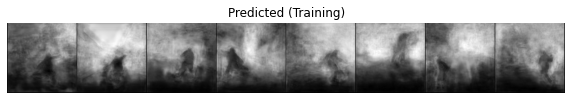

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.087226	Metric: 1.202521
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.086770	Metric: 1.175575
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.082669	Metric: 1.160269
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.080476	Metric: 1.106170
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.081194	Metric: 1.116285
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.080410	Metric: 1.122202
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.078894	Metric: 1.099838
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.083183	Metric: 1.163365
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.083992	Metric: 1.148438
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.090709	Metric: 1.266502
Batch ID:  4000


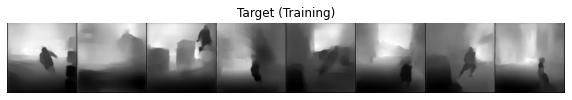

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


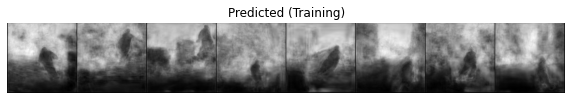

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.085775	Metric: 1.160741
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.084475	Metric: 1.188572
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.078448	Metric: 1.072399
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.076882	Metric: 1.053162
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.085769	Metric: 1.183413
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.077855	Metric: 1.087332
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.085027	Metric: 1.170484
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.080062	Metric: 1.116233
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.085930	Metric: 1.141083
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.081146	Metric: 1.106934
Batch ID:  4500


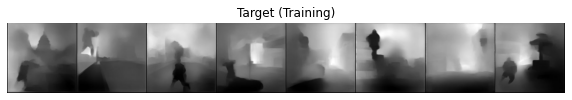

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


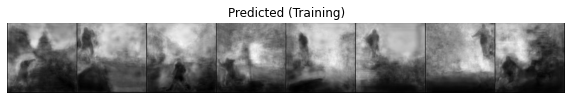

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.082436	Metric: 1.147879
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.078749	Metric: 1.113251
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.086018	Metric: 1.155141
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.088257	Metric: 1.191697
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.075323	Metric: 1.019053
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.087315	Metric: 1.205037
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.094448	Metric: 1.309376
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.091988	Metric: 1.253792
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.083442	Metric: 1.145318
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.084478	Metric: 1.139467
Batch ID:  5000


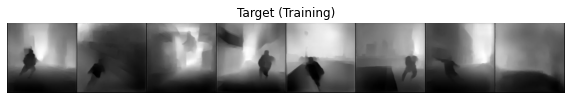

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


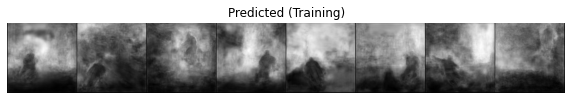

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.083718	Metric: 1.170414
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.081861	Metric: 1.131855
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.084885	Metric: 1.203952
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.084429	Metric: 1.158653
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.093225	Metric: 1.258412
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.097542	Metric: 1.324162
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.089382	Metric: 1.218166
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.082515	Metric: 1.161833
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.083846	Metric: 1.154758
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.087639	Metric: 1.213821
Batch ID:  5500


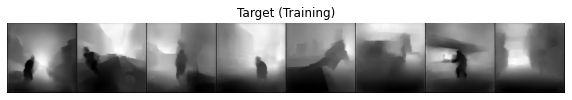

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


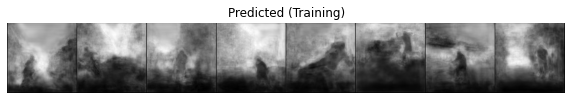

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.084538	Metric: 1.160680
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.083894	Metric: 1.158798
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.082106	Metric: 1.112841
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.081926	Metric: 1.122319
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.085476	Metric: 1.154136
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.084017	Metric: 1.151765
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.081707	Metric: 1.171104
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.078567	Metric: 1.091238
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.077305	Metric: 1.069985
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.085643	Metric: 1.158892
Batch ID:  6000


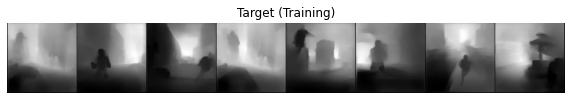

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


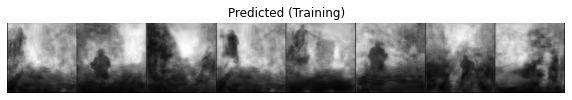

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.085574	Metric: 1.156600
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.081203	Metric: 1.104601
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.082214	Metric: 1.111083
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.086986	Metric: 1.210212
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.084081	Metric: 1.170139
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.077241	Metric: 1.061889
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.084323	Metric: 1.170479
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.090545	Metric: 1.232915
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.077322	Metric: 1.049774
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.087582	Metric: 1.199614
Batch ID:  6500


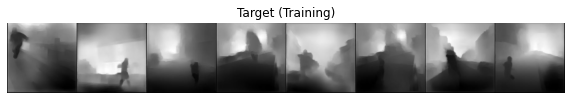

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


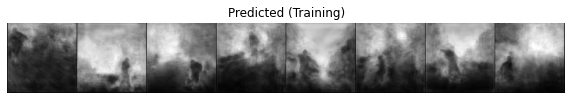

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.083998	Metric: 1.146309
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.081063	Metric: 1.133214
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.093017	Metric: 1.286737
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.082870	Metric: 1.143810
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.076365	Metric: 1.038501
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.075327	Metric: 1.047917
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.082647	Metric: 1.126897
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.089970	Metric: 1.218060
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.078979	Metric: 1.115273
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.086523	Metric: 1.198729
Batch ID:  7000


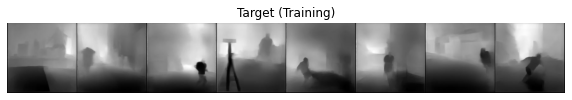

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


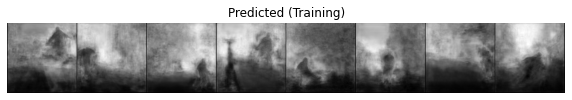

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.082352	Metric: 1.140302
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.082772	Metric: 1.151231
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.081997	Metric: 1.154370
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.092639	Metric: 1.310702
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.082416	Metric: 1.110258
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.086156	Metric: 1.167671
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.077717	Metric: 1.068387
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.083527	Metric: 1.140336
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.086707	Metric: 1.151760
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.077968	Metric: 1.067546
Batch ID:  7500


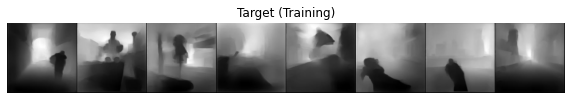

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


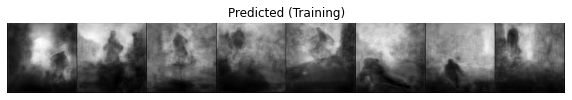

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.089032	Metric: 1.190711
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.088145	Metric: 1.207477
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.079675	Metric: 1.113756
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.080491	Metric: 1.114597
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.084043	Metric: 1.159572
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.084188	Metric: 1.162448
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.080857	Metric: 1.121771
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.085660	Metric: 1.171562
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.078330	Metric: 1.073288
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.086508	Metric: 1.171683
Batch ID:  8000


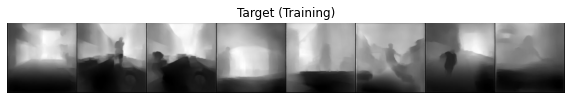

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


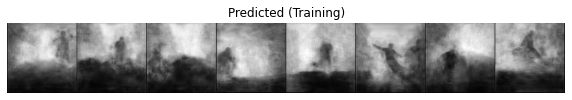

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.090187	Metric: 1.230363
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.099932	Metric: 1.348543
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.083982	Metric: 1.119541
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.081333	Metric: 1.144985
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.083354	Metric: 1.166248
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.093292	Metric: 1.293988
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.089206	Metric: 1.214667
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.084403	Metric: 1.189686
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.080425	Metric: 1.105385
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.077844	Metric: 1.098169
Batch ID:  8500


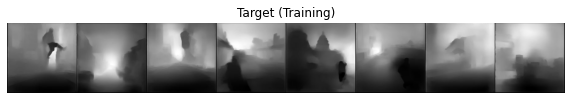

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


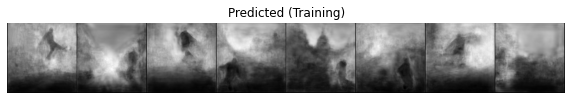

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.082412	Metric: 1.137165
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.077579	Metric: 1.072646
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.085522	Metric: 1.162903
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.079780	Metric: 1.090589
Batch ID:  8700
Some target vs predicted samples:


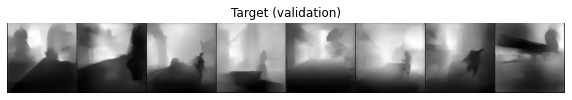

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


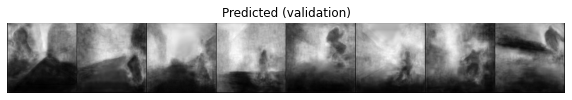

Average Validation loss: 0.07897883005340894	 Average Metric: 1.1090745582739512
--- 3879.7223851680756 seconds -- -


In [14]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

## Final Training

In [0]:
from losses import RMSE

In [21]:
model.load_state_dict(torch.load('/content/drive/My Drive/model1.pth'))

<All keys matched successfully>

In [0]:
metric = RMSE()
criterion = nn.L1Loss()

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.061641	Metric: 0.872413
Batch ID:  0


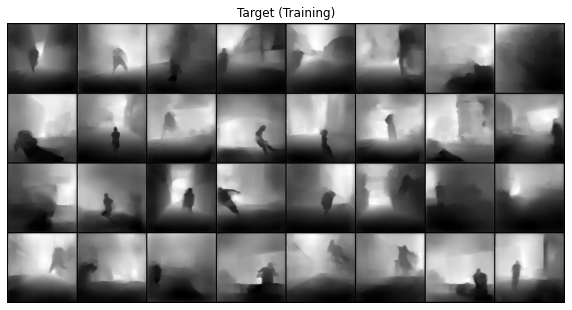

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


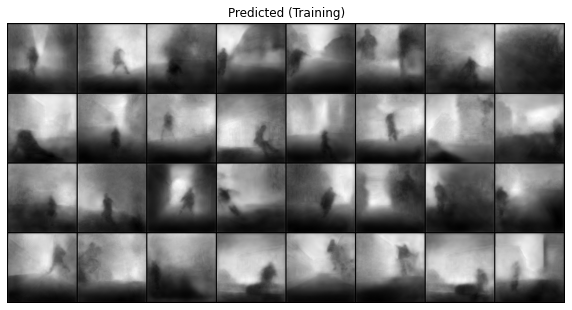

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.058179	Metric: 0.820717
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.055844	Metric: 0.798704
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.058449	Metric: 0.832962
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.054093	Metric: 0.775223
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.061329	Metric: 0.867332
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.058890	Metric: 0.827652
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.053539	Metric: 0.777500
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.062653	Metric: 0.884701
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.059408	Metric: 0.854730
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.057840	Metric: 0.814106
Batch ID:  500


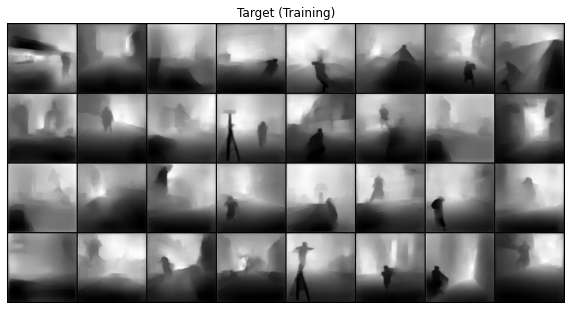

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


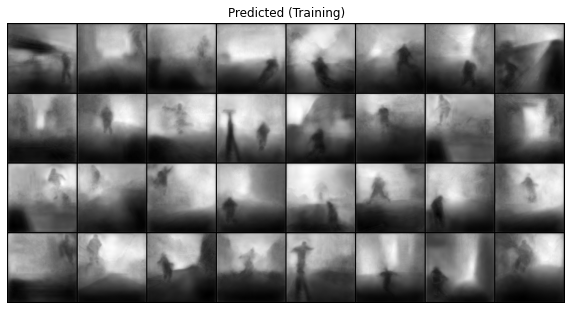

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.058749	Metric: 0.832641
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.059071	Metric: 0.838740
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.061573	Metric: 0.854042
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.054277	Metric: 0.770133
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.053951	Metric: 0.769478
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.057584	Metric: 0.814632
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.058551	Metric: 0.823539
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.059093	Metric: 0.847857
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.055768	Metric: 0.791067
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.060094	Metric: 0.856968
Batch ID:  1000


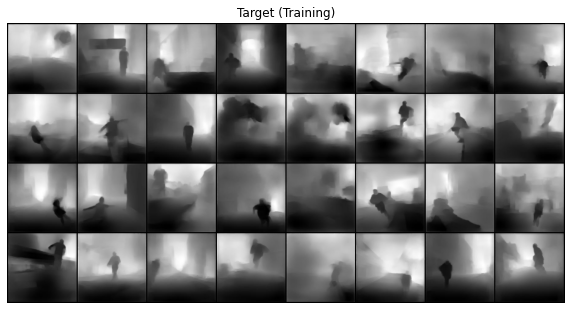

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


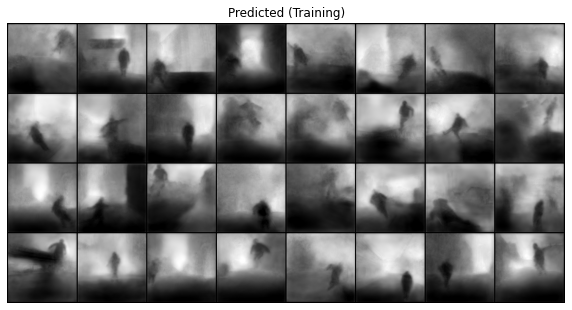

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.062111	Metric: 0.868934
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.058565	Metric: 0.839495
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.055988	Metric: 0.777259
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.057817	Metric: 0.833802
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.056116	Metric: 0.804301
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.057454	Metric: 0.842714
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.058732	Metric: 0.810797
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.060812	Metric: 0.858076
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.059564	Metric: 0.855337
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.059820	Metric: 0.834205
Batch ID:  1500


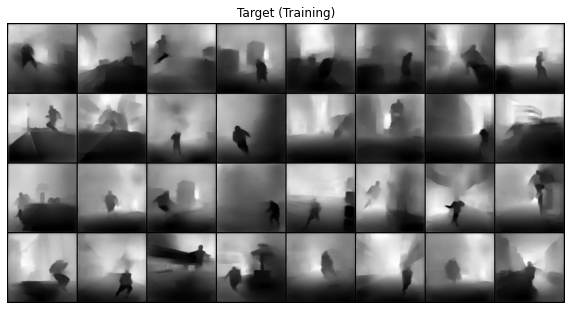

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


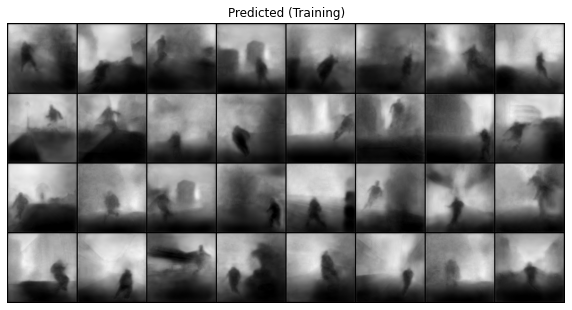

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.055055	Metric: 0.776907
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.060806	Metric: 0.834364
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.056590	Metric: 0.794629
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.055488	Metric: 0.788527
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.058721	Metric: 0.827705
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.058606	Metric: 0.843535
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.054490	Metric: 0.777296
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.060226	Metric: 0.857547
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.054652	Metric: 0.776933
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.060837	Metric: 0.865900
Batch ID:  2000


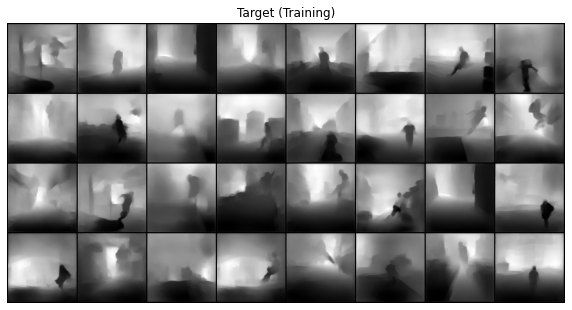

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


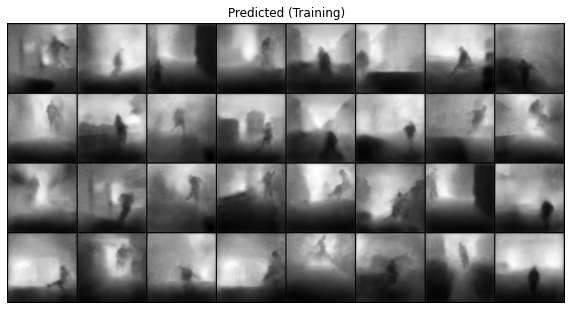

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.053709	Metric: 0.765001
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.058000	Metric: 0.838304
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.057679	Metric: 0.818998
Batch ID:  2150
--- 1258.0712027549744 seconds -- -


In [31]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.01, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.058276	Metric: 0.832225
Batch ID:  0


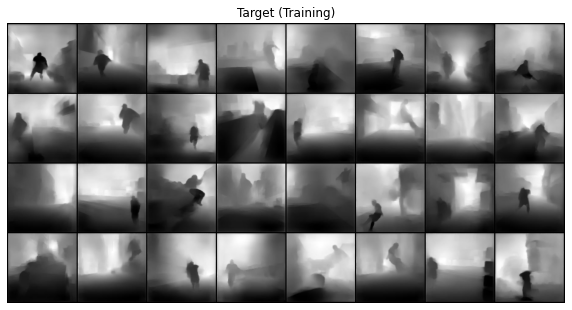

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


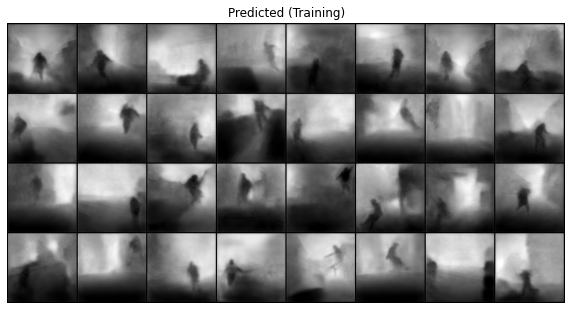

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.052921	Metric: 0.759345
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.055189	Metric: 0.791152
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.049352	Metric: 0.699646
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.051421	Metric: 0.768119
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.052148	Metric: 0.754860
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.051114	Metric: 0.740907
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.049697	Metric: 0.722381
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.054571	Metric: 0.768115
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.050319	Metric: 0.728432
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.049886	Metric: 0.706219
Batch ID:  500


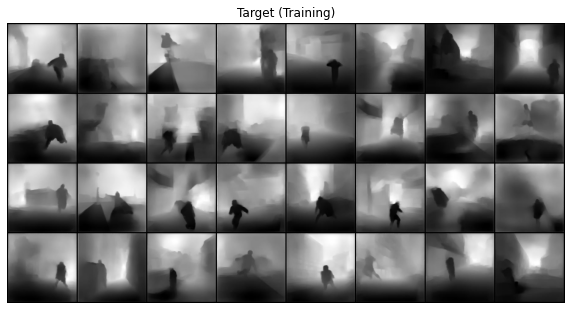

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


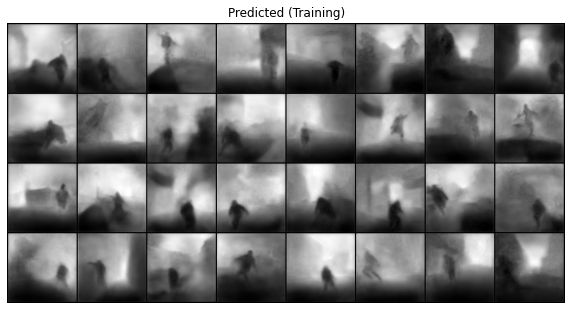

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.058024	Metric: 0.813584
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.054933	Metric: 0.781871
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.056191	Metric: 0.811834
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.053546	Metric: 0.762536
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.058102	Metric: 0.821626
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.049584	Metric: 0.709014
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.050865	Metric: 0.734108
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.054532	Metric: 0.783179
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.051272	Metric: 0.752071
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.053239	Metric: 0.768934
Batch ID:  1000


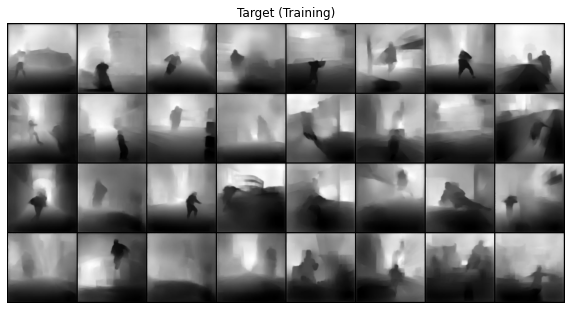

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


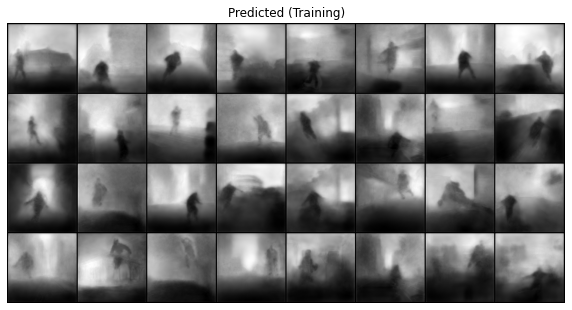

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.053294	Metric: 0.761449
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.050563	Metric: 0.740937
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.053006	Metric: 0.744256
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.052390	Metric: 0.749581
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.056277	Metric: 0.809543
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.049449	Metric: 0.711630
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.057170	Metric: 0.815493
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.054195	Metric: 0.789058
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.053448	Metric: 0.766453
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.052362	Metric: 0.757310
Batch ID:  1500


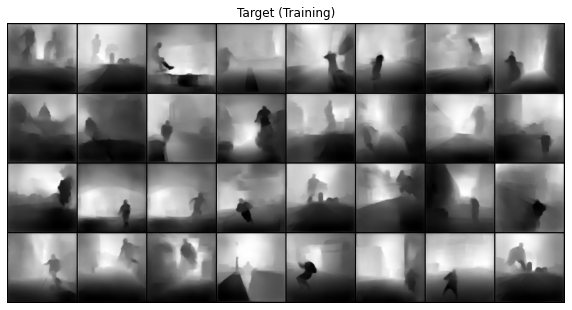

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


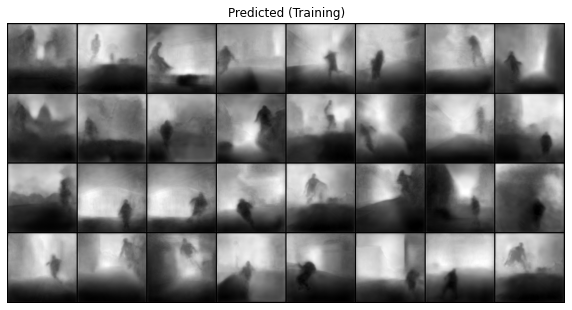

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.054536	Metric: 0.781751
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.055176	Metric: 0.788921
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.057211	Metric: 0.801299
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.051667	Metric: 0.733644
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.053146	Metric: 0.743017
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.050434	Metric: 0.722458
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.052599	Metric: 0.747289
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.053804	Metric: 0.769904
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.050154	Metric: 0.728983
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.054793	Metric: 0.778532
Batch ID:  2000


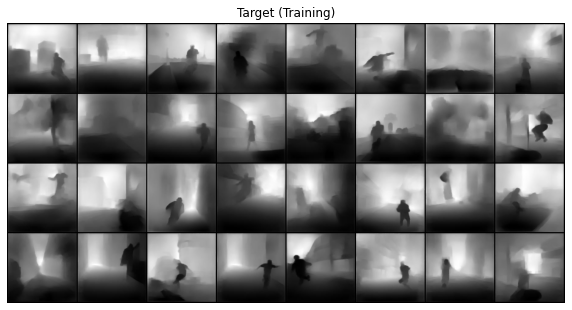

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


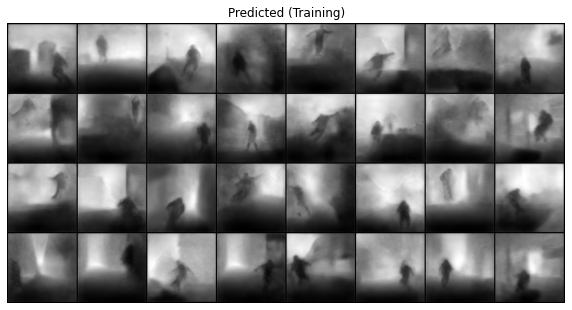

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.049650	Metric: 0.728479
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.052250	Metric: 0.776568
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.052617	Metric: 0.751988
Batch ID:  2150
Train Epoch: 2 [0/280000 (0%)]	Loss: 0.050816	Metric: 0.736300
Batch ID:  0


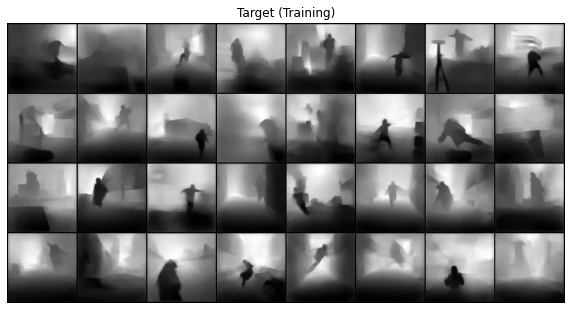

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


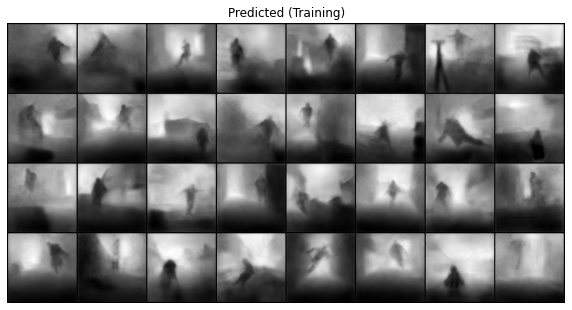

Train Epoch: 2 [6400/280000 (2%)]	Loss: 0.053463	Metric: 0.760179
Batch ID:  50
Train Epoch: 2 [12800/280000 (5%)]	Loss: 0.048567	Metric: 0.713797
Batch ID:  100
Train Epoch: 2 [19200/280000 (7%)]	Loss: 0.052350	Metric: 0.749415
Batch ID:  150
Train Epoch: 2 [25600/280000 (9%)]	Loss: 0.054067	Metric: 0.768897
Batch ID:  200
Train Epoch: 2 [32000/280000 (11%)]	Loss: 0.052060	Metric: 0.756476
Batch ID:  250
Train Epoch: 2 [38400/280000 (14%)]	Loss: 0.050814	Metric: 0.720820
Batch ID:  300
Train Epoch: 2 [44800/280000 (16%)]	Loss: 0.057779	Metric: 0.815881
Batch ID:  350
Train Epoch: 2 [51200/280000 (18%)]	Loss: 0.054742	Metric: 0.778727
Batch ID:  400
Train Epoch: 2 [57600/280000 (21%)]	Loss: 0.050546	Metric: 0.740774
Batch ID:  450
Train Epoch: 2 [64000/280000 (23%)]	Loss: 0.054649	Metric: 0.779660
Batch ID:  500


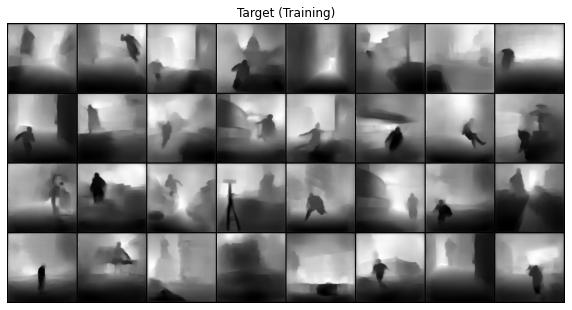

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


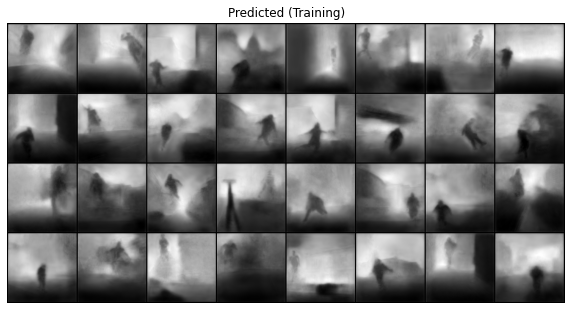

Train Epoch: 2 [70400/280000 (25%)]	Loss: 0.055798	Metric: 0.782464
Batch ID:  550
Train Epoch: 2 [76800/280000 (27%)]	Loss: 0.050127	Metric: 0.734690
Batch ID:  600
Train Epoch: 2 [83200/280000 (30%)]	Loss: 0.050575	Metric: 0.716522
Batch ID:  650
Train Epoch: 2 [89600/280000 (32%)]	Loss: 0.053688	Metric: 0.761022
Batch ID:  700
Train Epoch: 2 [96000/280000 (34%)]	Loss: 0.053990	Metric: 0.759238
Batch ID:  750
Train Epoch: 2 [102400/280000 (37%)]	Loss: 0.054750	Metric: 0.779723
Batch ID:  800
Train Epoch: 2 [108800/280000 (39%)]	Loss: 0.048666	Metric: 0.698785
Batch ID:  850
Train Epoch: 2 [115200/280000 (41%)]	Loss: 0.055125	Metric: 0.798322
Batch ID:  900
Train Epoch: 2 [121600/280000 (43%)]	Loss: 0.051166	Metric: 0.729912
Batch ID:  950
Train Epoch: 2 [128000/280000 (46%)]	Loss: 0.052305	Metric: 0.758799
Batch ID:  1000


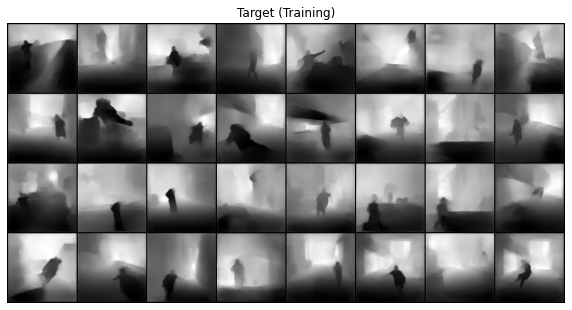

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


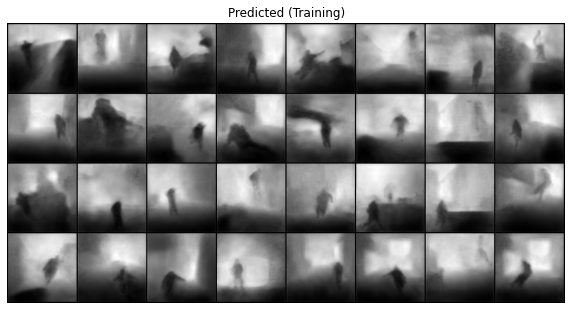

Train Epoch: 2 [134400/280000 (48%)]	Loss: 0.053351	Metric: 0.787925
Batch ID:  1050
Train Epoch: 2 [140800/280000 (50%)]	Loss: 0.052289	Metric: 0.755643
Batch ID:  1100
Train Epoch: 2 [147200/280000 (53%)]	Loss: 0.055468	Metric: 0.793465
Batch ID:  1150
Train Epoch: 2 [153600/280000 (55%)]	Loss: 0.057247	Metric: 0.808328
Batch ID:  1200
Train Epoch: 2 [160000/280000 (57%)]	Loss: 0.054803	Metric: 0.785477
Batch ID:  1250
Train Epoch: 2 [166400/280000 (59%)]	Loss: 0.052076	Metric: 0.763822
Batch ID:  1300
Train Epoch: 2 [172800/280000 (62%)]	Loss: 0.051118	Metric: 0.742141
Batch ID:  1350
Train Epoch: 2 [179200/280000 (64%)]	Loss: 0.057072	Metric: 0.805369
Batch ID:  1400
Train Epoch: 2 [185600/280000 (66%)]	Loss: 0.051746	Metric: 0.760784
Batch ID:  1450
Train Epoch: 2 [192000/280000 (69%)]	Loss: 0.052461	Metric: 0.730493
Batch ID:  1500


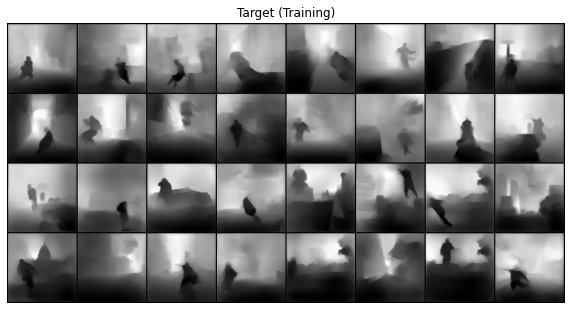

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


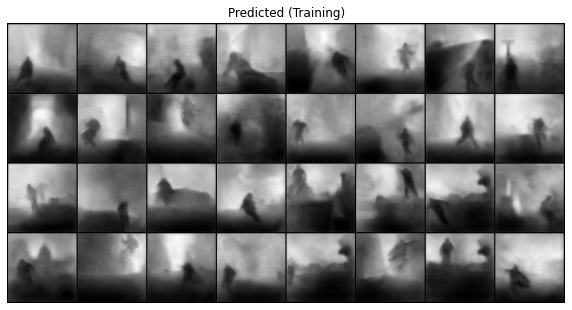

Train Epoch: 2 [198400/280000 (71%)]	Loss: 0.053577	Metric: 0.771631
Batch ID:  1550
Train Epoch: 2 [204800/280000 (73%)]	Loss: 0.052607	Metric: 0.747349
Batch ID:  1600
Train Epoch: 2 [211200/280000 (75%)]	Loss: 0.054000	Metric: 0.776106
Batch ID:  1650
Train Epoch: 2 [217600/280000 (78%)]	Loss: 0.055800	Metric: 0.814005
Batch ID:  1700
Train Epoch: 2 [224000/280000 (80%)]	Loss: 0.054862	Metric: 0.776910
Batch ID:  1750
Train Epoch: 2 [230400/280000 (82%)]	Loss: 0.054421	Metric: 0.768057
Batch ID:  1800
Train Epoch: 2 [236800/280000 (85%)]	Loss: 0.047910	Metric: 0.688769
Batch ID:  1850
Train Epoch: 2 [243200/280000 (87%)]	Loss: 0.051377	Metric: 0.748746
Batch ID:  1900
Train Epoch: 2 [249600/280000 (89%)]	Loss: 0.054646	Metric: 0.792265
Batch ID:  1950
Train Epoch: 2 [256000/280000 (91%)]	Loss: 0.052868	Metric: 0.767218
Batch ID:  2000


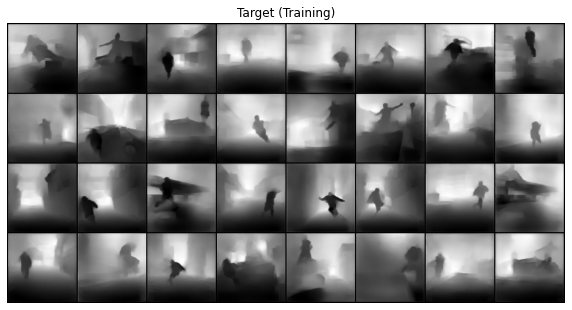

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


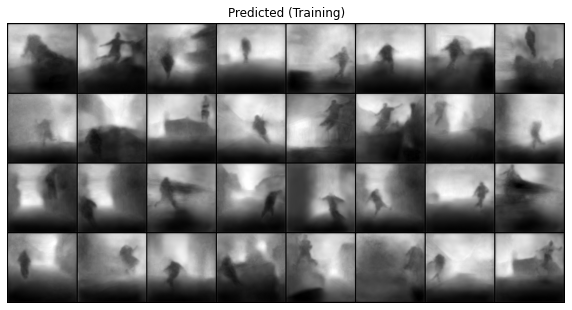

Train Epoch: 2 [262400/280000 (94%)]	Loss: 0.054100	Metric: 0.769209
Batch ID:  2050
Train Epoch: 2 [268800/280000 (96%)]	Loss: 0.052686	Metric: 0.769549
Batch ID:  2100
Train Epoch: 2 [275200/280000 (98%)]	Loss: 0.053735	Metric: 0.786838
Batch ID:  2150
--- 2505.537227153778 seconds -- -


In [32]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.001, epochs=2)
print("--- %s seconds -- -" % (time.time() - start_time))

Changing the image dimensions to original, i.e, 224x224

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.132217	Metric: 1.748117
Batch ID:  0


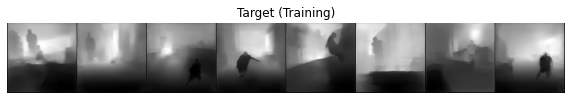

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


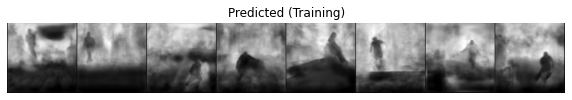

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.111766	Metric: 1.485205
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.095605	Metric: 1.295638
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.088473	Metric: 1.190529
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.086284	Metric: 1.183842
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.089999	Metric: 1.227502
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.081745	Metric: 1.097769
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.091549	Metric: 1.223874
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.090875	Metric: 1.230686
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.080926	Metric: 1.078227
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.079705	Metric: 1.053657
Batch ID:  500


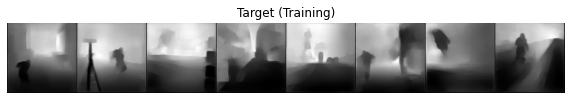

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


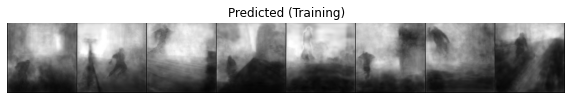

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.087642	Metric: 1.218603
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.085817	Metric: 1.169082
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.095109	Metric: 1.301554
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.081998	Metric: 1.145512
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.069632	Metric: 0.970389
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.071251	Metric: 1.002174
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.078231	Metric: 1.060667
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.068734	Metric: 0.964360
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.074549	Metric: 1.063946
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.071308	Metric: 0.992039
Batch ID:  1000


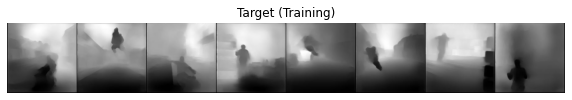

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


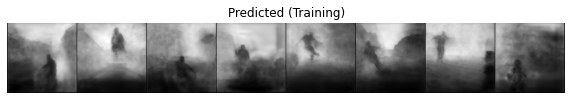

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.071794	Metric: 1.041689
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.073485	Metric: 0.980521
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.071683	Metric: 1.007339
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.073730	Metric: 1.054501
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.072616	Metric: 1.036530
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.063374	Metric: 0.871064
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.082350	Metric: 1.117842
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.073660	Metric: 1.060405
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.076449	Metric: 1.075840
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.075020	Metric: 1.043079
Batch ID:  1500


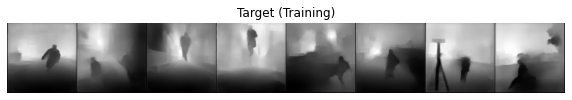

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


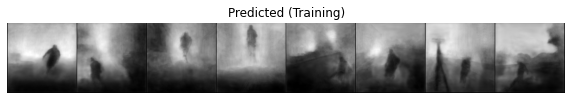

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.079958	Metric: 1.114322
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.074443	Metric: 1.037668
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.079695	Metric: 1.127207
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.080204	Metric: 1.089368
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.066879	Metric: 0.934123
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.071927	Metric: 0.977992
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.070027	Metric: 0.982493
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.072154	Metric: 1.005581
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.068279	Metric: 0.943335
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.071996	Metric: 0.991661
Batch ID:  2000


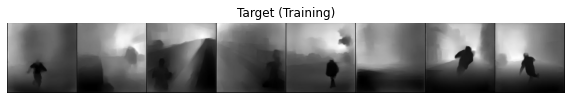

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


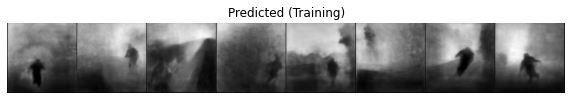

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.060728	Metric: 0.840848
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.072300	Metric: 0.958281
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.068473	Metric: 0.942124
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.074982	Metric: 1.024935
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.073961	Metric: 1.042690
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.080581	Metric: 1.118772
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.077194	Metric: 1.045814
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.082792	Metric: 1.141588
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.072290	Metric: 1.039060
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.067734	Metric: 1.010780
Batch ID:  2500


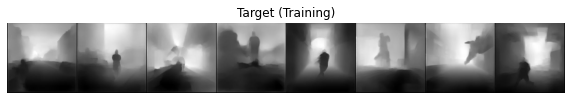

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


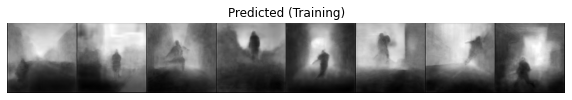

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.067419	Metric: 0.931025
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.082199	Metric: 1.073932
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.069280	Metric: 0.956101
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.065991	Metric: 0.938909
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.066097	Metric: 0.903141
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.061491	Metric: 0.880387
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.071179	Metric: 1.000151
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.067896	Metric: 0.935279
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.072534	Metric: 1.037899
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.068323	Metric: 0.955024
Batch ID:  3000


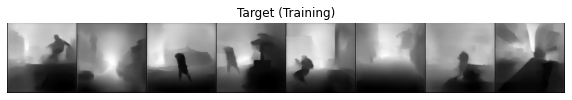

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


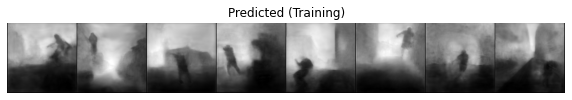

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.063478	Metric: 0.857537
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.071317	Metric: 0.977421
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.061131	Metric: 0.847283
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.080126	Metric: 1.085835
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.074044	Metric: 1.007038
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.080372	Metric: 1.118853
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.066430	Metric: 0.899661
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.068141	Metric: 0.967994
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.061461	Metric: 0.883212
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.065383	Metric: 0.919117
Batch ID:  3500


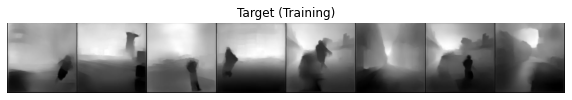

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


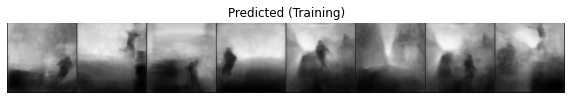

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.078023	Metric: 1.066408
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.065202	Metric: 0.898714
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.068121	Metric: 0.978525
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.065561	Metric: 0.938916
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.073546	Metric: 1.030886
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.078343	Metric: 1.113710
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.071219	Metric: 0.981685
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.075600	Metric: 1.047589
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.061624	Metric: 0.863698
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.068615	Metric: 0.938799
Batch ID:  4000


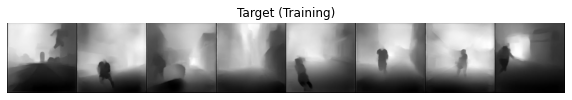

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


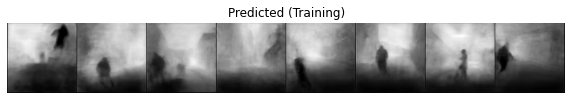

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.075555	Metric: 1.068401
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.080698	Metric: 1.060116
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.067843	Metric: 0.935743
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.067381	Metric: 0.968727
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.069177	Metric: 0.955756
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.087400	Metric: 1.187132
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.070687	Metric: 0.988513
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.065162	Metric: 0.942670
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.062118	Metric: 0.862277
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.069685	Metric: 0.986535
Batch ID:  4500


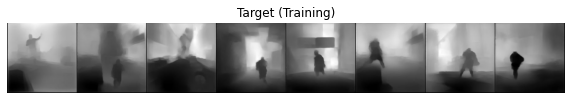

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


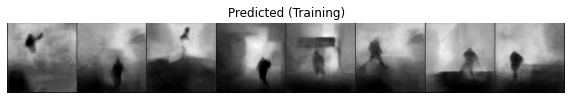

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.076162	Metric: 1.062583
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.061502	Metric: 0.867946
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.072296	Metric: 0.983921
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.065689	Metric: 0.921110
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.066666	Metric: 0.964351
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.062408	Metric: 0.895872
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.070858	Metric: 1.016794
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.065773	Metric: 0.982780
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.070995	Metric: 1.031217
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.073643	Metric: 1.044968
Batch ID:  5000


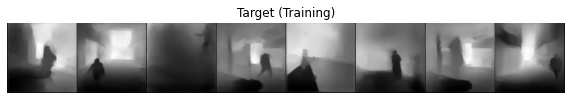

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


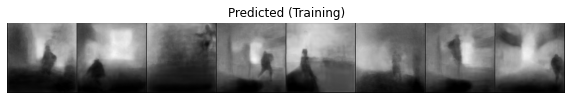

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.068711	Metric: 0.972504
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.067946	Metric: 0.941297
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.066249	Metric: 0.895389
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.060654	Metric: 0.831405
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.060236	Metric: 0.858047
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.064694	Metric: 0.923132
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.066555	Metric: 0.972924
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.068349	Metric: 0.972553
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.076648	Metric: 1.089720
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.066307	Metric: 0.927470
Batch ID:  5500


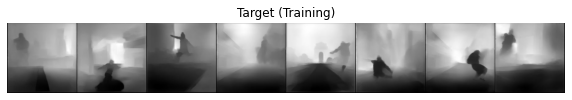

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


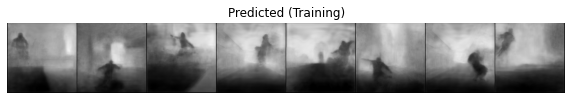

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.062184	Metric: 0.881116
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.059655	Metric: 0.829343
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.069249	Metric: 0.968363
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.069022	Metric: 0.960119
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.068365	Metric: 0.959548
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.066744	Metric: 0.959583
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.075476	Metric: 1.055495
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.071566	Metric: 1.011593
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.063140	Metric: 0.898673
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.068192	Metric: 0.930350
Batch ID:  6000


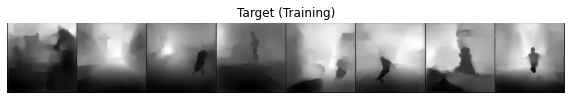

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


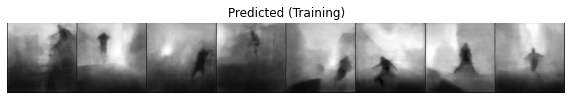

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.061214	Metric: 0.842057
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.066858	Metric: 0.942137
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.068730	Metric: 0.962842
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.071156	Metric: 0.982793
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.067829	Metric: 0.928011
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.058975	Metric: 0.842591
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.070751	Metric: 0.983394
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.067807	Metric: 0.945381
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.061818	Metric: 0.878146
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.067212	Metric: 0.937972
Batch ID:  6500


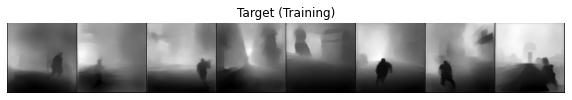

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


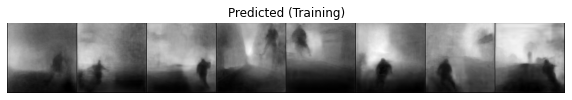

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.078552	Metric: 1.134583
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.059581	Metric: 0.844621
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.063702	Metric: 0.879450
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.067689	Metric: 1.028307
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.065172	Metric: 0.930802
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.076357	Metric: 1.151989
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.061122	Metric: 0.857244
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.059195	Metric: 0.827973
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.066636	Metric: 0.996490
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.064684	Metric: 0.888189
Batch ID:  7000


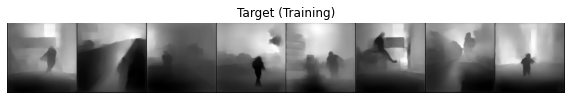

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


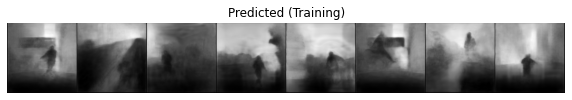

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.060133	Metric: 0.820445
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.062008	Metric: 0.895529
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.064182	Metric: 0.939070
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.075589	Metric: 1.034411
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.065354	Metric: 0.943861
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.064701	Metric: 0.911502
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.063389	Metric: 0.864884
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.063287	Metric: 0.885428
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.063217	Metric: 0.909800
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.067415	Metric: 0.953970
Batch ID:  7500


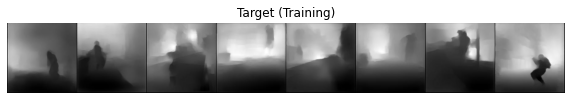

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


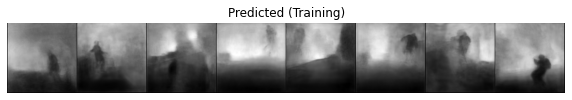

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.058535	Metric: 0.836477
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.066035	Metric: 0.921923
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.076073	Metric: 1.061116
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.067555	Metric: 0.953422
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.057602	Metric: 0.807232
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.064072	Metric: 0.902759
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.070385	Metric: 1.019844
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.067511	Metric: 0.963222
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.072973	Metric: 1.041986
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.061429	Metric: 0.862106
Batch ID:  8000


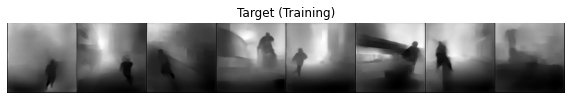

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


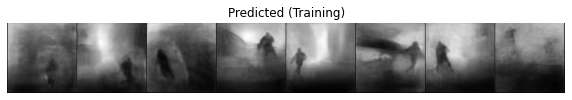

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.062223	Metric: 0.900178
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.073603	Metric: 1.016617
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.064700	Metric: 0.899644
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.064345	Metric: 0.869370
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.070175	Metric: 1.006811
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.062440	Metric: 0.854897
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.062133	Metric: 0.850415
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.081694	Metric: 1.152725
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.058143	Metric: 0.856627
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.058182	Metric: 0.812232
Batch ID:  8500


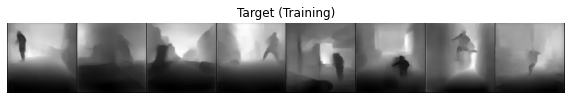

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


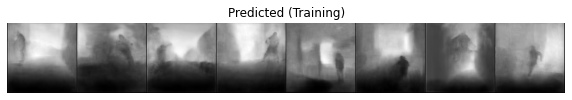

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.068275	Metric: 0.967685
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.064430	Metric: 0.907298
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.055346	Metric: 0.766682
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.055878	Metric: 0.816384
Batch ID:  8700
--- 4460.3729820251465 seconds -- -


In [36]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.01, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.056387	Metric: 0.796083
Batch ID:  0


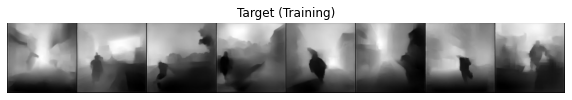

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


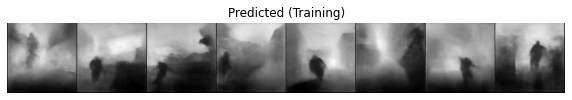

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.049125	Metric: 0.694823
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.073191	Metric: 1.024295
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.056891	Metric: 0.809299
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.064055	Metric: 0.903289
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.064342	Metric: 0.905932
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.058432	Metric: 0.883296
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.058715	Metric: 0.836538
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.067787	Metric: 0.972523
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.075184	Metric: 1.066663
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.060059	Metric: 0.885154
Batch ID:  500


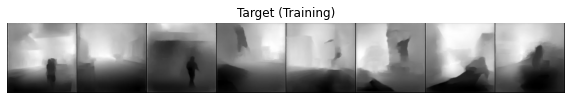

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


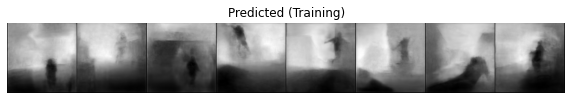

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.054665	Metric: 0.790101
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.056729	Metric: 0.791758
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.053739	Metric: 0.776301
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.058375	Metric: 0.821148
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.068578	Metric: 1.019600
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.061986	Metric: 0.865457
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.058015	Metric: 0.838353
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.069223	Metric: 0.983385
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.063969	Metric: 0.873552
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.060581	Metric: 0.863970
Batch ID:  1000


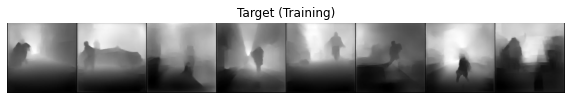

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


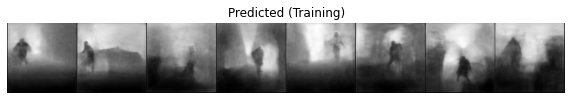

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.064883	Metric: 0.941284
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.055203	Metric: 0.788958
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.069837	Metric: 0.998885
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.062561	Metric: 0.879629
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.065478	Metric: 0.942206
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.057426	Metric: 0.821198
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.054514	Metric: 0.783718
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.066024	Metric: 0.939625
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.059079	Metric: 0.838778
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.054184	Metric: 0.769680
Batch ID:  1500


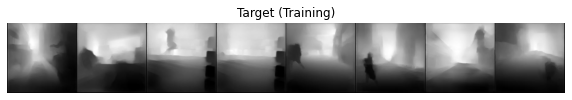

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


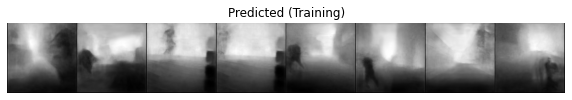

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.062116	Metric: 0.871301
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.056981	Metric: 0.835860
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.058920	Metric: 0.828041
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.060019	Metric: 0.824374
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.069252	Metric: 0.957072
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.066774	Metric: 0.997268
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.065469	Metric: 0.916457
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.062736	Metric: 0.917622
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.072248	Metric: 1.025127
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.066128	Metric: 0.950607
Batch ID:  2000


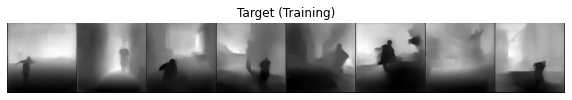

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


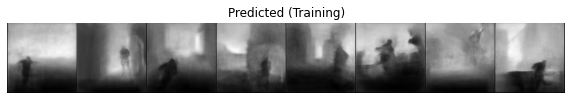

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.059106	Metric: 0.820949
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.060980	Metric: 0.865718
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.060416	Metric: 0.854461
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.053912	Metric: 0.774845
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.061621	Metric: 0.900185
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.072166	Metric: 1.023218
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.053078	Metric: 0.761881
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.061687	Metric: 0.962492
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.073370	Metric: 1.040532
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.068469	Metric: 0.952986
Batch ID:  2500


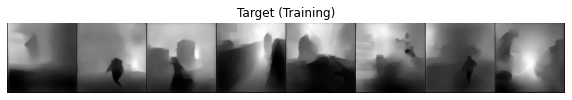

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


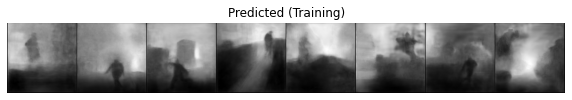

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.061426	Metric: 0.890122
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.067962	Metric: 0.968695
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.047401	Metric: 0.671284
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.059208	Metric: 0.837048
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.056841	Metric: 0.812611
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.064401	Metric: 0.955896
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.058632	Metric: 0.860407
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.055122	Metric: 0.819298
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.059079	Metric: 0.839482
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.067731	Metric: 0.957082
Batch ID:  3000


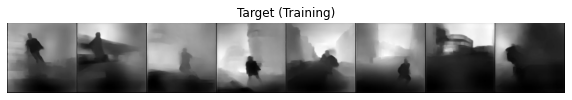

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


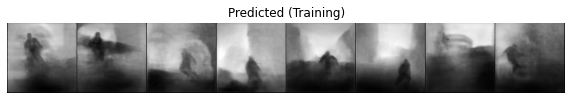

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.061690	Metric: 0.909006
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.060212	Metric: 0.856181
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.051438	Metric: 0.822251
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.059699	Metric: 0.887965
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.058762	Metric: 0.872730
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.064187	Metric: 0.917200
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.065078	Metric: 0.931259
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.065195	Metric: 0.904773
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.058933	Metric: 0.868476
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.055023	Metric: 0.803366
Batch ID:  3500


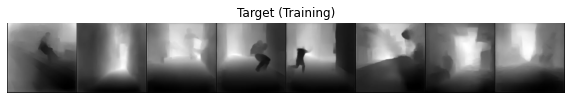

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


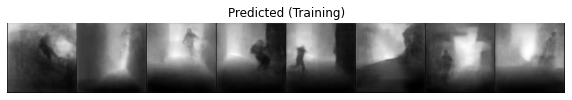

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.070820	Metric: 1.001149
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.061738	Metric: 0.899099
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.058491	Metric: 0.850353
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.068888	Metric: 1.001117
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.054635	Metric: 0.790602
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.063570	Metric: 0.898995
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.064443	Metric: 0.914153
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.062338	Metric: 0.874024
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.056245	Metric: 0.779884
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.063653	Metric: 0.889631
Batch ID:  4000


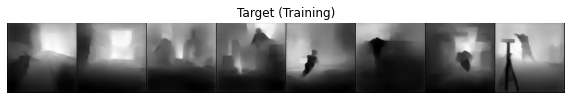

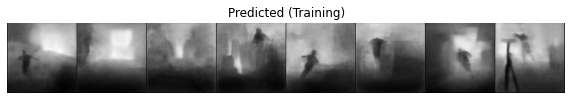

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.070616	Metric: 1.001511
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.055451	Metric: 0.806922
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.056392	Metric: 0.808452
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.059307	Metric: 0.877546
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.066898	Metric: 0.964781
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.078741	Metric: 1.099145
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.055485	Metric: 0.810194
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.064165	Metric: 0.919270
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.056552	Metric: 0.792342
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.058574	Metric: 0.852762
Batch ID:  4500


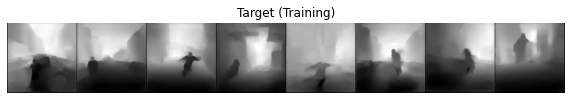

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


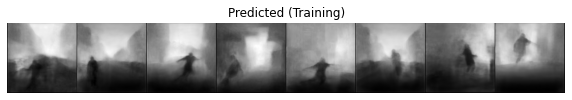

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.058568	Metric: 0.849461
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.049775	Metric: 0.743103
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.056361	Metric: 0.830557
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.060221	Metric: 0.864928
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.052785	Metric: 0.776815
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.071233	Metric: 0.988030
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.064643	Metric: 0.935495
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.060855	Metric: 0.838368
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.065387	Metric: 0.952211
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.064874	Metric: 0.907791
Batch ID:  5000


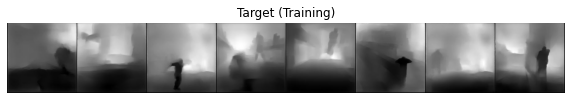

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


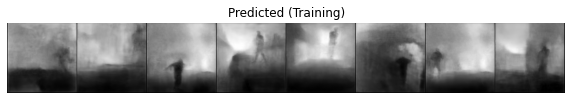

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.056573	Metric: 0.828970
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.065081	Metric: 0.935355
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.061960	Metric: 0.886744
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.067466	Metric: 0.993280
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.066872	Metric: 0.970224
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.068952	Metric: 0.974515
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.068475	Metric: 0.958414
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.056026	Metric: 0.807475
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.063036	Metric: 0.903046
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.057207	Metric: 0.836460
Batch ID:  5500


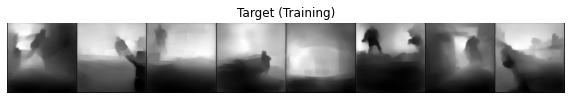

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


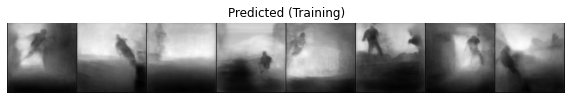

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.064546	Metric: 0.925937
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.068157	Metric: 0.957544
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.065647	Metric: 0.924015
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.054976	Metric: 0.792229
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.051467	Metric: 0.726052
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.051349	Metric: 0.744056
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.059152	Metric: 0.812022
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.059889	Metric: 0.865736
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.066913	Metric: 0.987626
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.059720	Metric: 0.863579
Batch ID:  6000


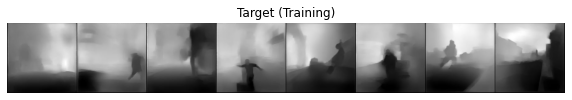

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


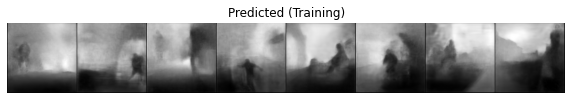

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.056444	Metric: 0.813622
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.065366	Metric: 0.926659
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.065023	Metric: 0.922866
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.062320	Metric: 0.876818
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.064751	Metric: 0.959366
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.059117	Metric: 0.866461
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.054703	Metric: 0.833465
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.063269	Metric: 0.924319
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.064537	Metric: 0.957537
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.058191	Metric: 0.824941
Batch ID:  6500


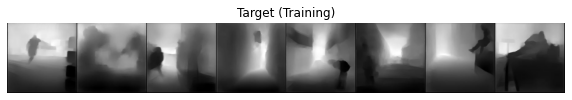

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


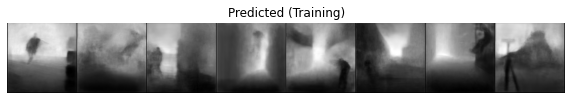

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.062376	Metric: 0.892465
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.050004	Metric: 0.726787
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.047266	Metric: 0.708883
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.058170	Metric: 0.855276
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.060284	Metric: 0.839454
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.065093	Metric: 0.935299
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.061011	Metric: 0.851211
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.055259	Metric: 0.820319
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.060547	Metric: 0.951304
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.065713	Metric: 0.908939
Batch ID:  7000


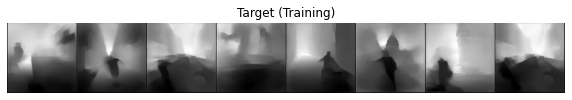

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


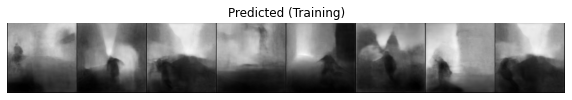

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.057078	Metric: 0.838380
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.056180	Metric: 0.820292
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.063066	Metric: 0.915507
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.050800	Metric: 0.724734
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.064634	Metric: 0.917741
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.055523	Metric: 0.794147
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.056286	Metric: 0.825859
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.058211	Metric: 0.824596
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.070809	Metric: 0.966295
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.059450	Metric: 0.911227
Batch ID:  7500


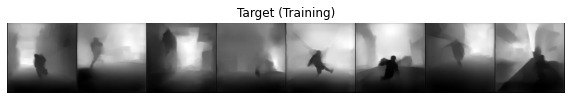

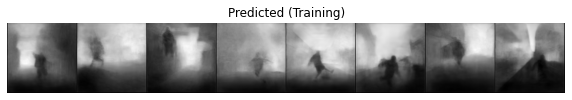

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.064441	Metric: 0.881317
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.064380	Metric: 0.942448
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.055698	Metric: 0.792856
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.054557	Metric: 0.807070
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.050745	Metric: 0.742777
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.068251	Metric: 0.985237
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.063984	Metric: 0.953577
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.054073	Metric: 0.785792
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.070368	Metric: 0.999951
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.072342	Metric: 1.020933
Batch ID:  8000


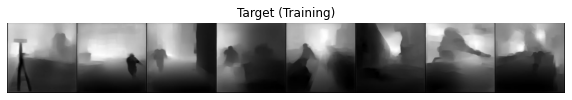

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


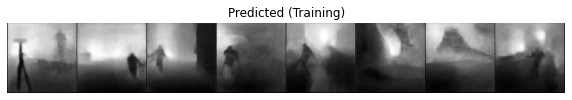

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.056762	Metric: 0.813757
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.055997	Metric: 0.815659
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.056139	Metric: 0.827083
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.070360	Metric: 1.007235
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.063891	Metric: 0.897638
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.062140	Metric: 0.876135
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.063649	Metric: 0.898779
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.066931	Metric: 0.951057
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.059845	Metric: 0.884693
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.064994	Metric: 0.919304
Batch ID:  8500


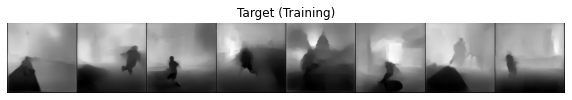

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


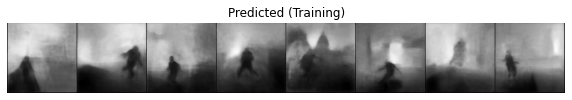

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.059566	Metric: 0.883930
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.055991	Metric: 0.795020
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.057442	Metric: 0.822044
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.063631	Metric: 0.911059
Batch ID:  8700
--- 4459.948294639587 seconds -- -


In [37]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/depth_224_1.pth")

Training for mask at 112 x 112

In [0]:
import segmentation_models_pytorch as smp
metric = smp.utils.metrics.IoU(threshold=0.5)
criterion = nn.BCEWithLogitsLoss()

In [13]:
model.load_state_dict(torch.load('/content/drive/My Drive/depth_224_1.pth'))

<All keys matched successfully>

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.723866	Metric: 0.085736
Batch ID:  0


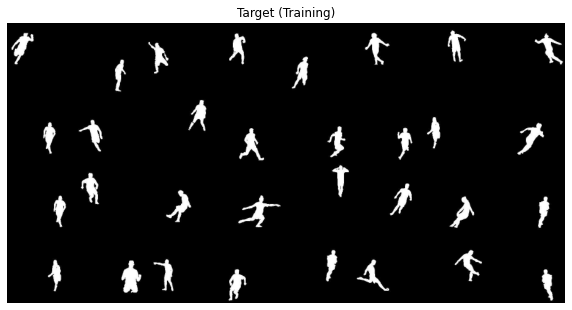

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


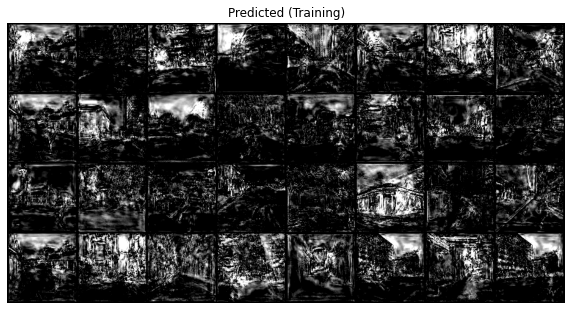

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.043698	Metric: 0.724670
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.033154	Metric: 0.782920
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.028734	Metric: 0.804314
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.027734	Metric: 0.812238
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.025494	Metric: 0.819341
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.023971	Metric: 0.828176
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.023738	Metric: 0.834934
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.024398	Metric: 0.827210
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.023464	Metric: 0.833587
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.022569	Metric: 0.839791
Batch ID:  500


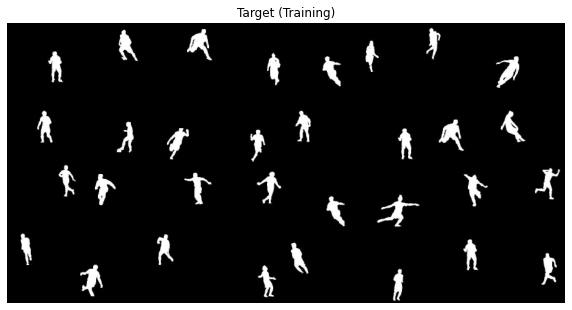

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


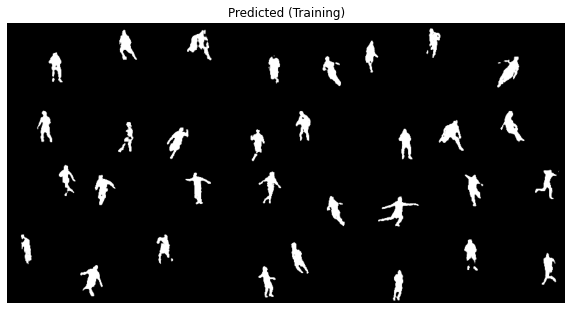

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.022077	Metric: 0.842993
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.021486	Metric: 0.844364
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.021569	Metric: 0.838650
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.021289	Metric: 0.843724
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.021078	Metric: 0.847627
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.020666	Metric: 0.850052
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.021469	Metric: 0.840346
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.020751	Metric: 0.846142
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.020227	Metric: 0.852588
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.020174	Metric: 0.849528
Batch ID:  1000


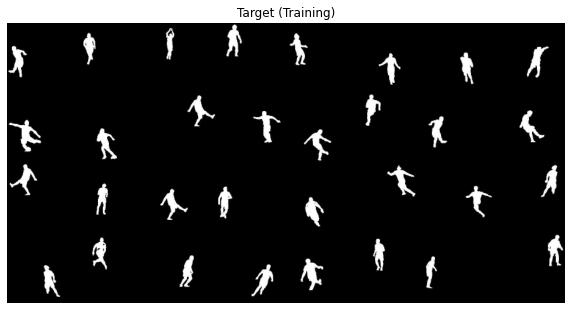

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


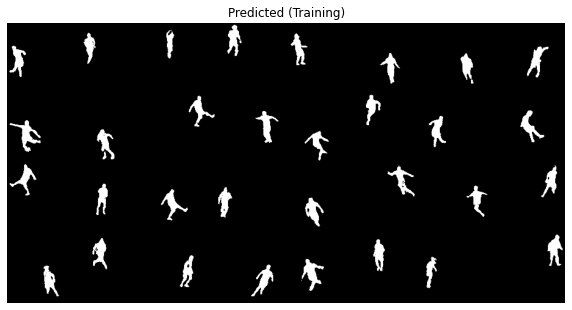

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.019961	Metric: 0.849103
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.019719	Metric: 0.851542
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.020255	Metric: 0.851515
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.019984	Metric: 0.851529
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.019929	Metric: 0.853596
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.019470	Metric: 0.854309
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.020174	Metric: 0.853031
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.019661	Metric: 0.852592
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.019590	Metric: 0.852062
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.019331	Metric: 0.858445
Batch ID:  1500


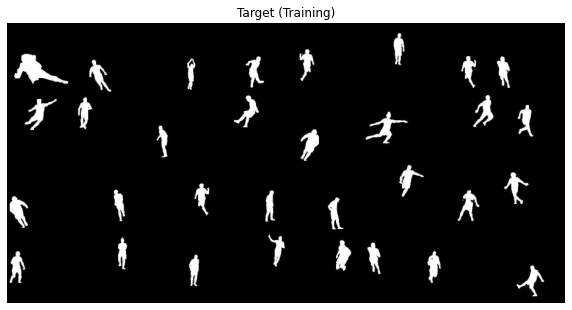

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


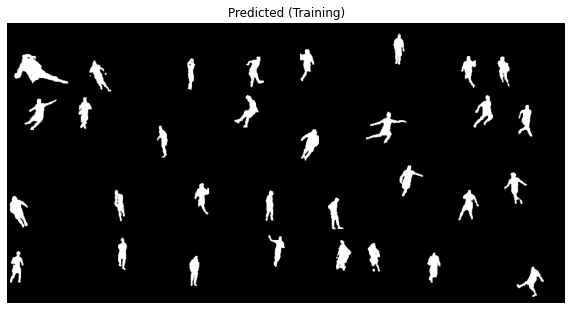

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.019380	Metric: 0.850067
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.019725	Metric: 0.851781
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.019261	Metric: 0.860673
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.019745	Metric: 0.849450
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.019228	Metric: 0.855532
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.019941	Metric: 0.854410
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.018697	Metric: 0.857916
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.019017	Metric: 0.863817
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.019444	Metric: 0.854580
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.018626	Metric: 0.863729
Batch ID:  2000


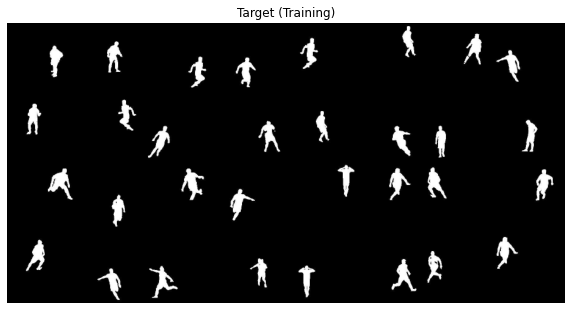

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


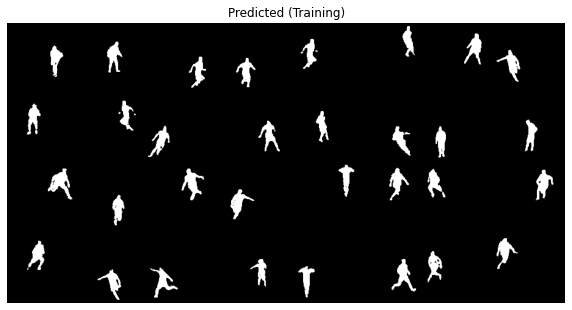

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.019053	Metric: 0.856910
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.019041	Metric: 0.859250
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.018471	Metric: 0.860947
Batch ID:  2150
--- 959.9045095443726 seconds -- -


In [14]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.01, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.019291	Metric: 0.856517
Batch ID:  0


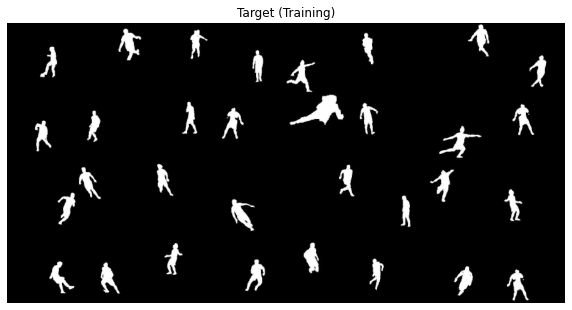

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


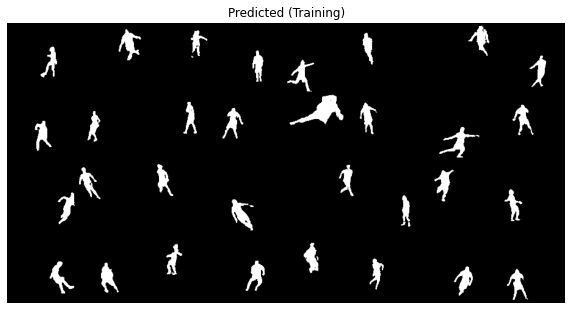

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.018891	Metric: 0.862441
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.018887	Metric: 0.859420
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.019272	Metric: 0.853242
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.019141	Metric: 0.858123
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.019086	Metric: 0.860828
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.018877	Metric: 0.858013
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.018749	Metric: 0.862827
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.018207	Metric: 0.865048
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.019199	Metric: 0.860460
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.018950	Metric: 0.863038
Batch ID:  500


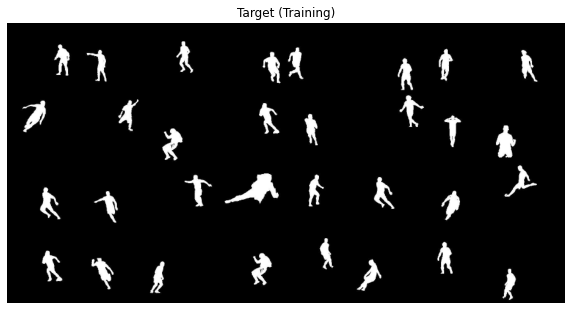

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


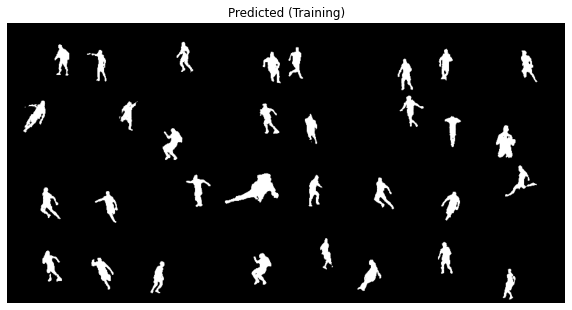

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.019049	Metric: 0.858239
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.018594	Metric: 0.862389
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.018581	Metric: 0.861094
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.018830	Metric: 0.860561
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.019021	Metric: 0.858385
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.019497	Metric: 0.857109
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.018344	Metric: 0.863248
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.018409	Metric: 0.861144
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.018664	Metric: 0.860841
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.018813	Metric: 0.854050
Batch ID:  1000


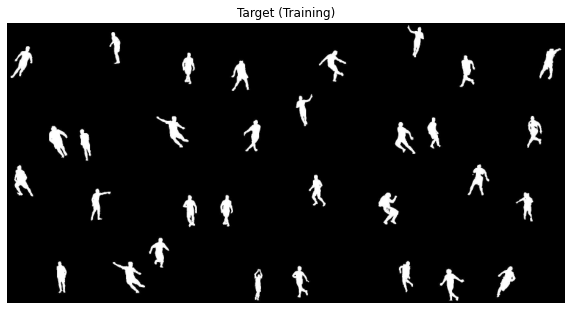

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


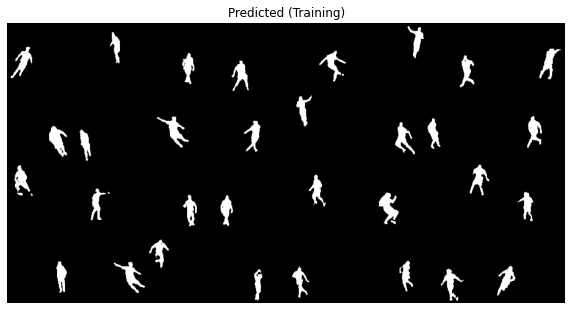

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.019160	Metric: 0.862629
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.018463	Metric: 0.859478
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.018761	Metric: 0.859493
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.018241	Metric: 0.865367
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.018446	Metric: 0.862629
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.018857	Metric: 0.859300
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.019170	Metric: 0.860930
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.018284	Metric: 0.863935
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.018771	Metric: 0.858297
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.018674	Metric: 0.860207
Batch ID:  1500


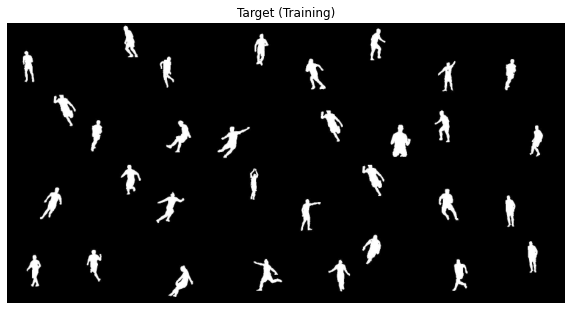

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


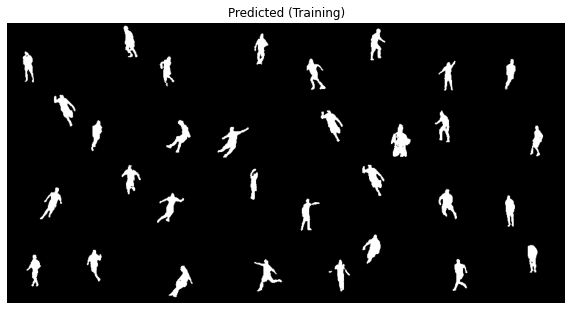

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.018835	Metric: 0.859191
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.018681	Metric: 0.861194
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.018613	Metric: 0.862519
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.018521	Metric: 0.862051
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.019706	Metric: 0.855641
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.018911	Metric: 0.858613
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.018445	Metric: 0.860439
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.018750	Metric: 0.861299
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.018279	Metric: 0.860471
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.018756	Metric: 0.860215
Batch ID:  2000


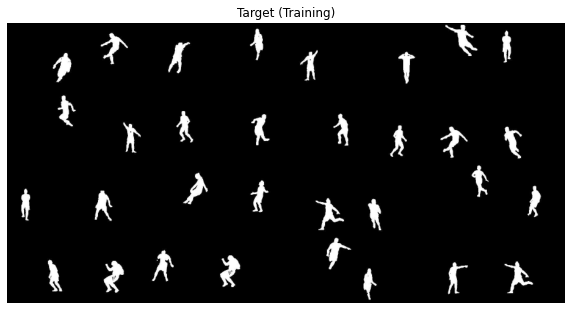

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


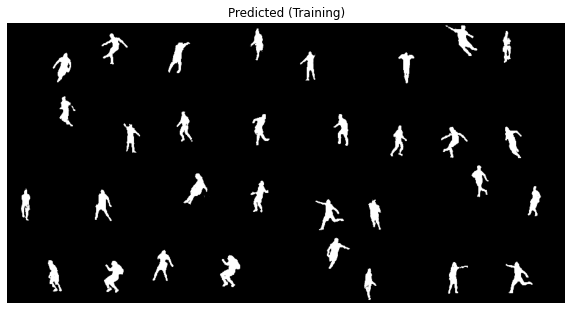

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.018986	Metric: 0.858710
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.018349	Metric: 0.861611
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.018364	Metric: 0.863192
Batch ID:  2150
--- 938.0647249221802 seconds -- -


In [15]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/mask_112_1.pth")

Training for Mask at 224x224

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.013822	Metric: 0.910709
Batch ID:  0


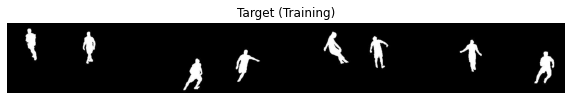

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


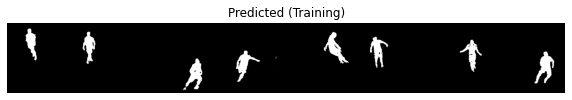

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.013350	Metric: 0.911301
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.012926	Metric: 0.919867
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.013027	Metric: 0.915306
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.012877	Metric: 0.921640
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.013708	Metric: 0.911035
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.012203	Metric: 0.919608
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.012884	Metric: 0.920613
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.012383	Metric: 0.924933
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.012316	Metric: 0.922421
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.011983	Metric: 0.922658
Batch ID:  500


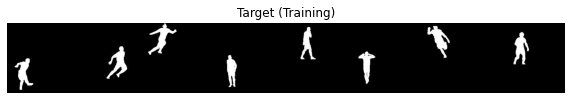

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


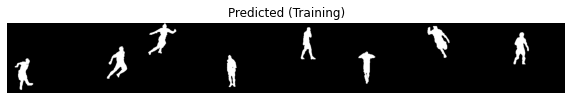

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.013034	Metric: 0.918666
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.013063	Metric: 0.922361
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.012285	Metric: 0.926747
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.013627	Metric: 0.921072
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.013012	Metric: 0.921282
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.011989	Metric: 0.918840
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.012411	Metric: 0.926828
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.012211	Metric: 0.925047
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.011318	Metric: 0.929051
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.012139	Metric: 0.925263
Batch ID:  1000


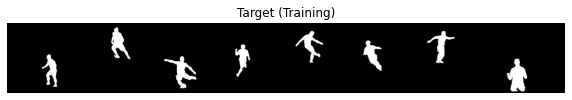

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


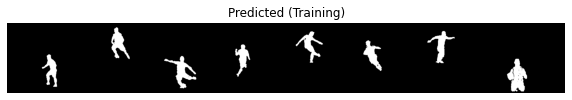

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.012298	Metric: 0.923367
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.012442	Metric: 0.919630
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.011848	Metric: 0.925851
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.012347	Metric: 0.916527
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.011659	Metric: 0.924279
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.012734	Metric: 0.921816
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.011545	Metric: 0.929117
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.012043	Metric: 0.930091
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.012425	Metric: 0.925036
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.011748	Metric: 0.926590
Batch ID:  1500


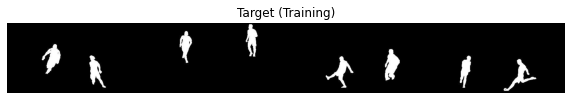

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


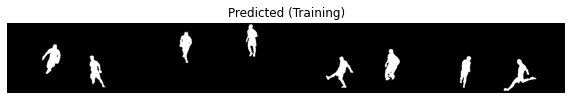

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.011515	Metric: 0.928063
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.012159	Metric: 0.923577
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.012430	Metric: 0.925044
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.012226	Metric: 0.927419
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.012136	Metric: 0.921272
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.011788	Metric: 0.928072
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.011556	Metric: 0.932969
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.012187	Metric: 0.925083
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.012126	Metric: 0.925418
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.010969	Metric: 0.935974
Batch ID:  2000


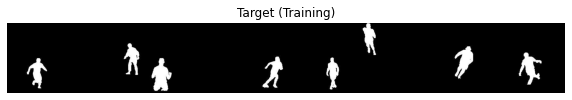

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


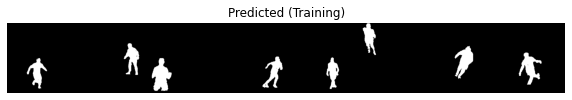

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.012127	Metric: 0.923535
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.011902	Metric: 0.933724
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.012564	Metric: 0.929087
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.011903	Metric: 0.927709
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.012041	Metric: 0.923686
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.012128	Metric: 0.933337
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.012423	Metric: 0.922172
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.011529	Metric: 0.929665
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.010779	Metric: 0.929067
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.011979	Metric: 0.922949
Batch ID:  2500


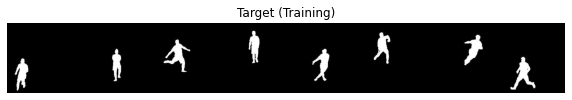

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


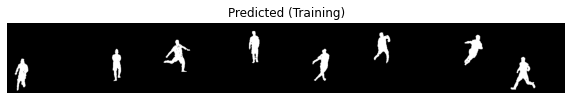

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.011198	Metric: 0.930808
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.011945	Metric: 0.928949
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.012104	Metric: 0.926270
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.011404	Metric: 0.931124
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.011181	Metric: 0.929992
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.011605	Metric: 0.929367
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.012369	Metric: 0.927160
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.011825	Metric: 0.933282
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.011205	Metric: 0.928260
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.011124	Metric: 0.933928
Batch ID:  3000


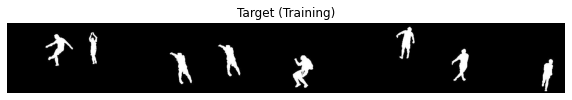

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


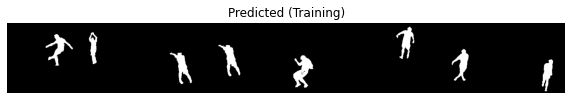

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.011408	Metric: 0.928890
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.011161	Metric: 0.933426
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.011908	Metric: 0.926433
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.011733	Metric: 0.933728
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.011465	Metric: 0.935960
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.011124	Metric: 0.931754
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.010871	Metric: 0.932524
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.011362	Metric: 0.930318
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.010991	Metric: 0.935232
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.011455	Metric: 0.932879
Batch ID:  3500


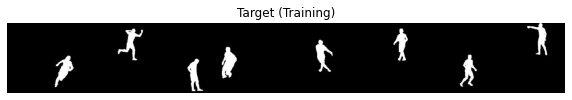

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


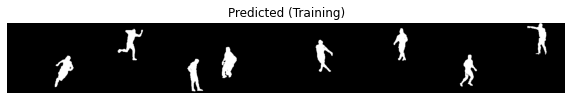

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.011925	Metric: 0.927222
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.011787	Metric: 0.929471
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.011539	Metric: 0.929561
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.010699	Metric: 0.936581
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.011245	Metric: 0.933493
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.011593	Metric: 0.928196
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.011572	Metric: 0.934527
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.011090	Metric: 0.929620
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.010569	Metric: 0.932281
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.012208	Metric: 0.921278
Batch ID:  4000


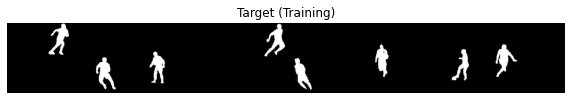

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


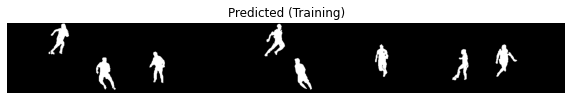

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.012088	Metric: 0.930122
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.011520	Metric: 0.930478
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.011213	Metric: 0.930637
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.010738	Metric: 0.933181
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.011398	Metric: 0.932417
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.011566	Metric: 0.926414
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.011064	Metric: 0.932432
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.010946	Metric: 0.933415
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.011088	Metric: 0.935563
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.011125	Metric: 0.932082
Batch ID:  4500


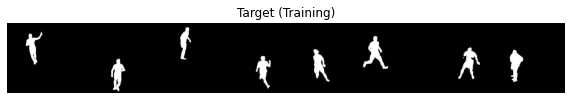

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


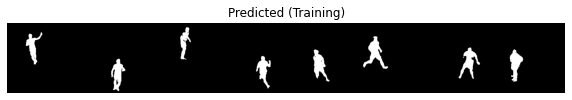

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.011237	Metric: 0.932146
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.011323	Metric: 0.935292
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.010954	Metric: 0.933624
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.010635	Metric: 0.936646
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.011393	Metric: 0.935355
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.011709	Metric: 0.930120
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.012014	Metric: 0.931805
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.011135	Metric: 0.935681
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.011695	Metric: 0.932978
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.011219	Metric: 0.931620
Batch ID:  5000


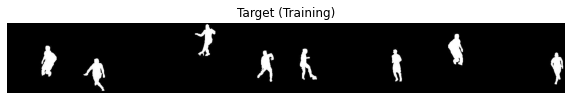

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


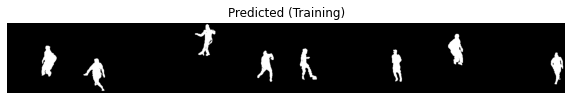

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.010896	Metric: 0.936021
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.011530	Metric: 0.925985
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.011342	Metric: 0.931461
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.010847	Metric: 0.936365
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.010872	Metric: 0.933072
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.010820	Metric: 0.933910
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.011066	Metric: 0.936868
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.010943	Metric: 0.934905
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.010824	Metric: 0.934873
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.011174	Metric: 0.930936
Batch ID:  5500


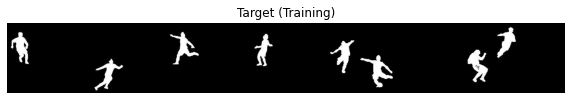

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


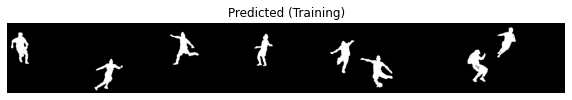

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.011378	Metric: 0.936555
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.011072	Metric: 0.933346
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.011863	Metric: 0.932471
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.011538	Metric: 0.932594
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.011774	Metric: 0.930250
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.011179	Metric: 0.934972
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.010907	Metric: 0.935457
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.010882	Metric: 0.932836
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.011163	Metric: 0.931762
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.010653	Metric: 0.936444
Batch ID:  6000


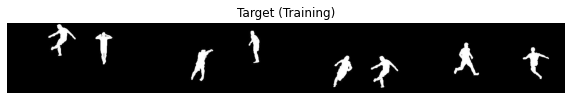

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


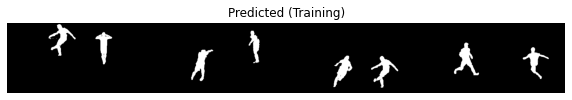

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.011189	Metric: 0.933810
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.010324	Metric: 0.937377
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.011632	Metric: 0.930313
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.011246	Metric: 0.933251
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.011398	Metric: 0.932383
Batch ID:  6250
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.010651	Metric: 0.934059
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.011839	Metric: 0.927590
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.010884	Metric: 0.937353
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.011109	Metric: 0.934397
Batch ID:  6500


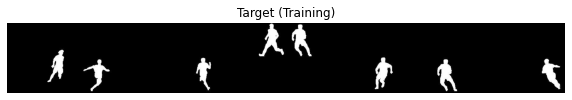

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


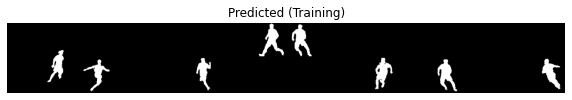

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.010158	Metric: 0.938559
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.011172	Metric: 0.933853
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.011302	Metric: 0.932399
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.011392	Metric: 0.935853
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.010664	Metric: 0.932899
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.011210	Metric: 0.935494
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.010688	Metric: 0.933034
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.010525	Metric: 0.937154
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.010665	Metric: 0.933782
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.011462	Metric: 0.933462
Batch ID:  7000


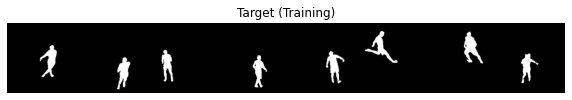

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


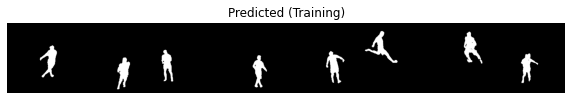

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.010140	Metric: 0.939370
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.010952	Metric: 0.931643
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.011673	Metric: 0.928580
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.011097	Metric: 0.932726
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.011215	Metric: 0.935730
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.011002	Metric: 0.934398
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.010382	Metric: 0.939507
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.010433	Metric: 0.937681
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.011370	Metric: 0.935807
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.010509	Metric: 0.936224
Batch ID:  7500


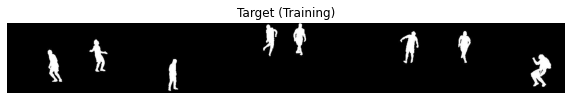

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


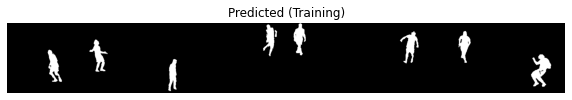

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.010723	Metric: 0.936563
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.010598	Metric: 0.938257
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.011192	Metric: 0.936586
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.010020	Metric: 0.939172
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.011336	Metric: 0.928652
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.011162	Metric: 0.940410
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.010551	Metric: 0.937559
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.011082	Metric: 0.931463
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.011400	Metric: 0.935083
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.010898	Metric: 0.936022
Batch ID:  8000


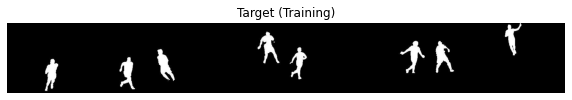

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


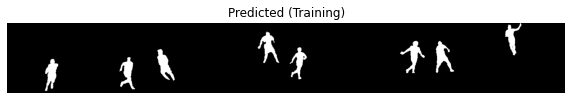

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.010875	Metric: 0.934730
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.011108	Metric: 0.931773
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.010825	Metric: 0.937230
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.010605	Metric: 0.936258
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.011767	Metric: 0.926814
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.011017	Metric: 0.937916
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.010788	Metric: 0.934660
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.010633	Metric: 0.934874
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.010951	Metric: 0.933999
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.010463	Metric: 0.937875
Batch ID:  8500


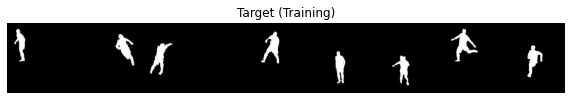

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


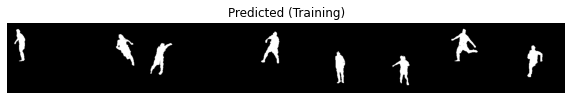

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.010939	Metric: 0.936648
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.010848	Metric: 0.934951
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.009790	Metric: 0.940318
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.011055	Metric: 0.935862
Batch ID:  8700
--- 3173.145250082016 seconds -- -


In [20]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.01, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.010826	Metric: 0.936426
Batch ID:  0


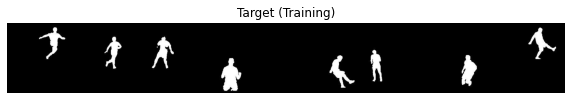

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


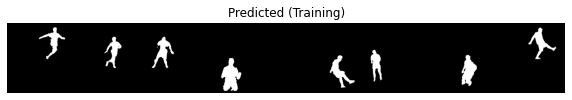

Train Epoch: 1 [1600/280000 (1%)]	Loss: 0.010794	Metric: 0.935791
Batch ID:  50
Train Epoch: 1 [3200/280000 (1%)]	Loss: 0.011239	Metric: 0.937284
Batch ID:  100
Train Epoch: 1 [4800/280000 (2%)]	Loss: 0.010818	Metric: 0.937233
Batch ID:  150
Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.011046	Metric: 0.934838
Batch ID:  200
Train Epoch: 1 [8000/280000 (3%)]	Loss: 0.010785	Metric: 0.938040
Batch ID:  250
Train Epoch: 1 [9600/280000 (3%)]	Loss: 0.011436	Metric: 0.937058
Batch ID:  300
Train Epoch: 1 [11200/280000 (4%)]	Loss: 0.010811	Metric: 0.935069
Batch ID:  350
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.010771	Metric: 0.938730
Batch ID:  400
Train Epoch: 1 [14400/280000 (5%)]	Loss: 0.011012	Metric: 0.935324
Batch ID:  450
Train Epoch: 1 [16000/280000 (6%)]	Loss: 0.010745	Metric: 0.939123
Batch ID:  500


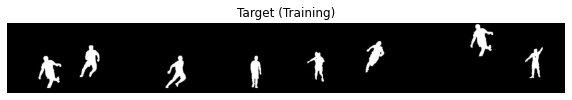

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


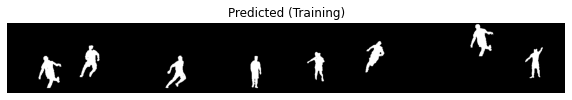

Train Epoch: 1 [17600/280000 (6%)]	Loss: 0.010126	Metric: 0.936412
Batch ID:  550
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.010409	Metric: 0.938417
Batch ID:  600
Train Epoch: 1 [20800/280000 (7%)]	Loss: 0.010146	Metric: 0.938841
Batch ID:  650
Train Epoch: 1 [22400/280000 (8%)]	Loss: 0.011030	Metric: 0.935965
Batch ID:  700
Train Epoch: 1 [24000/280000 (9%)]	Loss: 0.010869	Metric: 0.935995
Batch ID:  750
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.010903	Metric: 0.935128
Batch ID:  800
Train Epoch: 1 [27200/280000 (10%)]	Loss: 0.010874	Metric: 0.936364
Batch ID:  850
Train Epoch: 1 [28800/280000 (10%)]	Loss: 0.010887	Metric: 0.936551
Batch ID:  900
Train Epoch: 1 [30400/280000 (11%)]	Loss: 0.010534	Metric: 0.935679
Batch ID:  950
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.010623	Metric: 0.935658
Batch ID:  1000


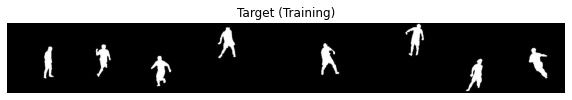

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


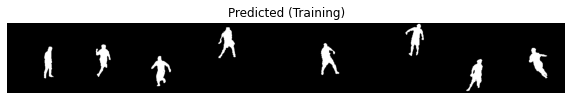

Train Epoch: 1 [33600/280000 (12%)]	Loss: 0.010450	Metric: 0.938234
Batch ID:  1050
Train Epoch: 1 [35200/280000 (13%)]	Loss: 0.011178	Metric: 0.934910
Batch ID:  1100
Train Epoch: 1 [36800/280000 (13%)]	Loss: 0.011109	Metric: 0.935817
Batch ID:  1150
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.010666	Metric: 0.932786
Batch ID:  1200
Train Epoch: 1 [40000/280000 (14%)]	Loss: 0.010854	Metric: 0.935580
Batch ID:  1250
Train Epoch: 1 [41600/280000 (15%)]	Loss: 0.010164	Metric: 0.937597
Batch ID:  1300
Train Epoch: 1 [43200/280000 (15%)]	Loss: 0.010317	Metric: 0.934425
Batch ID:  1350
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.010798	Metric: 0.935368
Batch ID:  1400
Train Epoch: 1 [46400/280000 (17%)]	Loss: 0.010593	Metric: 0.938399
Batch ID:  1450
Train Epoch: 1 [48000/280000 (17%)]	Loss: 0.010387	Metric: 0.937517
Batch ID:  1500


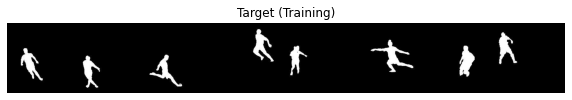

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


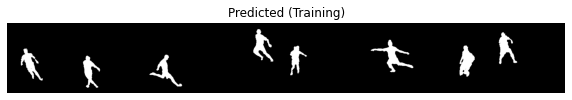

Train Epoch: 1 [49600/280000 (18%)]	Loss: 0.010701	Metric: 0.934785
Batch ID:  1550
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.010863	Metric: 0.934146
Batch ID:  1600
Train Epoch: 1 [52800/280000 (19%)]	Loss: 0.011488	Metric: 0.933499
Batch ID:  1650
Train Epoch: 1 [54400/280000 (19%)]	Loss: 0.011095	Metric: 0.930078
Batch ID:  1700
Train Epoch: 1 [56000/280000 (20%)]	Loss: 0.010890	Metric: 0.935012
Batch ID:  1750
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.010743	Metric: 0.936877
Batch ID:  1800
Train Epoch: 1 [59200/280000 (21%)]	Loss: 0.010703	Metric: 0.940431
Batch ID:  1850
Train Epoch: 1 [60800/280000 (22%)]	Loss: 0.010528	Metric: 0.939589
Batch ID:  1900
Train Epoch: 1 [62400/280000 (22%)]	Loss: 0.010653	Metric: 0.932523
Batch ID:  1950
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.010598	Metric: 0.935749
Batch ID:  2000


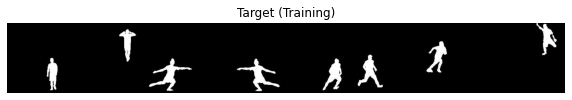

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


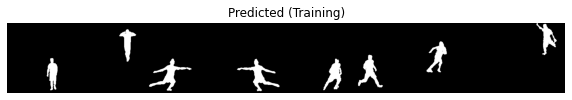

Train Epoch: 1 [65600/280000 (23%)]	Loss: 0.010485	Metric: 0.935679
Batch ID:  2050
Train Epoch: 1 [67200/280000 (24%)]	Loss: 0.011560	Metric: 0.933854
Batch ID:  2100
Train Epoch: 1 [68800/280000 (25%)]	Loss: 0.010527	Metric: 0.938463
Batch ID:  2150
Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.010406	Metric: 0.938096
Batch ID:  2200
Train Epoch: 1 [72000/280000 (26%)]	Loss: 0.011099	Metric: 0.933078
Batch ID:  2250
Train Epoch: 1 [73600/280000 (26%)]	Loss: 0.009888	Metric: 0.938455
Batch ID:  2300
Train Epoch: 1 [75200/280000 (27%)]	Loss: 0.010540	Metric: 0.935988
Batch ID:  2350
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.010926	Metric: 0.937256
Batch ID:  2400
Train Epoch: 1 [78400/280000 (28%)]	Loss: 0.010966	Metric: 0.935045
Batch ID:  2450
Train Epoch: 1 [80000/280000 (29%)]	Loss: 0.010657	Metric: 0.940301
Batch ID:  2500


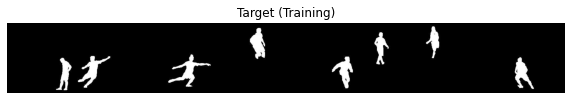

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


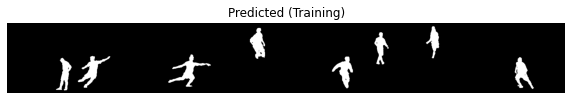

Train Epoch: 1 [81600/280000 (29%)]	Loss: 0.010661	Metric: 0.937576
Batch ID:  2550
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.010284	Metric: 0.938624
Batch ID:  2600
Train Epoch: 1 [84800/280000 (30%)]	Loss: 0.010809	Metric: 0.936904
Batch ID:  2650
Train Epoch: 1 [86400/280000 (31%)]	Loss: 0.011124	Metric: 0.933179
Batch ID:  2700
Train Epoch: 1 [88000/280000 (31%)]	Loss: 0.011264	Metric: 0.932565
Batch ID:  2750
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.010452	Metric: 0.938205
Batch ID:  2800
Train Epoch: 1 [91200/280000 (33%)]	Loss: 0.010690	Metric: 0.940152
Batch ID:  2850
Train Epoch: 1 [92800/280000 (33%)]	Loss: 0.010771	Metric: 0.933918
Batch ID:  2900
Train Epoch: 1 [94400/280000 (34%)]	Loss: 0.010533	Metric: 0.939030
Batch ID:  2950
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.010826	Metric: 0.936320
Batch ID:  3000


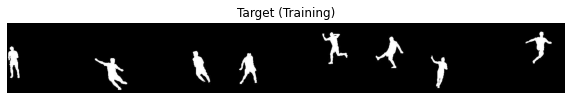

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


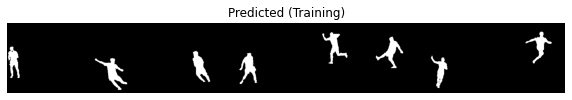

Train Epoch: 1 [97600/280000 (35%)]	Loss: 0.011103	Metric: 0.937659
Batch ID:  3050
Train Epoch: 1 [99200/280000 (35%)]	Loss: 0.010426	Metric: 0.935517
Batch ID:  3100
Train Epoch: 1 [100800/280000 (36%)]	Loss: 0.010672	Metric: 0.938051
Batch ID:  3150
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.010483	Metric: 0.939061
Batch ID:  3200
Train Epoch: 1 [104000/280000 (37%)]	Loss: 0.011034	Metric: 0.932984
Batch ID:  3250
Train Epoch: 1 [105600/280000 (38%)]	Loss: 0.010859	Metric: 0.934986
Batch ID:  3300
Train Epoch: 1 [107200/280000 (38%)]	Loss: 0.010669	Metric: 0.941114
Batch ID:  3350
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.010635	Metric: 0.938477
Batch ID:  3400
Train Epoch: 1 [110400/280000 (39%)]	Loss: 0.011156	Metric: 0.936995
Batch ID:  3450
Train Epoch: 1 [112000/280000 (40%)]	Loss: 0.010918	Metric: 0.935480
Batch ID:  3500


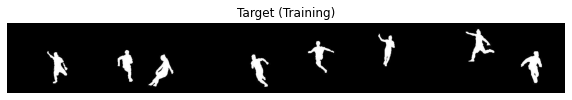

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


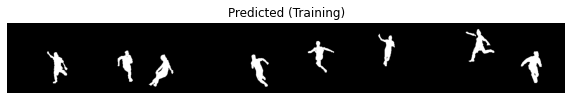

Train Epoch: 1 [113600/280000 (41%)]	Loss: 0.009704	Metric: 0.942368
Batch ID:  3550
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.010943	Metric: 0.935601
Batch ID:  3600
Train Epoch: 1 [116800/280000 (42%)]	Loss: 0.010722	Metric: 0.934325
Batch ID:  3650
Train Epoch: 1 [118400/280000 (42%)]	Loss: 0.009922	Metric: 0.939788
Batch ID:  3700
Train Epoch: 1 [120000/280000 (43%)]	Loss: 0.011113	Metric: 0.936255
Batch ID:  3750
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.011064	Metric: 0.936055
Batch ID:  3800
Train Epoch: 1 [123200/280000 (44%)]	Loss: 0.010910	Metric: 0.931881
Batch ID:  3850
Train Epoch: 1 [124800/280000 (45%)]	Loss: 0.010557	Metric: 0.937639
Batch ID:  3900
Train Epoch: 1 [126400/280000 (45%)]	Loss: 0.010534	Metric: 0.941586
Batch ID:  3950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.010596	Metric: 0.935345
Batch ID:  4000


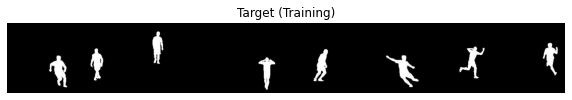

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


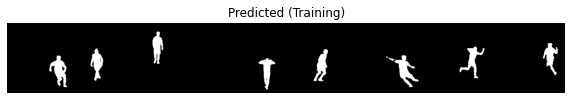

Train Epoch: 1 [129600/280000 (46%)]	Loss: 0.010766	Metric: 0.936715
Batch ID:  4050
Train Epoch: 1 [131200/280000 (47%)]	Loss: 0.010689	Metric: 0.940734
Batch ID:  4100
Train Epoch: 1 [132800/280000 (47%)]	Loss: 0.010290	Metric: 0.939520
Batch ID:  4150
Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.010528	Metric: 0.936506
Batch ID:  4200
Train Epoch: 1 [136000/280000 (49%)]	Loss: 0.010405	Metric: 0.937297
Batch ID:  4250
Train Epoch: 1 [137600/280000 (49%)]	Loss: 0.010374	Metric: 0.936788
Batch ID:  4300
Train Epoch: 1 [139200/280000 (50%)]	Loss: 0.010678	Metric: 0.935118
Batch ID:  4350
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.010300	Metric: 0.940542
Batch ID:  4400
Train Epoch: 1 [142400/280000 (51%)]	Loss: 0.010994	Metric: 0.937714
Batch ID:  4450
Train Epoch: 1 [144000/280000 (51%)]	Loss: 0.010973	Metric: 0.934091
Batch ID:  4500


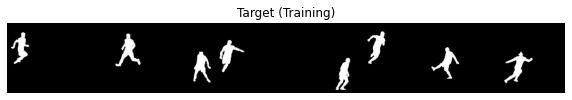

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


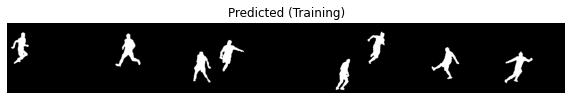

Train Epoch: 1 [145600/280000 (52%)]	Loss: 0.010796	Metric: 0.939929
Batch ID:  4550
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.010796	Metric: 0.941328
Batch ID:  4600
Train Epoch: 1 [148800/280000 (53%)]	Loss: 0.010593	Metric: 0.935954
Batch ID:  4650
Train Epoch: 1 [150400/280000 (54%)]	Loss: 0.010976	Metric: 0.936246
Batch ID:  4700
Train Epoch: 1 [152000/280000 (54%)]	Loss: 0.010506	Metric: 0.938240
Batch ID:  4750
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.009551	Metric: 0.940513
Batch ID:  4800
Train Epoch: 1 [155200/280000 (55%)]	Loss: 0.009919	Metric: 0.937717
Batch ID:  4850
Train Epoch: 1 [156800/280000 (56%)]	Loss: 0.010285	Metric: 0.937740
Batch ID:  4900
Train Epoch: 1 [158400/280000 (57%)]	Loss: 0.011275	Metric: 0.932979
Batch ID:  4950
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.010550	Metric: 0.934942
Batch ID:  5000


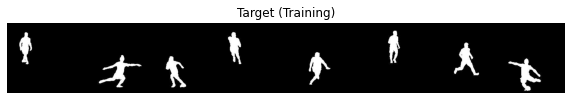

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


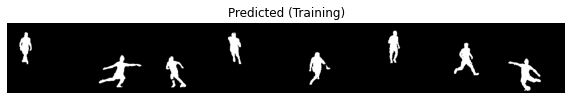

Train Epoch: 1 [161600/280000 (58%)]	Loss: 0.010922	Metric: 0.935982
Batch ID:  5050
Train Epoch: 1 [163200/280000 (58%)]	Loss: 0.010717	Metric: 0.935074
Batch ID:  5100
Train Epoch: 1 [164800/280000 (59%)]	Loss: 0.010427	Metric: 0.937406
Batch ID:  5150
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.010504	Metric: 0.935659
Batch ID:  5200
Train Epoch: 1 [168000/280000 (60%)]	Loss: 0.010238	Metric: 0.938908
Batch ID:  5250
Train Epoch: 1 [169600/280000 (61%)]	Loss: 0.010819	Metric: 0.936371
Batch ID:  5300
Train Epoch: 1 [171200/280000 (61%)]	Loss: 0.011015	Metric: 0.932123
Batch ID:  5350
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.010670	Metric: 0.938733
Batch ID:  5400
Train Epoch: 1 [174400/280000 (62%)]	Loss: 0.011023	Metric: 0.932519
Batch ID:  5450
Train Epoch: 1 [176000/280000 (63%)]	Loss: 0.010849	Metric: 0.934787
Batch ID:  5500


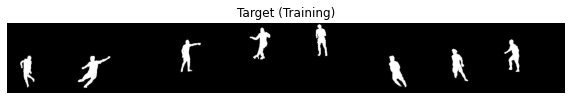

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


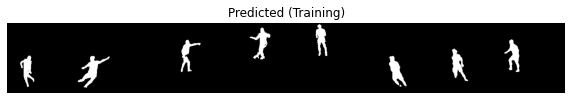

Train Epoch: 1 [177600/280000 (63%)]	Loss: 0.010582	Metric: 0.936188
Batch ID:  5550
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.010190	Metric: 0.941644
Batch ID:  5600
Train Epoch: 1 [180800/280000 (65%)]	Loss: 0.011361	Metric: 0.930463
Batch ID:  5650
Train Epoch: 1 [182400/280000 (65%)]	Loss: 0.011317	Metric: 0.935720
Batch ID:  5700
Train Epoch: 1 [184000/280000 (66%)]	Loss: 0.010519	Metric: 0.936682
Batch ID:  5750
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.010672	Metric: 0.935858
Batch ID:  5800
Train Epoch: 1 [187200/280000 (67%)]	Loss: 0.010845	Metric: 0.936558
Batch ID:  5850
Train Epoch: 1 [188800/280000 (67%)]	Loss: 0.011211	Metric: 0.931935
Batch ID:  5900
Train Epoch: 1 [190400/280000 (68%)]	Loss: 0.010957	Metric: 0.935765
Batch ID:  5950
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.010761	Metric: 0.934944
Batch ID:  6000


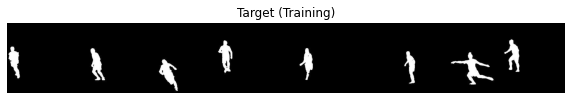

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


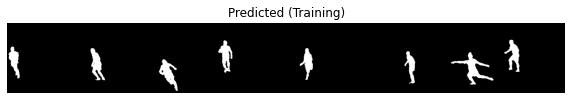

Train Epoch: 1 [193600/280000 (69%)]	Loss: 0.010555	Metric: 0.936904
Batch ID:  6050
Train Epoch: 1 [195200/280000 (70%)]	Loss: 0.010387	Metric: 0.936105
Batch ID:  6100
Train Epoch: 1 [196800/280000 (70%)]	Loss: 0.011065	Metric: 0.935209
Batch ID:  6150
Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.010622	Metric: 0.935344
Batch ID:  6200
Train Epoch: 1 [200000/280000 (71%)]	Loss: 0.010784	Metric: 0.934118
Batch ID:  6250
Train Epoch: 1 [201600/280000 (72%)]	Loss: 0.010171	Metric: 0.940675
Batch ID:  6300
Train Epoch: 1 [203200/280000 (73%)]	Loss: 0.010722	Metric: 0.940215
Batch ID:  6350
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.010880	Metric: 0.938281
Batch ID:  6400
Train Epoch: 1 [206400/280000 (74%)]	Loss: 0.010517	Metric: 0.938666
Batch ID:  6450
Train Epoch: 1 [208000/280000 (74%)]	Loss: 0.010828	Metric: 0.938285
Batch ID:  6500


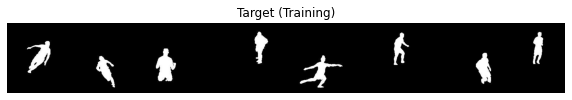

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


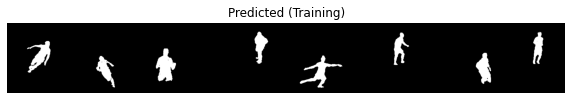

Train Epoch: 1 [209600/280000 (75%)]	Loss: 0.010960	Metric: 0.935914
Batch ID:  6550
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.010184	Metric: 0.938518
Batch ID:  6600
Train Epoch: 1 [212800/280000 (76%)]	Loss: 0.010610	Metric: 0.941184
Batch ID:  6650
Train Epoch: 1 [214400/280000 (77%)]	Loss: 0.011170	Metric: 0.936101
Batch ID:  6700
Train Epoch: 1 [216000/280000 (77%)]	Loss: 0.011484	Metric: 0.932562
Batch ID:  6750
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.011364	Metric: 0.939209
Batch ID:  6800
Train Epoch: 1 [219200/280000 (78%)]	Loss: 0.010323	Metric: 0.939043
Batch ID:  6850
Train Epoch: 1 [220800/280000 (79%)]	Loss: 0.011423	Metric: 0.933866
Batch ID:  6900
Train Epoch: 1 [222400/280000 (79%)]	Loss: 0.009827	Metric: 0.940008
Batch ID:  6950
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.010601	Metric: 0.935707
Batch ID:  7000


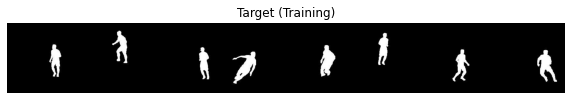

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


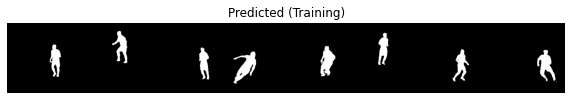

Train Epoch: 1 [225600/280000 (81%)]	Loss: 0.010478	Metric: 0.935873
Batch ID:  7050
Train Epoch: 1 [227200/280000 (81%)]	Loss: 0.010347	Metric: 0.937607
Batch ID:  7100
Train Epoch: 1 [228800/280000 (82%)]	Loss: 0.010996	Metric: 0.939323
Batch ID:  7150
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.011061	Metric: 0.934659
Batch ID:  7200
Train Epoch: 1 [232000/280000 (83%)]	Loss: 0.011030	Metric: 0.931174
Batch ID:  7250
Train Epoch: 1 [233600/280000 (83%)]	Loss: 0.010445	Metric: 0.938147
Batch ID:  7300
Train Epoch: 1 [235200/280000 (84%)]	Loss: 0.011116	Metric: 0.933949
Batch ID:  7350
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.010599	Metric: 0.937726
Batch ID:  7400
Train Epoch: 1 [238400/280000 (85%)]	Loss: 0.010903	Metric: 0.934164
Batch ID:  7450
Train Epoch: 1 [240000/280000 (86%)]	Loss: 0.010585	Metric: 0.937024
Batch ID:  7500


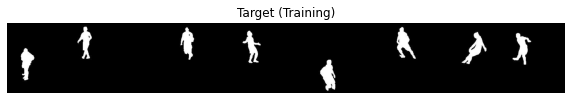

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


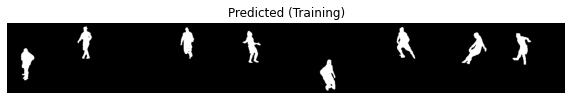

Train Epoch: 1 [241600/280000 (86%)]	Loss: 0.010869	Metric: 0.936375
Batch ID:  7550
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.010987	Metric: 0.936214
Batch ID:  7600
Train Epoch: 1 [244800/280000 (87%)]	Loss: 0.010248	Metric: 0.938105
Batch ID:  7650
Train Epoch: 1 [246400/280000 (88%)]	Loss: 0.010351	Metric: 0.940422
Batch ID:  7700
Train Epoch: 1 [248000/280000 (89%)]	Loss: 0.011229	Metric: 0.936800
Batch ID:  7750
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.010317	Metric: 0.942367
Batch ID:  7800
Train Epoch: 1 [251200/280000 (90%)]	Loss: 0.010445	Metric: 0.937480
Batch ID:  7850
Train Epoch: 1 [252800/280000 (90%)]	Loss: 0.011745	Metric: 0.929789
Batch ID:  7900
Train Epoch: 1 [254400/280000 (91%)]	Loss: 0.010895	Metric: 0.939021
Batch ID:  7950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.010669	Metric: 0.934161
Batch ID:  8000


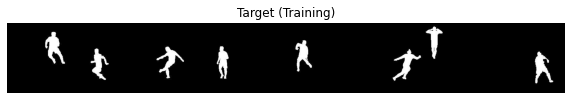

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


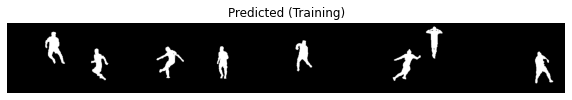

Train Epoch: 1 [257600/280000 (92%)]	Loss: 0.010842	Metric: 0.936437
Batch ID:  8050
Train Epoch: 1 [259200/280000 (93%)]	Loss: 0.011303	Metric: 0.932589
Batch ID:  8100
Train Epoch: 1 [260800/280000 (93%)]	Loss: 0.010262	Metric: 0.939388
Batch ID:  8150
Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.011113	Metric: 0.935547
Batch ID:  8200
Train Epoch: 1 [264000/280000 (94%)]	Loss: 0.010831	Metric: 0.936081
Batch ID:  8250
Train Epoch: 1 [265600/280000 (95%)]	Loss: 0.010357	Metric: 0.939736
Batch ID:  8300
Train Epoch: 1 [267200/280000 (95%)]	Loss: 0.011279	Metric: 0.929170
Batch ID:  8350
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.010291	Metric: 0.939142
Batch ID:  8400
Train Epoch: 1 [270400/280000 (97%)]	Loss: 0.010585	Metric: 0.936480
Batch ID:  8450
Train Epoch: 1 [272000/280000 (97%)]	Loss: 0.010331	Metric: 0.936942
Batch ID:  8500


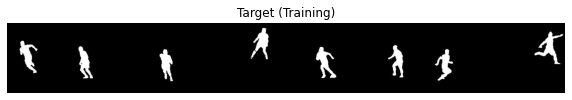

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


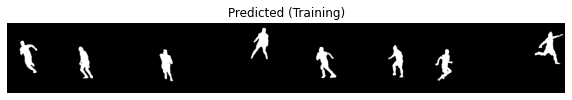

Train Epoch: 1 [273600/280000 (98%)]	Loss: 0.011011	Metric: 0.937510
Batch ID:  8550
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.010895	Metric: 0.934941
Batch ID:  8600
Train Epoch: 1 [276800/280000 (99%)]	Loss: 0.010555	Metric: 0.938593
Batch ID:  8650
Train Epoch: 1 [278400/280000 (99%)]	Loss: 0.011100	Metric: 0.938544
Batch ID:  8700
--- 3176.732795238495 seconds -- -


In [23]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader=None, criterion=criterion, metric=metric,  lr=0.0001, epochs=1)
print("--- %s seconds -- -" % (time.time() - start_time))

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/model_final.pth")

## Experiments

In [9]:
model.load_state_dict(torch.load("/content/drive/My Drive/unet_depth_l1_e12.pth"),  strict = False)

<All keys matched successfully>

In [0]:
from kornia import laplacian, sobel, spatial_gradient, rgb_to_grayscale, color

In [0]:
imgs = next(iter(train_loader))

In [0]:
x = color.add_weighted(src1=imgs['o2'], src2=laps7, alpha=1.0, beta=1.0, gamma=0.0)

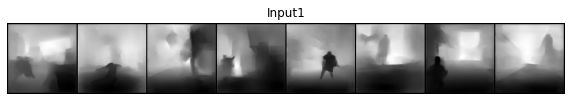

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


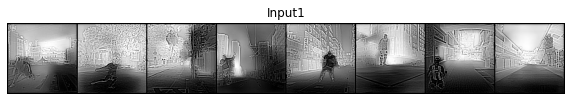

In [0]:
show_image(imgs['o2'][::16], 8, 'Input1')
show_image(x[::16], 8, 'Input1')

In [0]:
bl = rgb_to_grayscale(imgs['i2'])

In [0]:
laps7 = laplacian(bl, 3)
# laps9 = laplacian(bl, 9)
# laps11 = laplacian(bl, 11)

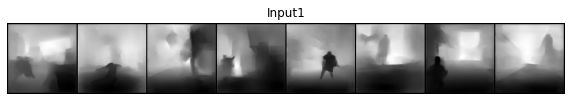

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


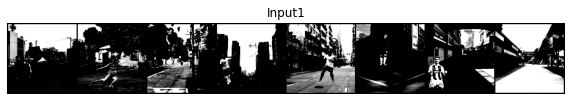

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


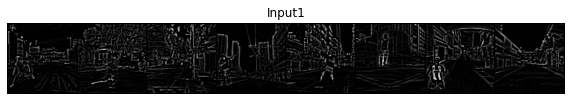

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


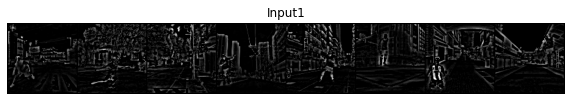

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


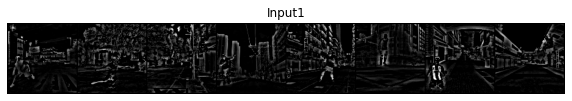

In [0]:
show_image(imgs['o2'][::16], 8, 'Input1')
show_image(bl[::16], 8, 'Input1')
show_image(laps7[::16], 8, 'Input1')
show_image(laps9[::16], 8, 'Input1')
show_image(laps11[::16], 8, 'Input1')

In [0]:
torch.save(model.state_dict(), "/content/drive/My Drive/model2.pth")

Train Epoch: 1 [0/280000 (0%)]	Loss: 0.728754	Metric: 0.086157
Batch ID:  0


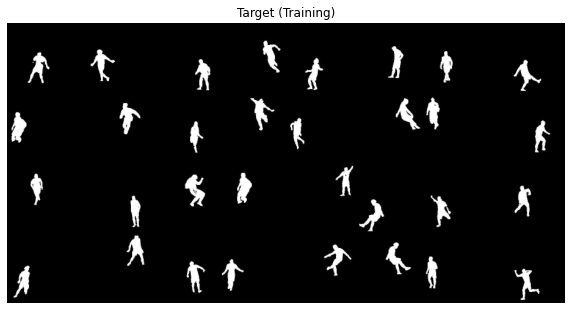

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


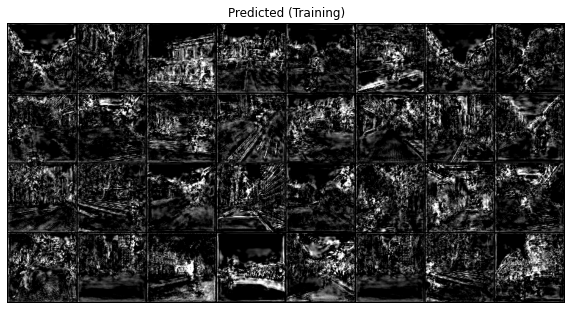

Train Epoch: 1 [6400/280000 (2%)]	Loss: 0.267116	Metric: 0.231272
Batch ID:  50
Train Epoch: 1 [12800/280000 (5%)]	Loss: 0.165734	Metric: 0.300070
Batch ID:  100
Train Epoch: 1 [19200/280000 (7%)]	Loss: 0.125168	Metric: 0.380043
Batch ID:  150
Train Epoch: 1 [25600/280000 (9%)]	Loss: 0.108263	Metric: 0.415490
Batch ID:  200
Train Epoch: 1 [32000/280000 (11%)]	Loss: 0.093286	Metric: 0.485843
Batch ID:  250
Train Epoch: 1 [38400/280000 (14%)]	Loss: 0.084949	Metric: 0.516354
Batch ID:  300
Train Epoch: 1 [44800/280000 (16%)]	Loss: 0.077614	Metric: 0.541709
Batch ID:  350
Train Epoch: 1 [51200/280000 (18%)]	Loss: 0.072250	Metric: 0.568911
Batch ID:  400
Train Epoch: 1 [57600/280000 (21%)]	Loss: 0.068086	Metric: 0.594637
Batch ID:  450
Train Epoch: 1 [64000/280000 (23%)]	Loss: 0.067302	Metric: 0.596171
Batch ID:  500


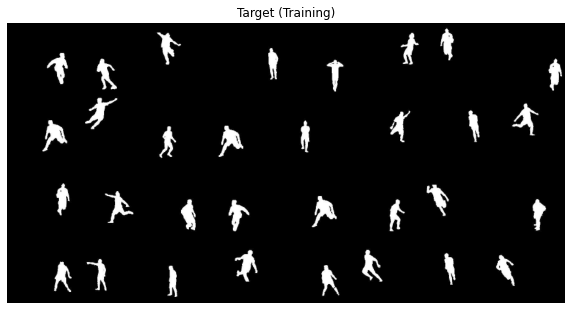

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


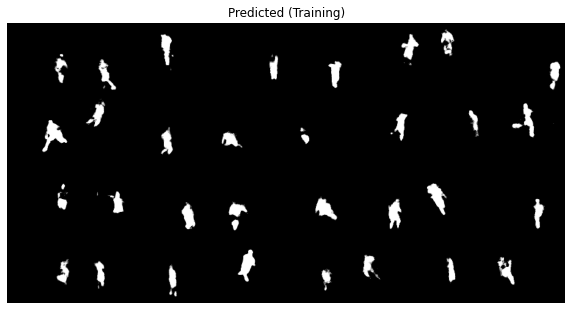

Train Epoch: 1 [70400/280000 (25%)]	Loss: 0.062071	Metric: 0.618500
Batch ID:  550
Train Epoch: 1 [76800/280000 (27%)]	Loss: 0.060511	Metric: 0.631158
Batch ID:  600
Train Epoch: 1 [83200/280000 (30%)]	Loss: 0.056315	Metric: 0.640633
Batch ID:  650
Train Epoch: 1 [89600/280000 (32%)]	Loss: 0.057281	Metric: 0.632005
Batch ID:  700
Train Epoch: 1 [96000/280000 (34%)]	Loss: 0.053635	Metric: 0.651355
Batch ID:  750
Train Epoch: 1 [102400/280000 (37%)]	Loss: 0.052442	Metric: 0.670713
Batch ID:  800
Train Epoch: 1 [108800/280000 (39%)]	Loss: 0.052927	Metric: 0.648352
Batch ID:  850
Train Epoch: 1 [115200/280000 (41%)]	Loss: 0.052304	Metric: 0.660118
Batch ID:  900
Train Epoch: 1 [121600/280000 (43%)]	Loss: 0.050497	Metric: 0.663378
Batch ID:  950
Train Epoch: 1 [128000/280000 (46%)]	Loss: 0.048883	Metric: 0.680051
Batch ID:  1000


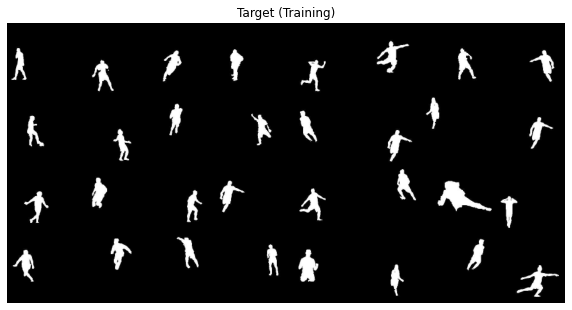

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


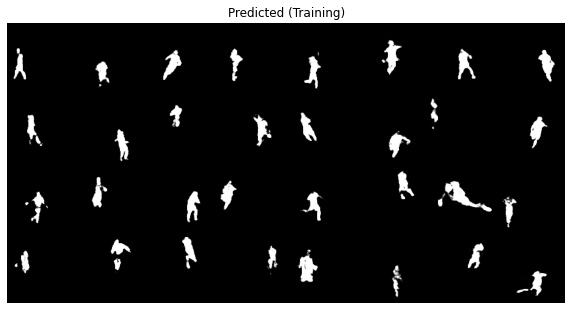

Train Epoch: 1 [134400/280000 (48%)]	Loss: 0.047776	Metric: 0.681587
Batch ID:  1050
Train Epoch: 1 [140800/280000 (50%)]	Loss: 0.047177	Metric: 0.690729
Batch ID:  1100
Train Epoch: 1 [147200/280000 (53%)]	Loss: 0.045836	Metric: 0.689106
Batch ID:  1150
Train Epoch: 1 [153600/280000 (55%)]	Loss: 0.044334	Metric: 0.705918
Batch ID:  1200
Train Epoch: 1 [160000/280000 (57%)]	Loss: 0.046605	Metric: 0.693132
Batch ID:  1250
Train Epoch: 1 [166400/280000 (59%)]	Loss: 0.043520	Metric: 0.713458
Batch ID:  1300
Train Epoch: 1 [172800/280000 (62%)]	Loss: 0.043441	Metric: 0.707199
Batch ID:  1350
Train Epoch: 1 [179200/280000 (64%)]	Loss: 0.041125	Metric: 0.724561
Batch ID:  1400
Train Epoch: 1 [185600/280000 (66%)]	Loss: 0.042731	Metric: 0.709910
Batch ID:  1450
Train Epoch: 1 [192000/280000 (69%)]	Loss: 0.040306	Metric: 0.720243
Batch ID:  1500


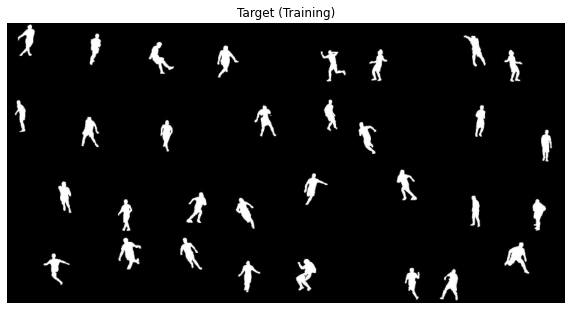

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


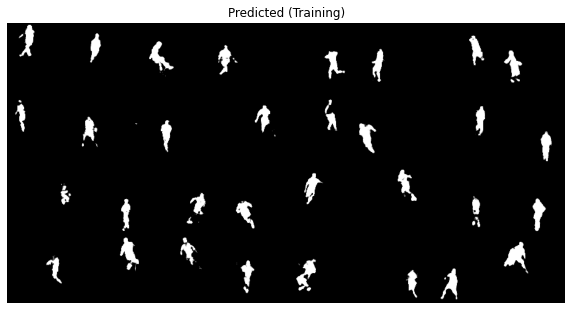

Train Epoch: 1 [198400/280000 (71%)]	Loss: 0.040847	Metric: 0.725689
Batch ID:  1550
Train Epoch: 1 [204800/280000 (73%)]	Loss: 0.040132	Metric: 0.725458
Batch ID:  1600
Train Epoch: 1 [211200/280000 (75%)]	Loss: 0.041098	Metric: 0.724923
Batch ID:  1650
Train Epoch: 1 [217600/280000 (78%)]	Loss: 0.039244	Metric: 0.726815
Batch ID:  1700
Train Epoch: 1 [224000/280000 (80%)]	Loss: 0.040971	Metric: 0.721163
Batch ID:  1750
Train Epoch: 1 [230400/280000 (82%)]	Loss: 0.038626	Metric: 0.730005
Batch ID:  1800
Train Epoch: 1 [236800/280000 (85%)]	Loss: 0.040523	Metric: 0.723917
Batch ID:  1850
Train Epoch: 1 [243200/280000 (87%)]	Loss: 0.037568	Metric: 0.737085
Batch ID:  1900
Train Epoch: 1 [249600/280000 (89%)]	Loss: 0.036670	Metric: 0.747299
Batch ID:  1950
Train Epoch: 1 [256000/280000 (91%)]	Loss: 0.037422	Metric: 0.736963
Batch ID:  2000


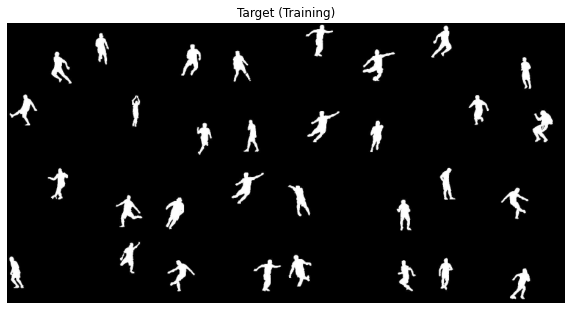

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


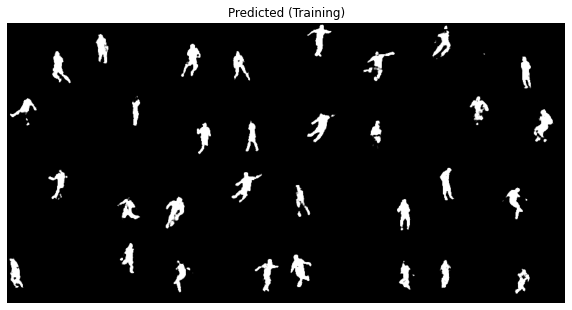

Train Epoch: 1 [262400/280000 (94%)]	Loss: 0.039416	Metric: 0.727537
Batch ID:  2050
Train Epoch: 1 [268800/280000 (96%)]	Loss: 0.037184	Metric: 0.744212
Batch ID:  2100
Train Epoch: 1 [275200/280000 (98%)]	Loss: 0.036951	Metric: 0.746659
Batch ID:  2150
Some target vs predicted samples:


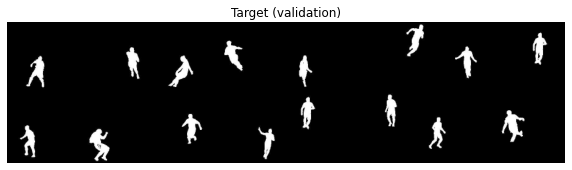

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


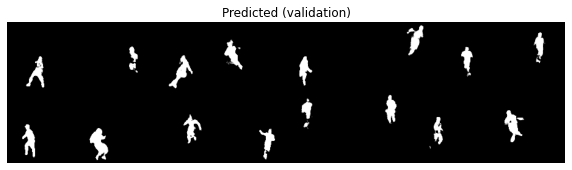

Average Validation loss: 0.0368393133722071	 Average Metric: 0.7410735990574111
--- 1410.5671436786652 seconds ---


In [35]:
start_time = time.time()
trainer.run_model(model, train_loader, valid_loader, criterion, metric,  lr=0.001, epochs=1)
print("--- %s seconds ---" % (time.time() - start_time))

In [0]:
from model.data_loader2 import getdata
from model.network_architecture2 import Net

In [0]:
data = next(iter(train_loader))

In [0]:
data['i1'] = data['i1'].to('cuda')
data['i2'] = data['i2'].to('cuda')

In [0]:
model.eval()
torch.no_grad()
mask, depth = model(data['i1'], data['i2'])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


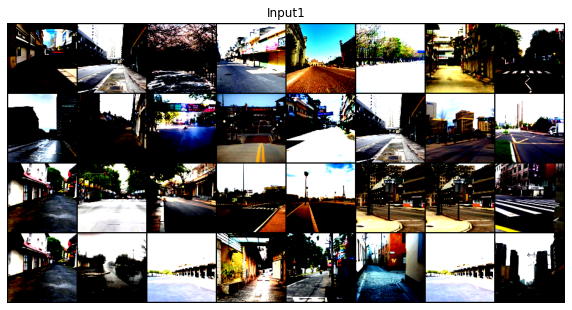

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


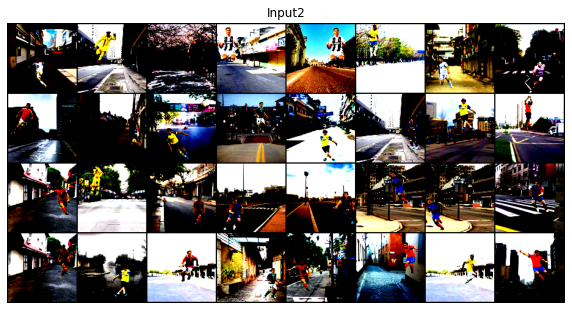

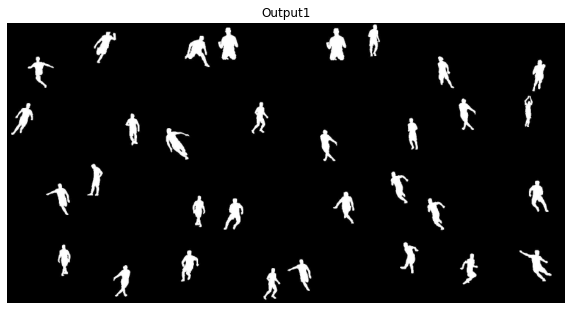

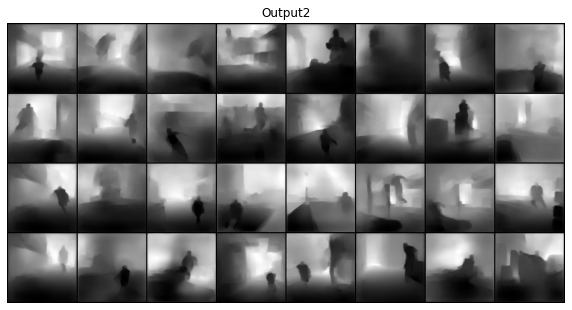

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


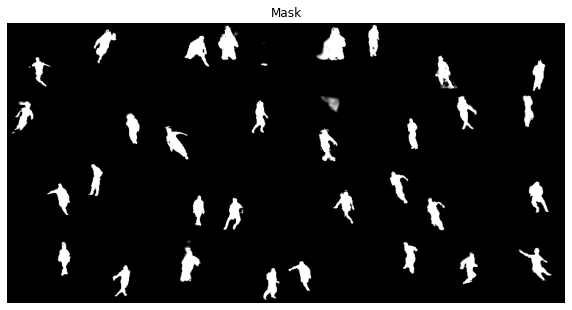

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


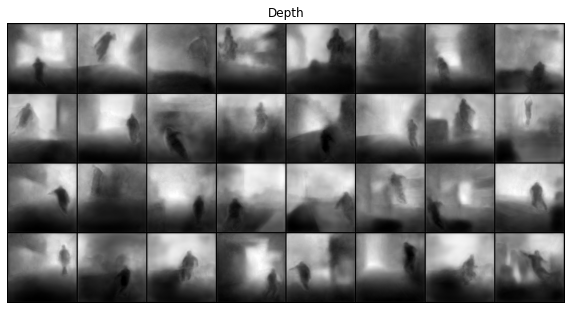

In [18]:
show_image(data['i1'][::4], 8, 'Input1')
show_image(data['i2'][::4], 8, 'Input2')
show_image(data['o1'][::4], 8, 'Output1')
show_image(data['o2'][::4], 8, 'Output2')
show_image(mask[::4], 8, 'Mask')
show_image(depth[::4], 8, 'Depth')

## Evaluation

In [0]:
from losses import RMSE
import segmentation_models_pytorch as smp
from evaluate import evaluate_model

In [0]:
criterion_mask = nn.BCEWithLogitsLoss()
criterion_depth = nn.L1Loss()

In [0]:
metric_mask = metric = smp.utils.metrics.IoU(threshold=0.5)
metric_depth = RMSE()

In [22]:
model.load_state_dict(torch.load('/content/drive/My Drive/model_final.pth'))

<All keys matched successfully>

In [0]:
evaluator = evaluate_model(device)

Evaluating validation set...
Evaluating.....
Some target vs predicted samples:


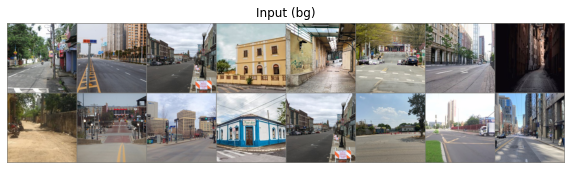

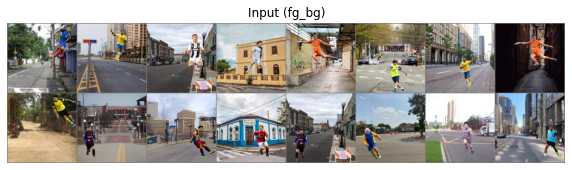

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


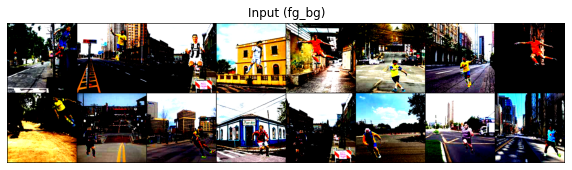

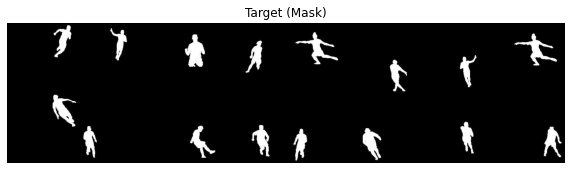

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


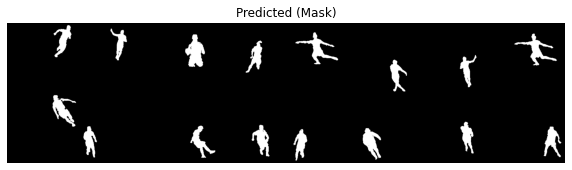

Mask: Average Evaluation loss: 0.010681990206241608	 Average Metric: 0.9368288125356038


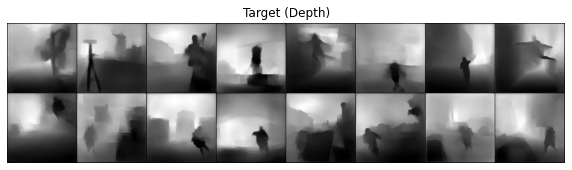

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


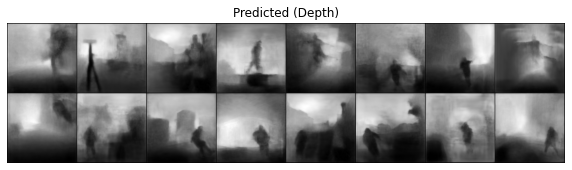

Depth: Average Evaluation loss: 0.059557682756582894	 Average Metric: 0.8616455005009969
--- 1027.9876823425293 seconds ---


In [17]:
print("Evaluating validation set...")
start_time = time.time()
evaluator.run(model, valid_loader, criterion_mask, criterion_depth, metric_mask, metric_depth)
print("--- %s seconds ---" % (time.time() - start_time))

Evaluating training set...
Evaluating.....
Some target vs predicted samples:


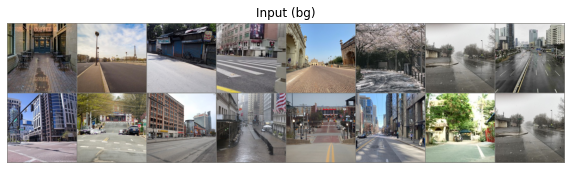

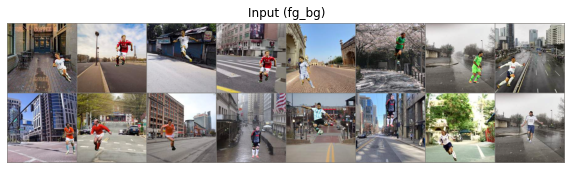

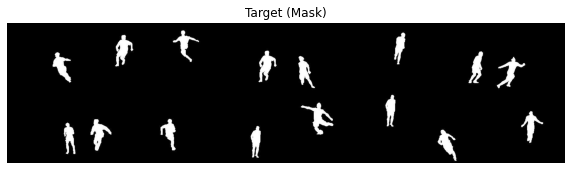

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


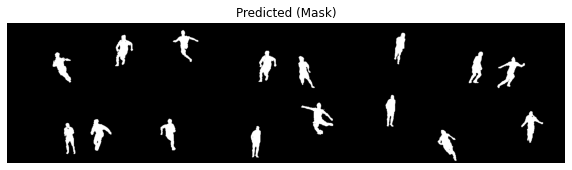

Mask: Average Evaluation loss: 0.010674233464258057	 Average Metric: 0.9369297547612871


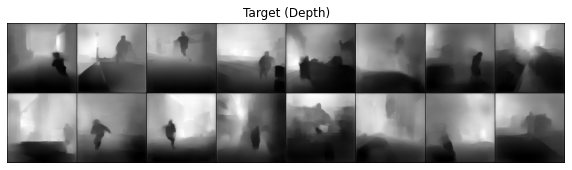

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


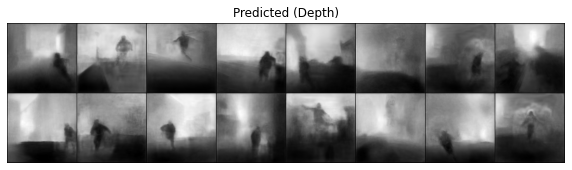

Depth: Average Evaluation loss: 0.059262531594719205	 Average Metric: 0.8572478894369943
--- 2404.473710298538 seconds ---


In [20]:
print("Evaluating training set...")
start_time = time.time()
evaluator.run(model, train_loader, criterion_mask, criterion_depth, metric_mask, metric_depth)
print("--- %s seconds ---" % (time.time() - start_time))

##Data Loading Time Estimation

In [0]:
t_sum = []
last_time = time.time()
for i, data in enumerate(train_loader):
    t = time.time()
    t_diff = t - last_time
    t_sum.append(t_diff)
    last_time = t
    if i ==549:
        break

In [0]:
import pandas as pd
series = pd.Series(t_sum) 
t_sum1 = series.cumsum() 

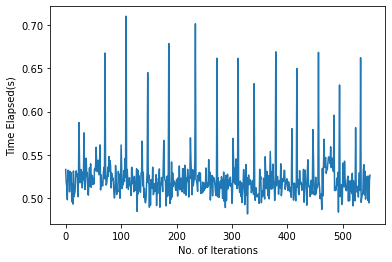

In [0]:
import matplotlib.pyplot as plt
plt.plot(t_sum)
plt.ylabel("Time Elapsed(s)")
plt.xlabel("No. of Iterations")
plt.show()

In [0]:
for param_tensor in model.state_dict():
    print(param_tensor, "\t", model.state_dict()[param_tensor].size())